# TP INTEGRADOR Series Temporales 

* Descripción de las observaciones.
* Descomposición.
* Estacionariedad y estacionalidad (periodograma).
* Tendencia determinística: lineal y cíclica.
* Preprocesamiento: box-cox y diferenciación.
* SARIMA: comparación de modelos ajustados y predicción.

By Anahi Bazet

## Librerías

In [714]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
import statsmodels.api as sm
from pylab import rcParams
from scipy.optimize import curve_fit
from statsmodels.tsa.stattools import kpss,adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, plot_predict
from sklearn.preprocessing import PowerTransformer
from scipy import stats
from statsmodels.tsa.arima.model import ARIMA
from scipy import signal
from scipy.special import inv_boxcox

## Exploración de los datos y elección de la serie

Se utilizará el siguiente dataset: https://www.kaggle.com/datasets/fedesoriano/traffic-prediction-dataset

In [715]:
# Montar el Google Drive.
# from google.colab import drive
# drive.mount('/content/drive')

In [716]:
#Leer el dataset.
# dataset=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/Series/TP INTEGRADOR/traffic.csv")
dataset=pd.read_csv("traffic.csv")

In [717]:
#Verificar lectura.
dataset.head(10)

,DateTime,Junction,Vehicles,ID
0,2015-11-01 00:00:00,1,15,20151101001
1,2015-11-01 01:00:00,1,13,20151101011
2,2015-11-01 02:00:00,1,10,20151101021
3,2015-11-01 03:00:00,1,7,20151101031
4,2015-11-01 04:00:00,1,9,20151101041
5,2015-11-01 05:00:00,1,6,20151101051
6,2015-11-01 06:00:00,1,9,20151101061
7,2015-11-01 07:00:00,1,8,20151101071
8,2015-11-01 08:00:00,1,11,20151101081
9,2015-11-01 09:00:00,1,12,20151101091


In [718]:
#Obtener cantidad de muestras y tipos de datos.
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48120 entries, 0 to 48119
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   DateTime  48120 non-null  object
 1   Junction  48120 non-null  int64 
 2   Vehicles  48120 non-null  int64 
 3   ID        48120 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 1.5+ MB


In [719]:
#Cambiar el tipo de dato de la fecha/hora de objeto a datetime.
pd.set_option('mode.chained_assignment',None)
#NOTA: esto es para evitar un warning de Pandas: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
dataset["DateTime"]=pd.to_datetime(dataset["DateTime"], format='%Y-%m-%d %H:%M:%S')

In [720]:
#Chequear el cambio.
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48120 entries, 0 to 48119
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   DateTime  48120 non-null  datetime64[ns]
 1   Junction  48120 non-null  int64         
 2   Vehicles  48120 non-null  int64         
 3   ID        48120 non-null  int64         
dtypes: datetime64[ns](1), int64(3)
memory usage: 1.5 MB


In [721]:
# Contar cuantas muestras hay por intersección.
result_count_Junction=dataset.groupby(['Junction']).Junction.count()
result_count_Junction

Junction
1    14592
2    14592
3    14592
4     4344
Name: Junction, dtype: int64

In [722]:
#Elegir una unión y seleccionar las columnas útiles (DateTime y Vehicles)
dataset_Junction1=dataset[dataset['Junction']==1]
dataset_Junction1=dataset_Junction1.drop(columns=['Junction','ID'])

In [723]:
#Ordenar las muestras por fecha/hora en orden ascendente.
dataset_Junction1=dataset_Junction1.sort_values(["DateTime"],ascending=True)

In [724]:
#Lectura del dataset depurado.
dataset_Junction1.head(10)

,DateTime,Vehicles
0,2015-11-01 00:00:00,15
1,2015-11-01 01:00:00,13
2,2015-11-01 02:00:00,10
3,2015-11-01 03:00:00,7
4,2015-11-01 04:00:00,9
5,2015-11-01 05:00:00,6
6,2015-11-01 06:00:00,9
7,2015-11-01 07:00:00,8
8,2015-11-01 08:00:00,11
9,2015-11-01 09:00:00,12


### Observaciones

Se descarta la intersección 4, porque es la de menor cantidad de muestras. No hay una razón específica por la cual se elija la intersección 1, ya que la dicha intersección, la 2 y 3 tienen la misma cantidad de datos.

## Grafico y descripción de la serie de tiempo

### Análisis de todos los datos (casi dos años), observando el comportamiento general

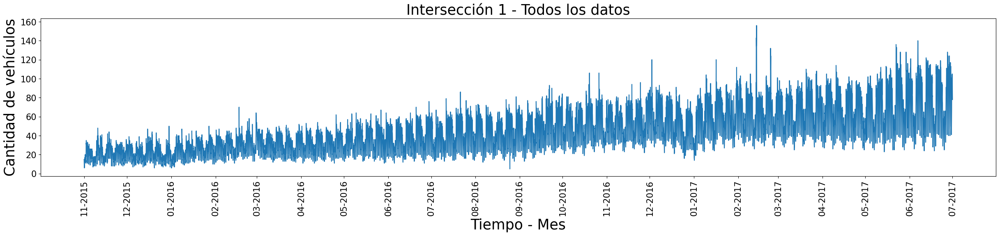

In [725]:
#Graficar todos los datos.
fig=plt.figure(figsize=(30,5))
plt.plot(dataset_Junction1['DateTime'],dataset_Junction1['Vehicles'])
ax = plt.gca()
# Se determina el intervalo entre fechas del eje x.
ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
# Se establece el formato de la fecha en el eje x.
ax.xaxis.set_major_formatter(mdates.DateFormatter('%m-%Y'))
plt.title("Intersección 1 - Todos los datos")
plt.xlabel("Tiempo - Mes")
plt.xticks(rotation=90)
plt.ylabel("Cantidad de vehículos")
plt.show()

In [726]:
#Agregar una descripción de la cantidad de vehículos.
dataset_Junction1.describe()

,Vehicles
count,14592.000000
mean,45.052906
std,23.008345
min,5.000000
25%,27.000000
50%,40.000000
75%,59.000000
max,156.000000


In [727]:
#Agregar una descripción de fechas.
fechas_description = dataset_Junction1.agg(min=('DateTime', np.min), max=('DateTime', np.max))
fechas_description

,DateTime
min,2015-11-01 00:00:00
max,2017-06-30 23:00:00


Se muestran la cantidad de vehículos por hora en la intersección 1 desde el 01-11-2015 al 30-06-2017.

Se puede observar que existe un comportamiento cíclico que se analizará más adelante en detalle.

A medida que aumenta el tiempo, también lo hace la cantidad de vehículos. Por lo tanto, se puede decir que el tráfico tiene un comportamiento creciente. De hecho, van aumentando tanto los puntos mínimos, cómo los picos de tránsito, y la diferencia entre ambos también es más amplia.

### Análisis de un año, observando el comportamiento semanal en cada mes

In [728]:
dataset_Junction1_year=dataset_Junction1[dataset_Junction1['DateTime']<'2016-11-01 00:00:00']
dataset_Junction1_year

,DateTime,Vehicles
0,2015-11-01 00:00:00,15
1,2015-11-01 01:00:00,13
2,2015-11-01 02:00:00,10
3,2015-11-01 03:00:00,7
4,2015-11-01 04:00:00,9
...,...,...
8779,2016-10-31 19:00:00,77
8780,2016-10-31 20:00:00,72
8781,2016-10-31 21:00:00,75
8782,2016-10-31 22:00:00,63


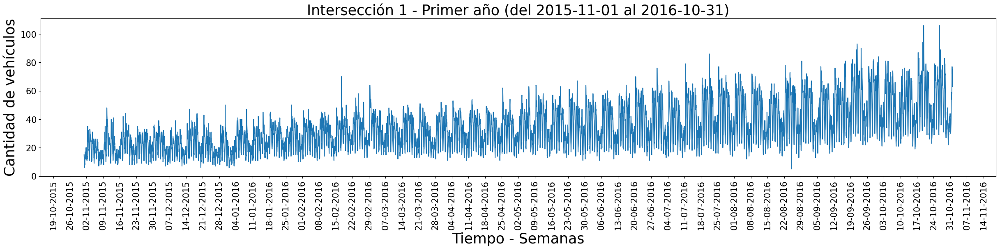

In [729]:
#Graficar un año.
fig=plt.figure(figsize=(30,5))
plt.plot(dataset_Junction1_year['DateTime'],dataset_Junction1_year['Vehicles'])
ax = plt.gca()
# Se determina el intervalo entre fechas del eje x.
ax.xaxis.set_major_locator(mdates.DayLocator(interval=7))
# Se establece el formato de la fecha en el eje x.
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%Y'))
plt.title("Intersección 1 - Primer año (del 2015-11-01 al 2016-10-31)")
plt.xlabel("Tiempo - Semanas")
plt.xticks(rotation=90)
plt.ylabel("Cantidad de vehículos")
plt.show()

In [730]:
#Agregar una descripción de la cantidad de vehículos.
dataset_Junction1_year.describe()

,Vehicles
count,8784.000000
mean,33.889686
std,15.558809
min,5.000000
25%,22.000000
50%,31.000000
75%,43.000000
max,106.000000


En este gráfico en particular, en donde observamos el año desde del 2015-10-31 al 2016-11-01, no se puede sacar ninguna conclusión en particular, si queremos analizar las semanas.

### Análisis de un mes, observando el comportamiento diario en cada semana

In [731]:
dataset_Junction1_month=dataset_Junction1[dataset_Junction1['DateTime']<'2015-12-01 00:00:00']
dataset_Junction1_month

,DateTime,Vehicles
0,2015-11-01 00:00:00,15
1,2015-11-01 01:00:00,13
2,2015-11-01 02:00:00,10
3,2015-11-01 03:00:00,7
4,2015-11-01 04:00:00,9
...,...,...
715,2015-11-30 19:00:00,29
716,2015-11-30 20:00:00,31
717,2015-11-30 21:00:00,29
718,2015-11-30 22:00:00,26


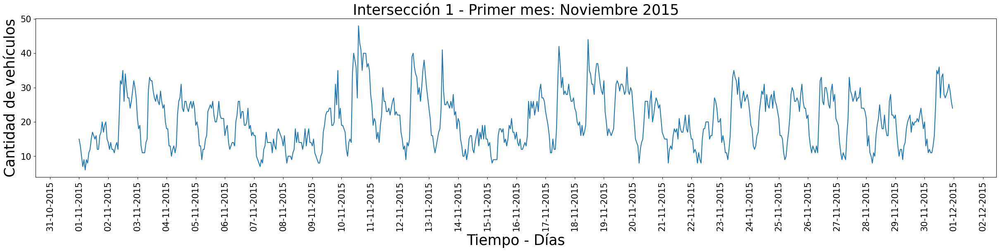

In [732]:
#Graficar un mes.
fig=plt.figure(figsize=(30,5))
plt.plot(dataset_Junction1_month['DateTime'],dataset_Junction1_month['Vehicles'])
ax = plt.gca()
# Se determina el intervalo entre fechas del eje x.
ax.xaxis.set_major_locator(mdates.DayLocator(interval=1))
# Se establece el formato de la fecha en el eje x.
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%Y'))
plt.title("Intersección 1 - Primer mes: Noviembre 2015")
plt.xlabel("Tiempo - Días")
plt.xticks(rotation=90)
plt.ylabel("Cantidad de vehículos")
plt.show()

In [733]:
#Agregar una descripción.
dataset_Junction1_month.describe()

,Vehicles
count,720.000000
mean,20.466667
std,7.636491
min,6.000000
25%,14.000000
50%,20.000000
75%,26.000000
max,48.000000


Si analizamos un mes, en este caso noviembre de 2015, se puede observar que el comportamiento es cíclico por día, hay un valle y una meseta alta con varios picos consecutivos. Esto se continuará analizando en el gráfico posterior por hora. 

Por otro lado, los días domingos (por ejemplo el 01/11/2015) y los días sábados (07/11/2015 por ejemplo), el tráfico es mucho menor que de lunes a viernes. Esto determina un comportamiento cíclico por semana.

### Análisis de una semana, observando el comportamiento por hora en cada día

In [734]:
dataset_Junction1_week=dataset_Junction1_month[dataset_Junction1_month['DateTime']<'2015-11-08 00:00:00']
dataset_Junction1_week

,DateTime,Vehicles
0,2015-11-01 00:00:00,15
1,2015-11-01 01:00:00,13
2,2015-11-01 02:00:00,10
3,2015-11-01 03:00:00,7
4,2015-11-01 04:00:00,9
...,...,...
163,2015-11-07 19:00:00,17
164,2015-11-07 20:00:00,18
165,2015-11-07 21:00:00,17
166,2015-11-07 22:00:00,16


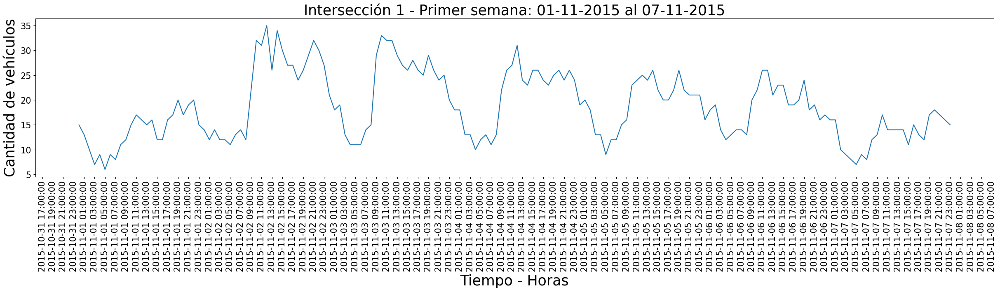

In [735]:
#Graficar una semana.
fig=plt.figure(figsize=(30,5))
plt.plot(dataset_Junction1_week['DateTime'],dataset_Junction1_week['Vehicles'])
ax = plt.gca()
# Se determina el intervalo entre fechas del eje x.
ax.xaxis.set_major_locator(mdates.HourLocator(interval=2))
# Se establece el formato de la fecha en el eje x.
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M:%S'))
plt.title("Intersección 1 - Primer semana: 01-11-2015 al 07-11-2015")
plt.xlabel("Tiempo - Horas")
plt.xticks(rotation=90)
plt.ylabel("Cantidad de vehículos")
plt.show()

In [736]:
#Agregar una descripción.
dataset_Junction1_week.describe()

,Vehicles
count,168.000000
mean,18.690476
std,6.710393
min,6.000000
25%,13.000000
50%,18.000000
75%,24.000000
max,35.000000


Si analizamos una semana, en este caso del 01-11-2015 al 07-11-2015, como se mencionó anteriormente, el comportamiento es cíclico por día, independientemente del día de la semana. Alrededor de las 05:00 hs. es el momento de menor tráfico. Luego, comienza a subir, y lo hace pronunciadamente a las 09 hs. para realizar su primer pico a las 11:00 hs. En ese punto se produce una especie de meseta con varios picos, en donde a las 19 hs. hace su último pico. La meseta finaliza alrededor de las 23:00 hs. en donde comienza el descenso menos pronunciado hasta las 05:00 hs. del siguiente día.

Podemos concluir que entre las 01:00 y las 09:00 hs. es el horario de menor tráfico, mientras que entre las 09:00 y las 01:00 hs es el de mayor tráfico.

## Descomposición

In [737]:
#sm.tsa.seasonal_decompose solicita que el campo de tiempo sea un índice (caso contrario, arroja error).
dataset_Junction1 = dataset_Junction1.set_index('DateTime')
dataset_Junction1

,Vehicles
DateTime,
2015-11-01 00:00:00,15
2015-11-01 01:00:00,13
2015-11-01 02:00:00,10
2015-11-01 03:00:00,7
2015-11-01 04:00:00,9
...,...
2017-06-30 19:00:00,105
2017-06-30 20:00:00,96
2017-06-30 21:00:00,90


### Período de 24 hs. (1 día) - Aditivo vs. multiplicativo

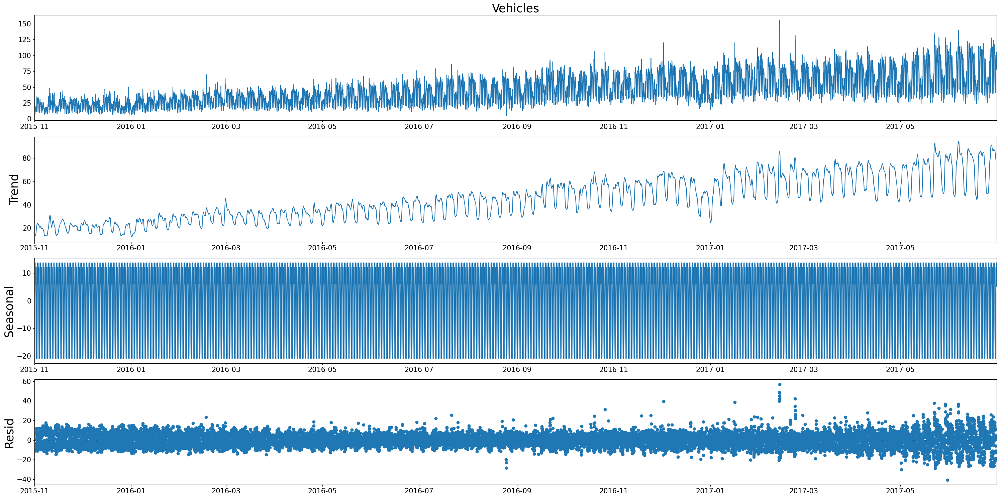

In [738]:
#Aditiva indicando el período.
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15}
plt.rcParams.update(parameters)
decomposition_add_day = sm.tsa.seasonal_decompose(dataset_Junction1['Vehicles'], model='additive',period=24)
#24 horas/día.
decomposition_add_day.plot()
plt.show()

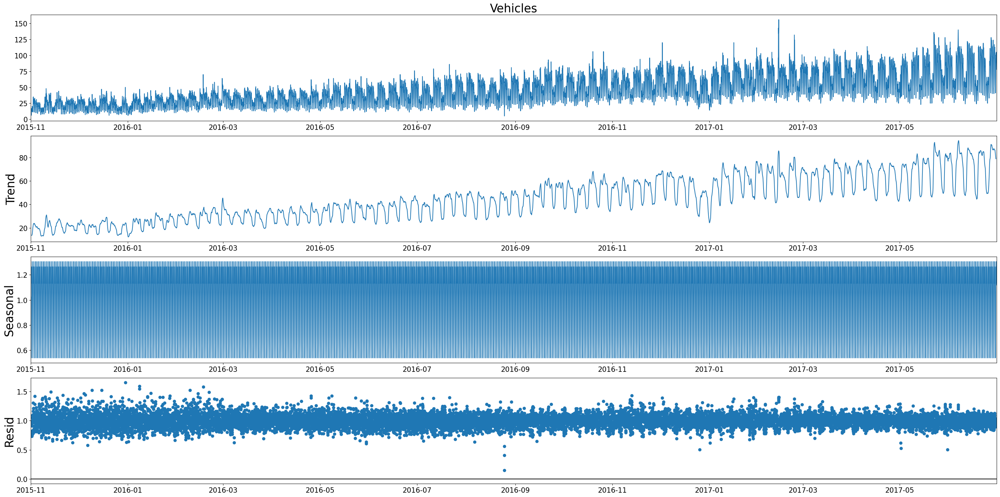

In [739]:
#Multiplicativa indicando el período.
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15}
plt.rcParams.update(parameters)
decomposition_mul_day = sm.tsa.seasonal_decompose(dataset_Junction1['Vehicles'], model='multiplicative',period=24)
#24 horas/día.
decomposition_mul_day.plot()
plt.show()

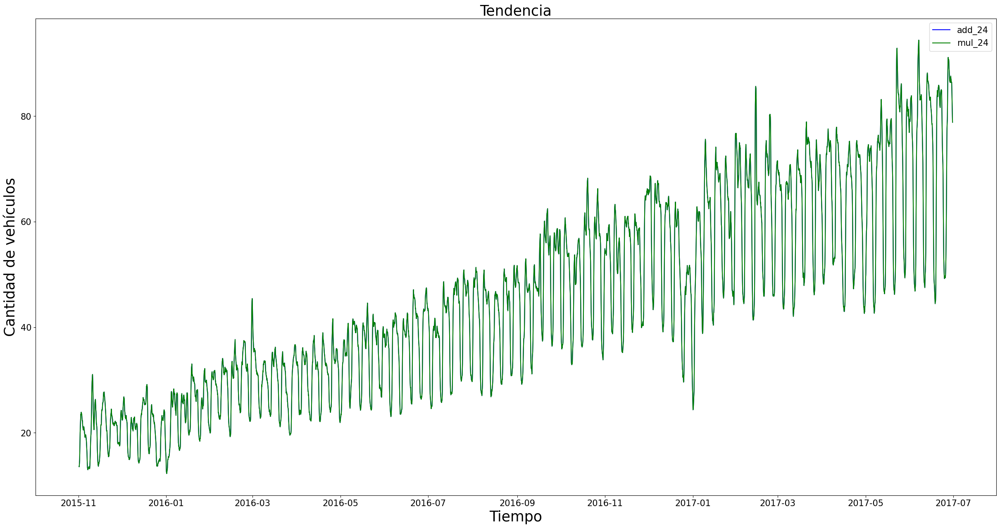

In [740]:
#Comparación de la tendencias.
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15,
              'legend.fontsize': 15}
plt.rcParams.update(parameters)
plt.plot(decomposition_add_day.trend, color="blue",label='add_24')
plt.plot(decomposition_mul_day.trend, color="green",label='mul_24')
plt.title("Tendencia")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

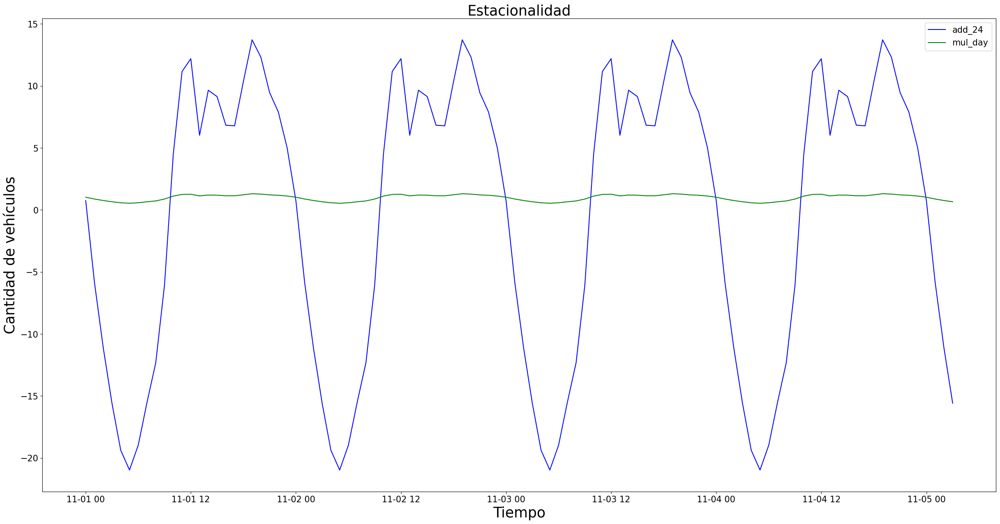

In [741]:
#Comparación de la estacionalidad (primeras 100 muestras)
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15,
              'legend.fontsize': 15}
plt.rcParams.update(parameters)
plt.plot(decomposition_add_day.seasonal[0:100], color="blue",label='add_24')
plt.plot(decomposition_mul_day.seasonal[0:100], color="green",label='mul_day')
plt.title("Estacionalidad")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

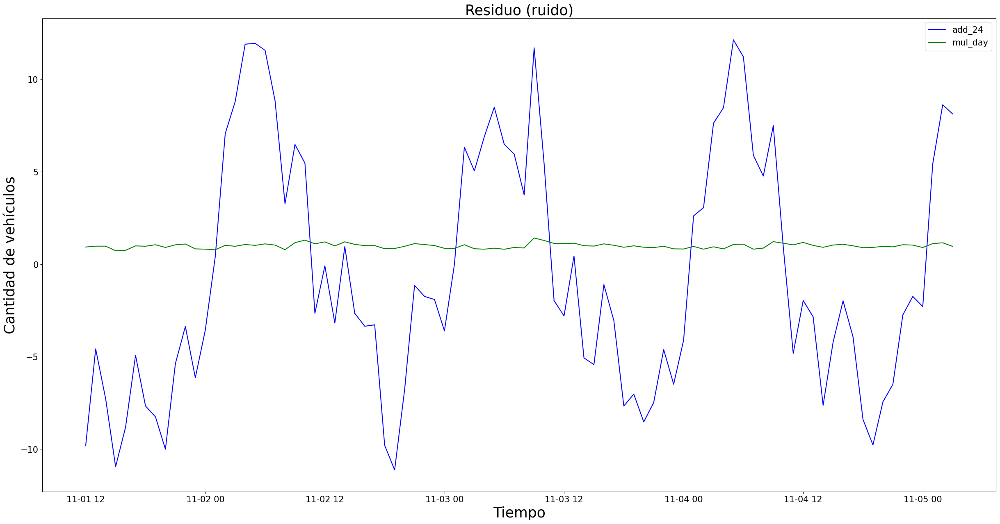

In [742]:
#Comparación del ruido (primeras 100 muestras)
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15,
              'legend.fontsize': 15}
plt.rcParams.update(parameters)
plt.plot(decomposition_add_day.resid[0:100], color="blue",label='add_24')
plt.plot(decomposition_mul_day.resid[0:100], color="green",label='mul_day')
plt.title("Residuo (ruido)")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Conclusiones

La tendencia no cambia utilizando aditiva o multiplicativa, pero sí lo hace la estacionalidad, y en consecuencia, el ruido. En estos dos últimos casos, los picos están mucho más marcados cuando se utiliza adición. Por este motivo, se utilizará adición.

### Período de 168 hs. (1 semana) vs 24 hs. (1 día)

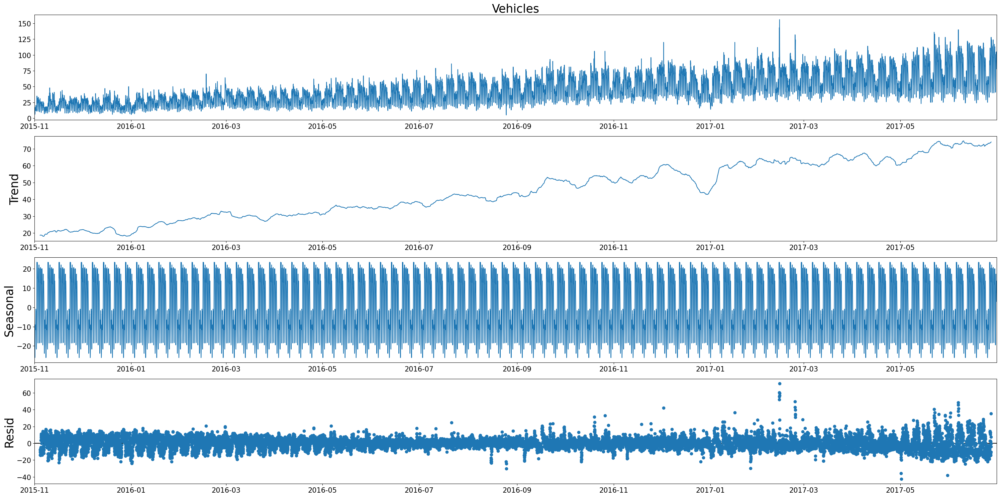

In [743]:
#Aditiva indicando el período.
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15}
plt.rcParams.update(parameters)
decomposition_add_week = sm.tsa.seasonal_decompose(dataset_Junction1['Vehicles'], model='additive',period=168)
#24 horas/día * 7 días de la semana = 168 horas
decomposition_add_week.plot()
plt.show()

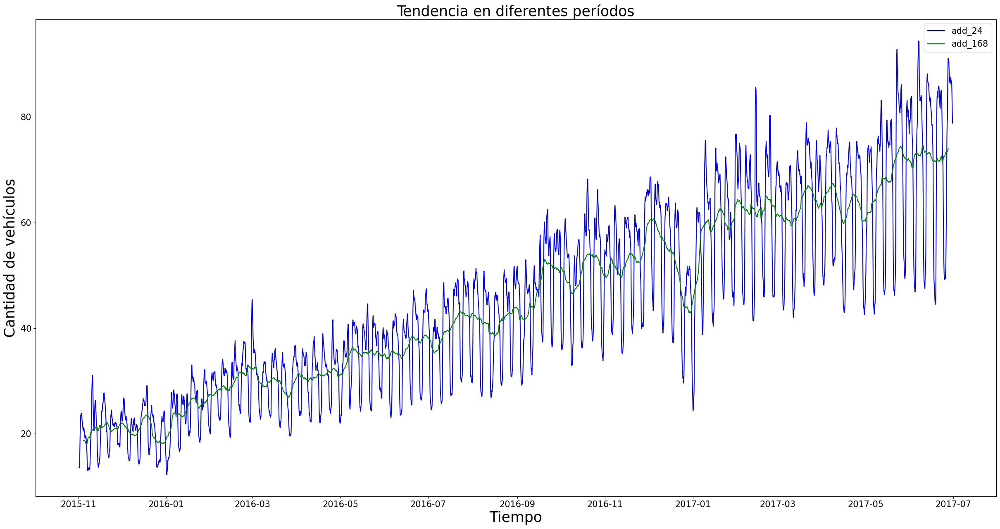

In [744]:
#Comparación de la tendencia para diferentes períodos.
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15,
              'legend.fontsize': 15}
plt.rcParams.update(parameters)
plt.plot(decomposition_add_day.trend, color="blue",label='add_24')
plt.plot(decomposition_add_week.trend, color="green",label='add_168')
plt.title("Tendencia en diferentes períodos")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

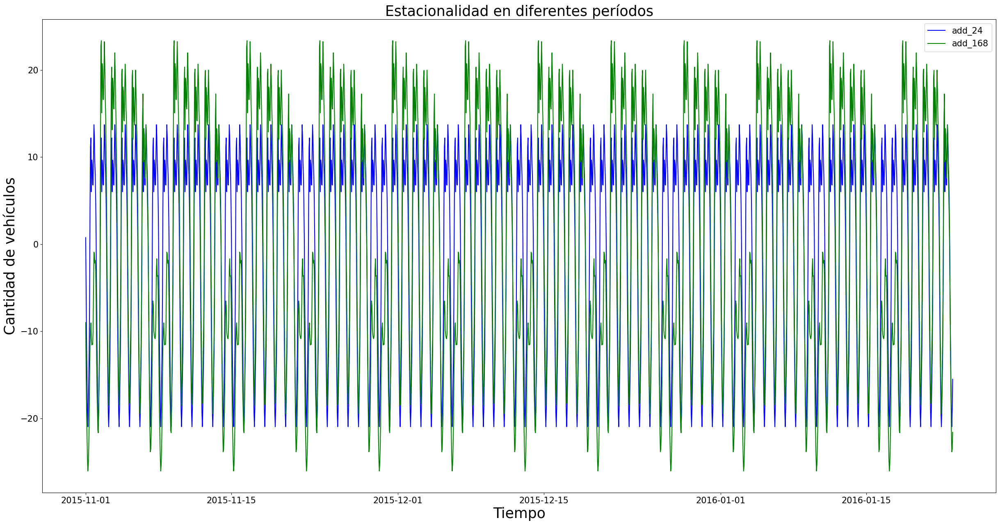

In [745]:
#Comparación de la estacionalidad (primeras 2000 muestras) para diferentes períodos.
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15,
              'legend.fontsize': 15}
plt.rcParams.update(parameters)
plt.plot(decomposition_add_day.seasonal[0:2000], color="blue",label='add_24')
plt.plot(decomposition_add_week.seasonal[0:2000], color="green",label='add_168')
plt.title("Estacionalidad en diferentes períodos")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

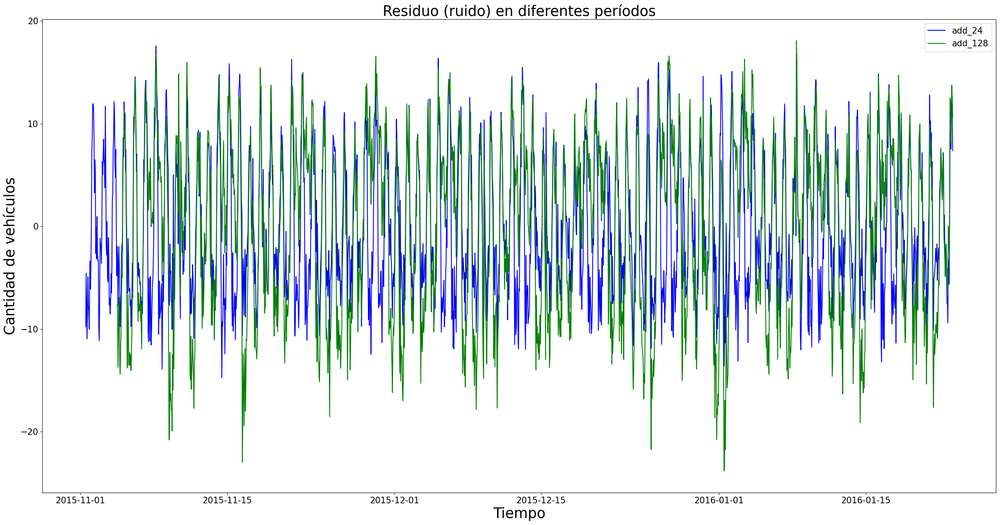

In [746]:
#Comparación del ruido (primeras 2000 muestras) para diferentes períodos.
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15,
              'legend.fontsize': 15}
plt.rcParams.update(parameters)
plt.plot(decomposition_add_day.resid[0:2000], color="blue",label='add_24')
plt.plot(decomposition_add_week.resid[0:2000], color="green",label='add_128')
plt.title("Residuo (ruido) en diferentes períodos")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Conclusiones

Comparando el gráfico de 24 hs. con el de 168 hs. de estacionalidad, se observa como el de 24 horas presenta un comportamiento cíclico e igual por día, mientras que el de 168 hs., muestra que por día hay menor tránsito los fines de semana (sábado y domingo), pero además, se aprecia algo que no se había notado en la sección anterior: en los días hábiles el tránsito decae de lunes a viernes.

En cuanto al gráfico de tendencia, ambos tienen un comportamiento creciente a lo largo del tiempo. Es decir, muestran una tendencia lineal creciente. Por lo tanto, la media no es constante a través del tiempo. Por otro lado, en el gráfico de 24 hs. se ve que la varianza aumenta a medida que aumenta el tiempo, es decir existe un tráfico mayor al pasar el tiempo, mientras que en el gráfico de 168 hs. esta variación no es tan marcada, aunque también existe.

Todos estos puntos se analizarán con más detalle en la próxima sección.

## Test para definir estacionariedad

#### Test Dickey-Fuller

In [747]:
def adf_test(timeseries):
    print("Resultados del test de Dickey-Fuller:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
        dftest[0:4],
        index=["Estadístico",
            "p-valor",
            "# Lags usados",
            "# Observaciones usadas",
        ],
    )
    for key, value in dftest[4].items():
        dfoutput["Valor del umbral (%s)" % key] = value
    print(dfoutput)

#### Test KPSS

In [748]:
def kpss_test(timeseries):
    print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags="auto")
    kpss_output = pd.Series(
        kpsstest[0:3], index=["Estadístico", "p-valor", "Lags usados"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Valor del umbrarl (%s)" % key] = value
    print(kpss_output)

## Serie original - Estacionariedad y estacionalidad

Se analiza la estacionariedad y estacionalidad de la serie original.


#### Autocorrelación

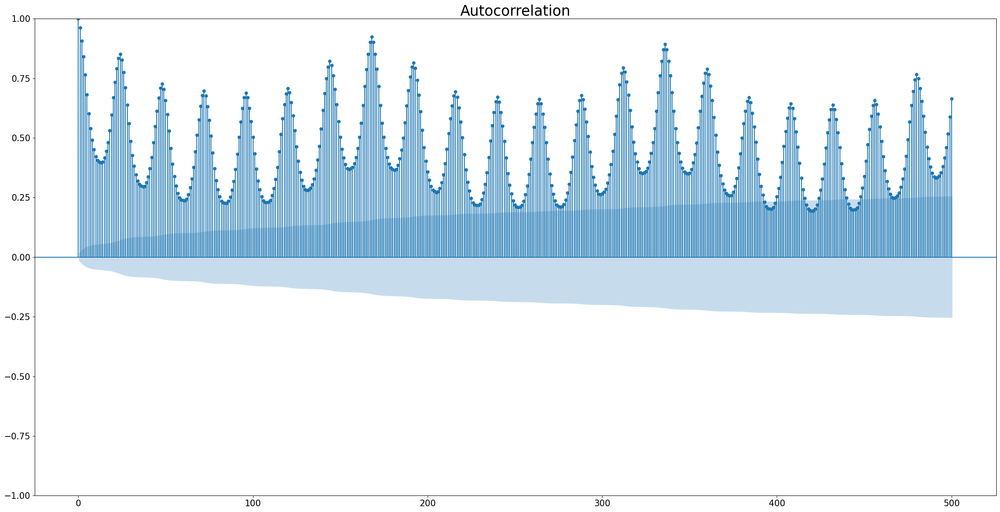

In [749]:
plot_acf(dataset_Junction1['Vehicles'], lags=500)
plt.show()

##### Análisis del resultado

No cae exponencialmente. Además tiene ciclos: diario y semanal. Por lo tanto, se sospecha que NO es estacionaria.

No puedo calcular el orden del modelo MA.

#### Autocorrelación parcial

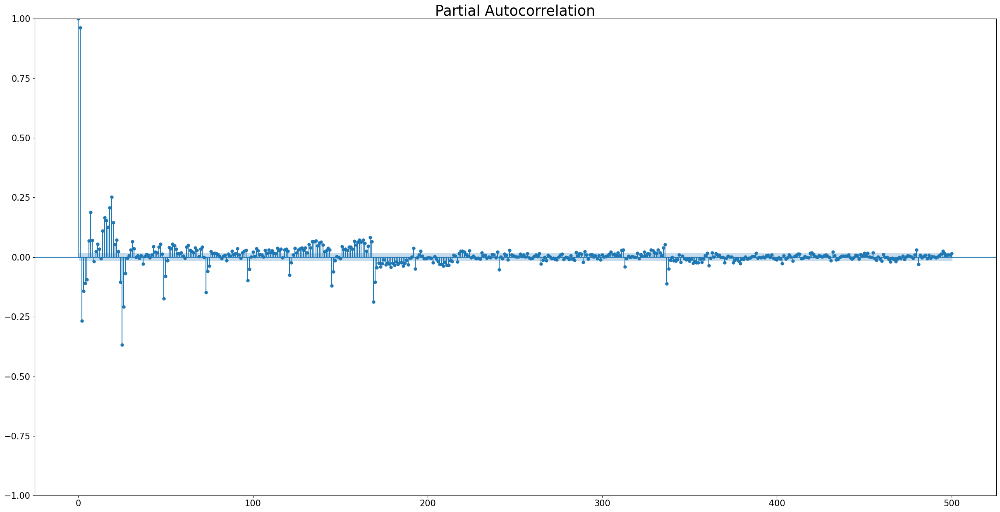

In [750]:
plot_pacf(dataset_Junction1['Vehicles'],lags=500, method='ywm')
plt.show()

##### Análisis del resultado

No puedo calcular el orden del modelo AR.

#### Test Dickey-Fuller

In [751]:
adf_test(dataset_Junction1['Vehicles'])

Resultados del test de Dickey-Fuller:
Estadístico              -7.148078e+00
p-valor                   3.193843e-10
# Lags usados             4.200000e+01
# Observaciones usadas    1.454900e+04
Valor del umbral (1%)    -3.430800e+00
Valor del umbral (5%)    -2.861739e+00
Valor del umbral (10%)   -2.566876e+00
dtype: float64


##### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA. Ahora bien, se sospecha que la que es estacionaria es la serie diferenciada, ya que la serie original no tiene pinta de ser estacionaria.

#### Test KPSS

In [752]:
kpsstest = kpss_test(dataset_Junction1['Vehicles'])

Results of KPSS Test:
Estadístico                 18.747673
p-valor                      0.010000
Lags usados                 66.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


##### Análisis del resultado

El estadístico es mayor al umbral en los 4 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es NO ESTACIONARIA.
Esto estaría confirmando que la serie original es no estacionaria.

#### Análisis espectral: periodograma

Se utilizan diferentes muestreos: anual, mensual y semanal para poder comparar resultados.

##### Anual

En este caso, se muestrean 8064 horas, es decir, 24 horas/día * 28 días/mes * 12 meses = 8064 horas.

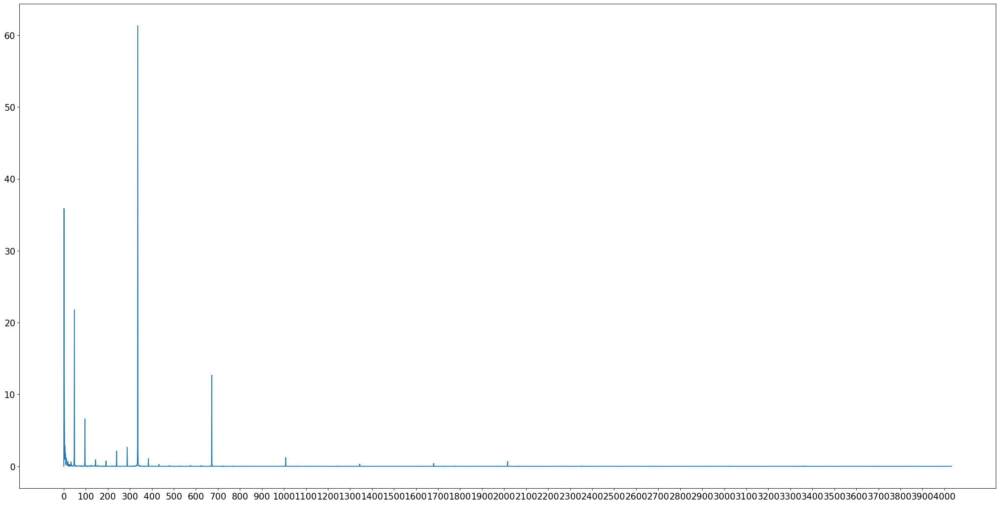

In [753]:
F, P_den = signal.periodogram(dataset_Junction1['Vehicles'][0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F, P_den)
plt.xticks(np.arange(0, len(F), step=100))
plt.show()

Se realiza un zoom...

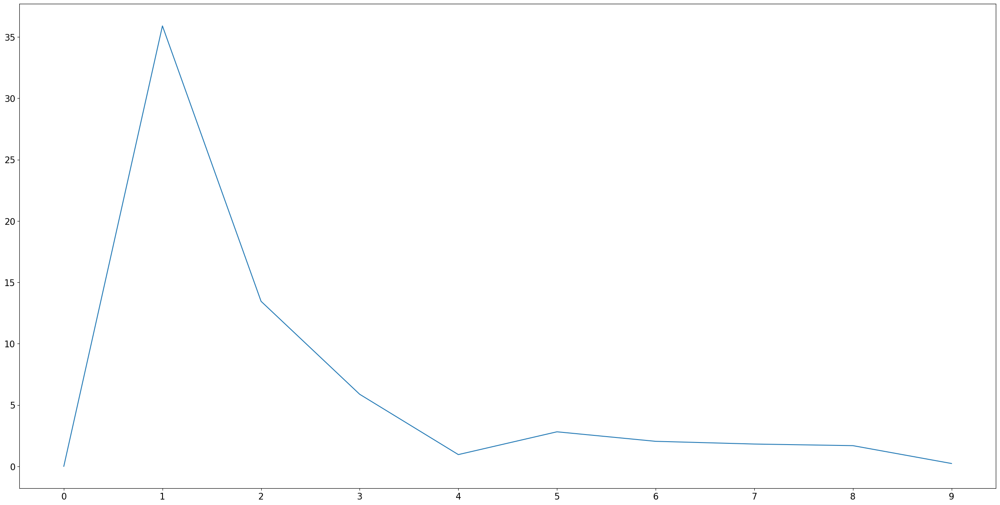

In [754]:
F, P_den = signal.periodogram(dataset_Junction1['Vehicles'][0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[0:10], P_den[0:10])
plt.xticks(np.arange(0, 10, step=1))
plt.show()

Un segundo zoom...

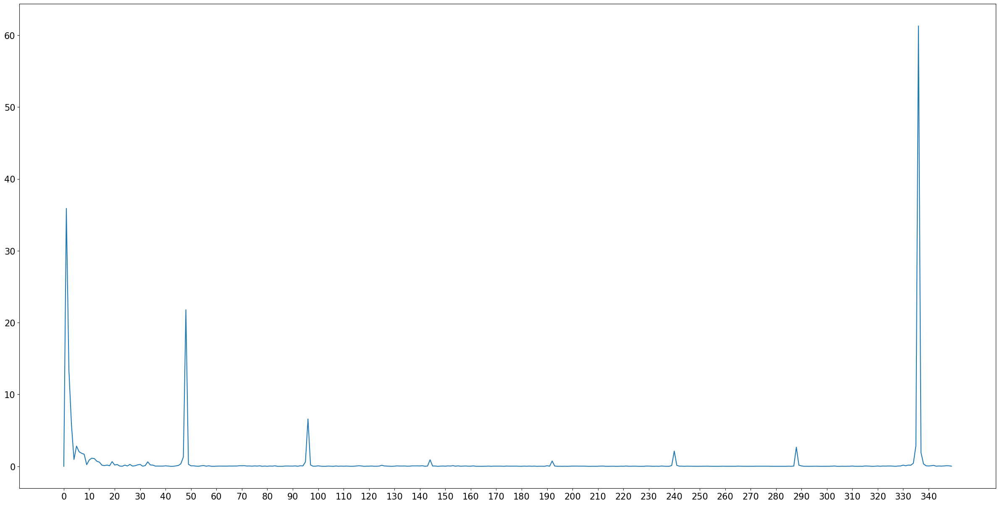

In [755]:
F, P_den = signal.periodogram(dataset_Junction1['Vehicles'][0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[0:350], P_den[0:350])
plt.xticks(np.arange(0, 350, step=10))
plt.show()

Y un tercer zoom...

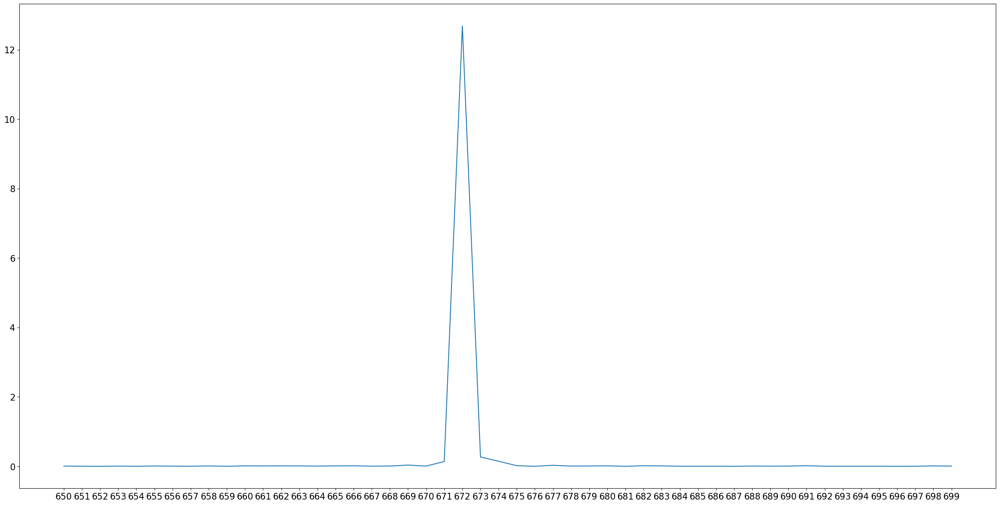

In [756]:
F, P_den = signal.periodogram(dataset_Junction1['Vehicles'][0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[650:700], P_den[650:700])
plt.xticks(np.arange(650, 700, step=1))
plt.show()

Las 5 frecuencias más altas, desde la de mayor intensidad a la de menor intensidad, son:

1- Hay una frecuencia en 336 -> 8064(n)/336(f)=24(T). El período es de 24 horas (1 día).

2- Hay una frecuencia en 1 -> 8064(n)/1(f)=8064(T). El período es de 8064 horas (1 año).

3- Hay una frecuencia en 48 -> 8064(n)/48(f)=168(T). El período es de 168 horas (1 semana). 

4- Hay una frecuencia en 2 -> 8064(n)/2(f)=4032(T). El período es de 4032 horas (1/2 año).

5- Hay una frecuencia en 672 -> 8064(n)/672(f)=12(T). El período es de 12 horas (1/2 día). 


##### Mensual

En este caso, se muestrean 672 horas, es decir, 24 horas/día * 28 días = 672 horas.

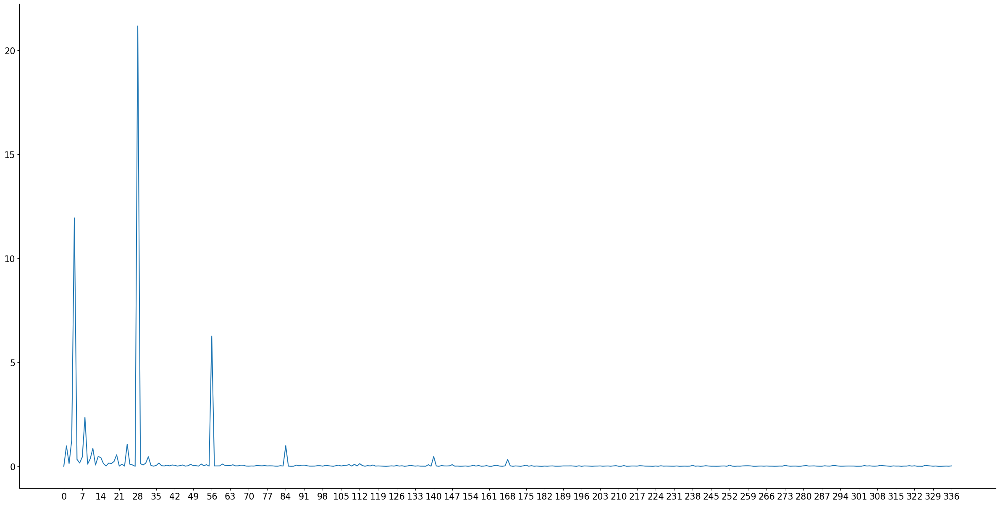

In [757]:
F, P_den = signal.periodogram(dataset_Junction1['Vehicles'][0:672],672)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F, P_den)
plt.xticks(np.arange(0, len(F), step=7))
plt.show()

Se realiza un zoom...

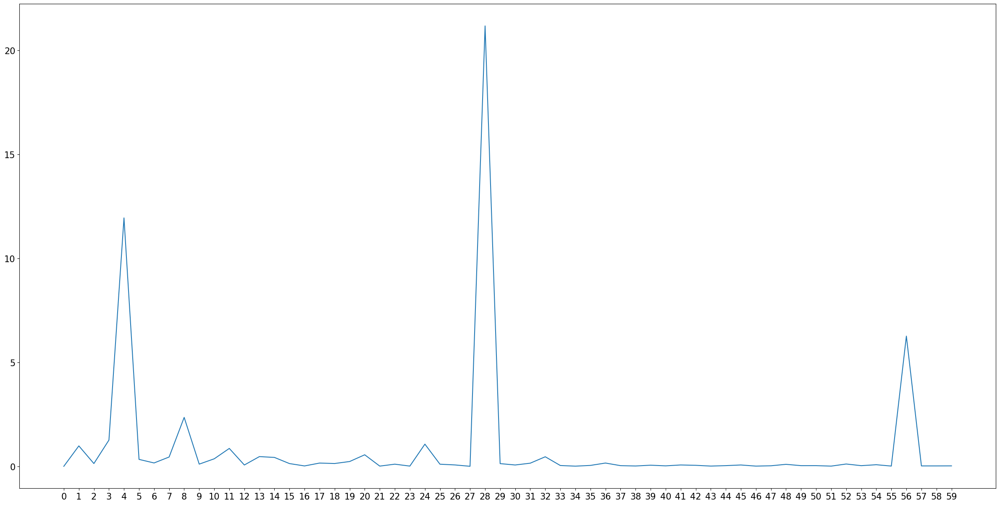

In [758]:
F, P_den = signal.periodogram(dataset_Junction1['Vehicles'][0:672],672)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[0:60], P_den[0:60])
plt.xticks(np.arange(0, len(F[0:60]), step=1))
plt.show()

Las 3 frecuencias más altas, desde la de mayor intensidad a la de menor intensidad, son:

1- Hay una frecuencia en 28 -> 672(n)/28(f)=24(T). El período es de 24 horas ( 1 día).

2- Hay una frecuencia en 4 -> 672(n)/4(f)=168(T). El período es de 168 horas (1 semana) 

3- Hay una frecuencia en 56 -> 672(n)/56(f)=12(T). El período es de 12 horas (½ día) 


##### Semanal

En este caso, se muestrean 168 horas, es decir, 24 horas/día * 7 días = 168 horas.

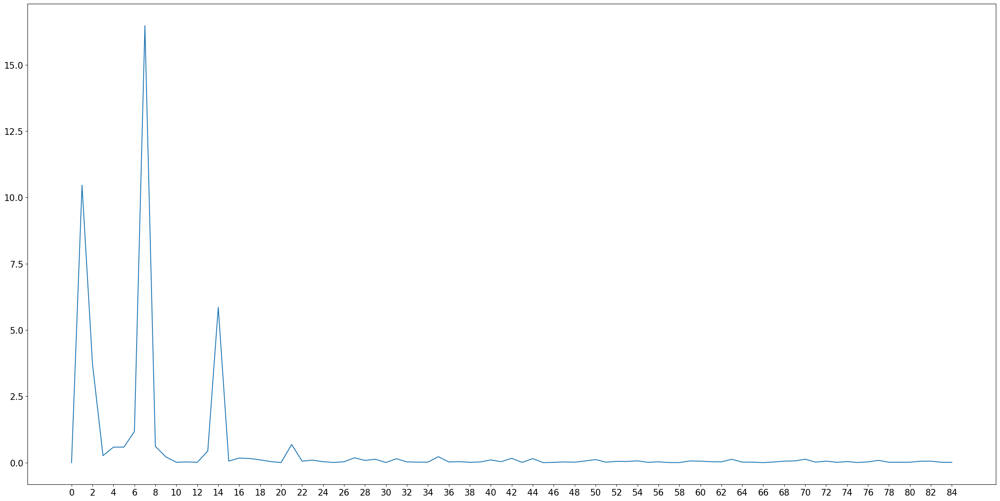

In [759]:
F, P_den = signal.periodogram(dataset_Junction1['Vehicles'][0:168],168)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F, P_den)
plt.xticks(np.arange(0, len(F), step=2))
plt.show()

Las 3 frecuencias más altas, desde la de mayor intensidad a la de menor intensidad, son:

1- Hay una frecuencia en 7 -> 168(n)/7(f)=24(T). El período es de 24 horas (1 día).

2- Hay una frecuencia en 1 -> 168(n)/1f)=168(T). El período es de 168 horas (1 semana).

3- Hay una frecuencia en 14 -> 168(n)/14(f)=12(T). El período es de 12 horas (½ día).




##### Análisis del resultado

En los tres casos se ve claramente el período diario y semanal. Además, aparece un período de 1/2 día, aunque con menos intensidad.

En el periodograma anual, también se observa un período semestral.

#### Conclusiones

La serie original no es estacionaria, según se puede observar en el gráfico de autocorrelación y el gráfico de la serie. Además, el test KPSS confirma esto. No obstante, el test de DF indica que es estacionaria, por lo tanto se sospecha que la serie diferenciada lo es.

Además, tiene ciclos: semestral, diario, semanal y de 1/2 día (12 horas).

## Tendencia determinística - Aproximación por cuadrados mínimos

### Caso lineal

In [760]:
# Defino la función objetivo.
def objective(x, a, b):
	return a * x + b

In [761]:
# Transformo los datos de tipo DateTime a números flotantes, porque sino curve_fit no funciona.
ts = np.array([t.timestamp() for t in dataset_Junction1.index])
print (type(ts))
print (type(ts[0]))
print (ts)

<class 'numpy.ndarray'>
<class 'numpy.float64'>
[1.4463360e+09 1.4463396e+09 1.4463432e+09 ... 1.4988564e+09 1.4988600e+09
 1.4988636e+09]


Parámetros: [ 1.05826519e-06 -1.51334820e+03]
y = 0.00000106 * x + -1513.34820212


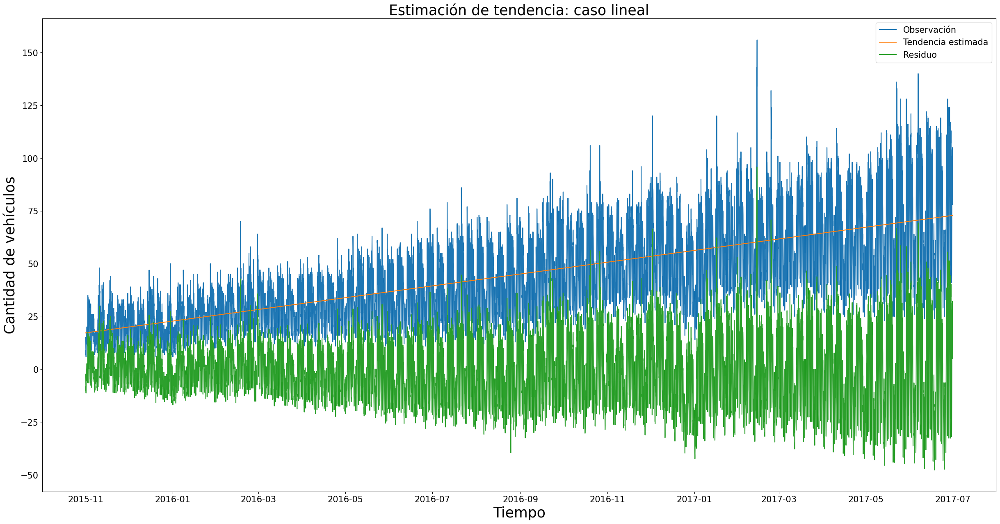

In [762]:
#Fiteo la curva.
parameters, covariance = curve_fit(objective, ts, dataset_Junction1['Vehicles'])

#Muestro los parámetros.
a,b = parameters
print ("Parámetros:",parameters)
print('y = %.8f * x + %.8f' % (a, b))

#Grafico la serie real.
plt.plot(dataset_Junction1.index, dataset_Junction1['Vehicles'], label='Observación')
#Grafico la estimación de la tendencia.
plt.plot(dataset_Junction1.index, objective(ts, *parameters), label='Tendencia estimada')
#Grafico el residuo, que debería ser una serie estacionaria.
resid=dataset_Junction1['Vehicles']- objective(ts, *parameters)
plt.plot(dataset_Junction1.index, resid, label='Residuo')
plt.title("Estimación de tendencia: caso lineal")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Autocorrelación

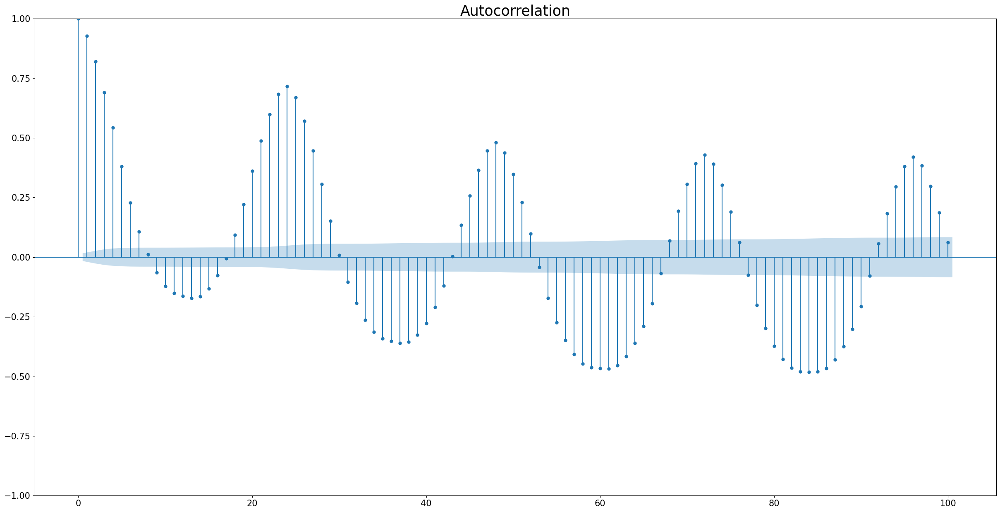

In [763]:
plot_acf(resid, lags=100)
plt.show()

##### Análisis del resultado

No cae exponencialmente. Además tiene ciclos. Por lo tanto, se sospecha que aunque se reste la tendencia lineal continúa siendo NO estacionaria.

#### Autocorrelación parcial

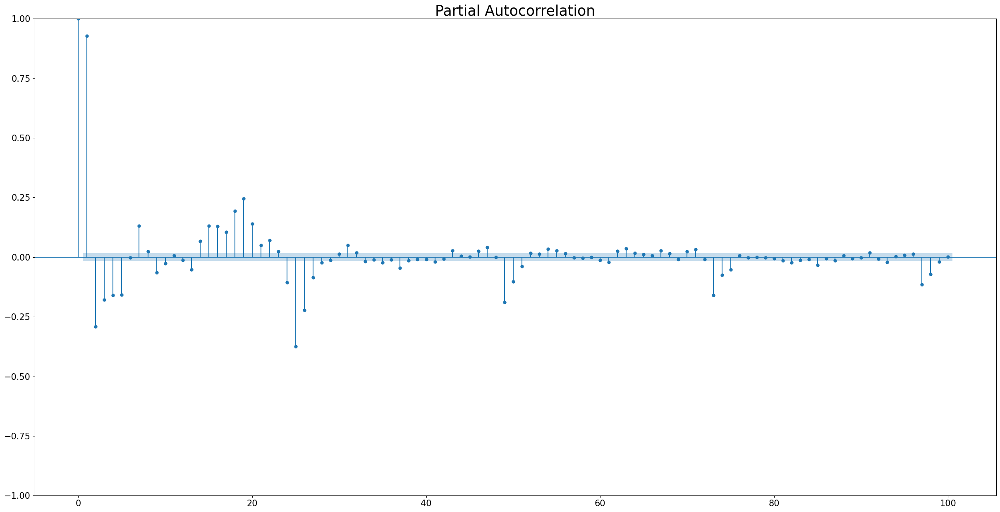

In [764]:
plot_pacf(resid, lags=100, method='ywm')
plt.show()

##### Análisis del resultado

Se continúa visualizando ciclos.

#### Test Dickey-Fuller

In [765]:
adf_test(resid)

Resultados del test de Dickey-Fuller:
Estadístico              -1.748395e+01
p-valor                   4.473816e-30
# Lags usados             4.200000e+01
# Observaciones usadas    1.454900e+04
Valor del umbral (1%)    -3.430800e+00
Valor del umbral (5%)    -2.861739e+00
Valor del umbral (10%)   -2.566876e+00
dtype: float64


##### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA. Ahora bien, se sospecha que la que es estacionaria es la serie diferenciada, ya que la serie original no parece ser estacionaria.

#### Test KPSS

In [766]:
kpsstest = kpss_test(resid)

Results of KPSS Test:
Estadístico                  0.058196
p-valor                      0.100000
Lags usados                 52.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


##### Análisis del resultado

El estadístico es menor al umbral en los 4 casos, por lo tanto no puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy grande. En consecuencia, según esto es ESTACIONARIA. No obstante, se sospecha que da este resultado porque aún falta extraer la tendencia cíclica.

#### Conclusiones

Si resto una tendencia lineal, el residuo no es estacionario ya que la varianza continúa aumentando a través del tiempo. Es decir, toma valores diferentes en distintos intervalos de tiempo de la misma longitud. No obstante, la media es constante a través del tiempo, pero con esta característica no alcanza para decir que el residuo es estacionario.

Si observamos la autocorrelación, se ve la presencia de ciclos y que no es estacionaria.

No obstante, los dos test están indicando que es estacionaria. Esto se debe a que probablemente haya que quitar la tendencia cíclica, y además, aplicar una diferenciación.

Finalmente, se concluye que NO es ESTACIONARIA.

### Caso cíclico

#### Período de 24 hs. (diario)

In [767]:
#Determino un período de 24 hs.
period=24
#Cálculo de los parámetros de la observación por cuadrados mínimos.
data_graphic_real=np.array(dataset_Junction1['Vehicles'])
rows=int(len(dataset_Junction1['Vehicles'])/period)
data=np.array(dataset_Junction1['Vehicles']).reshape(rows,period)
print ("Cantidad de períodos:",data.shape[0])
betas=data.mean(axis=0)
print ("Parámetros estimados (betas):\n",betas)

Cantidad de períodos: 608
Parámetros estimados (betas):
 [45.73848684 39.15625    33.90789474 29.43092105 25.65460526 24.06743421
 26.08059211 29.52631579 32.73519737 39.00328947 49.52796053 56.1875
 57.25493421 51.07565789 54.73355263 54.21875    51.91118421 51.85197368
 55.41118421 58.80427632 57.40131579 54.53782895 52.96381579 50.08881579]


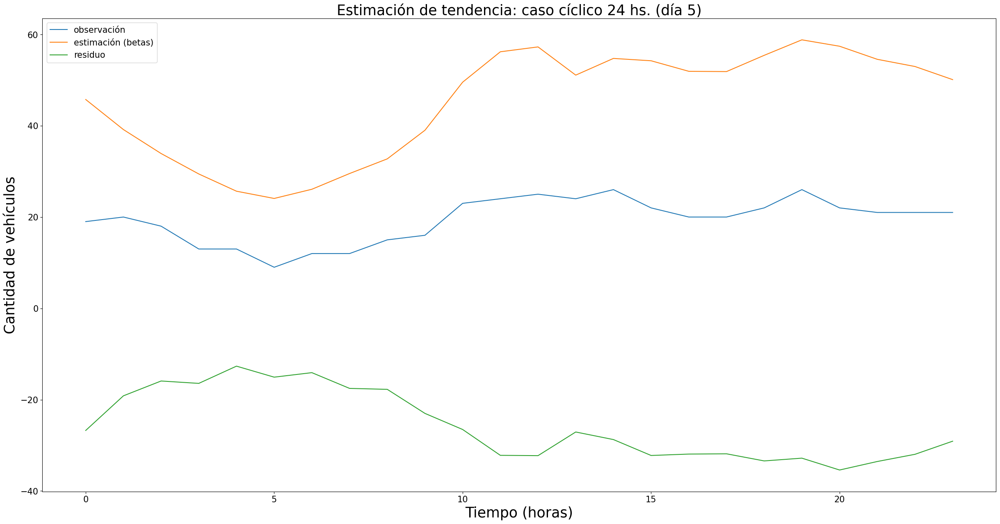

In [768]:
# Se ejemplifica el quinto período (quinto día).
# Recordar que se enumera a partir del 0.
sample=4
# Plotea para el cuarto período (el cuarto día), el valor real de las 24 horas del día.
plt.plot(data[sample,:],label='observación')
# Plotea las estimaciones para cada hora del día, durante 24 horas.
plt.plot(betas,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
plt.plot(data[sample,:]-betas,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 24 hs. (día 5)")
plt.legend()
plt.xlabel("Tiempo (horas)")
plt.ylabel("Cantidad de vehículos")
plt.show()

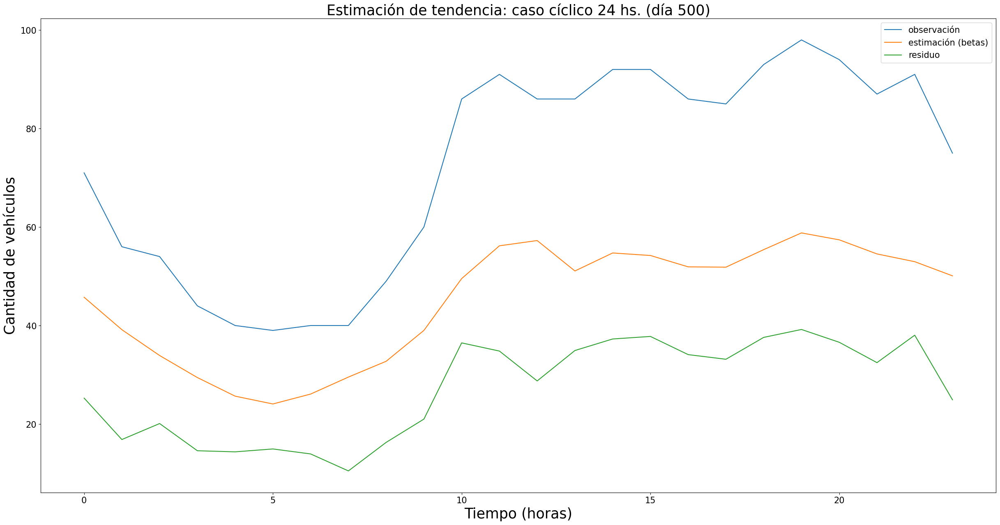

In [769]:
# Se ejemplifica el período número 500 (día 500).
# Recordar que se enumera a partir del 0.
sample=499
# Plotea para el cuarto período (el cuarto día), el valor real de las 24 horas del día.
plt.plot(data[sample,:],label='observación')
# Plotea las estimaciones para cada hora del día, durante 24 horas.
plt.plot(betas,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
plt.plot(data[sample,:]-betas,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 24 hs. (día 500)")
plt.legend()
plt.xlabel("Tiempo (horas)")
plt.ylabel("Cantidad de vehículos")
plt.show()

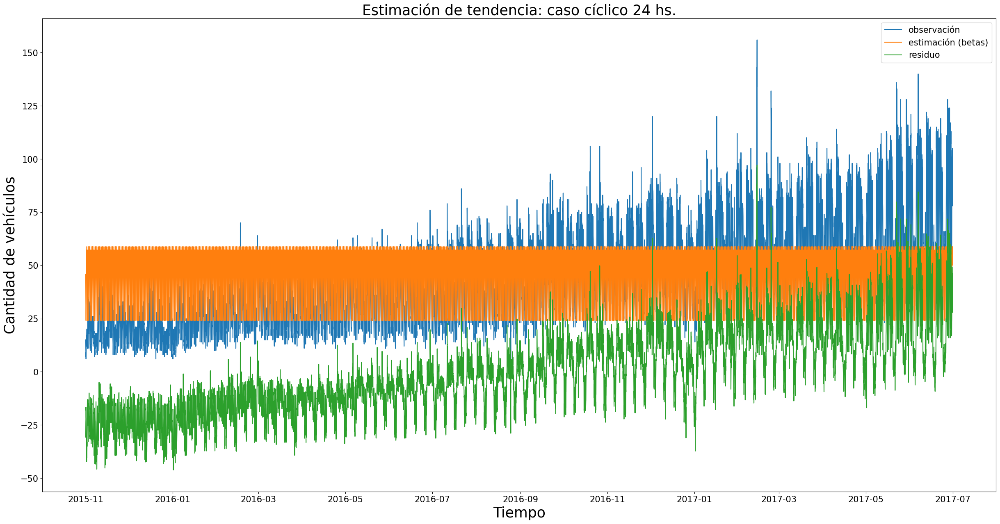

In [770]:
#Se muestra a lo largo de toda la serie.
est=np.tile(betas,rows)
# Plotea todas las observaciones (valor real).
plt.plot(dataset_Junction1.index,data_graphic_real,label='observación')
# Plotea las estimaciones de todas las observaciones
plt.plot(dataset_Junction1.index,est,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
resid=data_graphic_real-est
plt.plot(dataset_Junction1.index,resid,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 24 hs.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

##### Autocorrelación

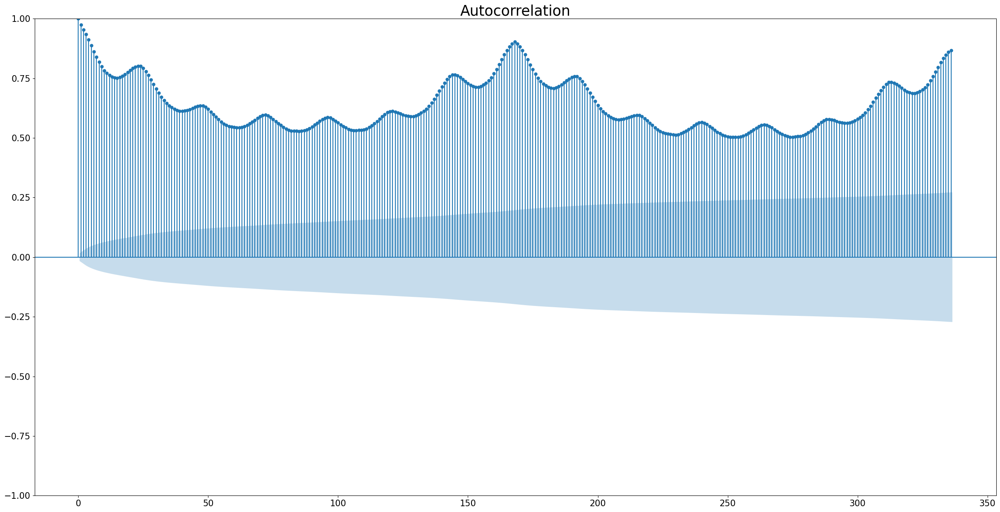

In [771]:
plot_acf(resid, lags=336)
plt.show()

###### Análisis del resultado

No cae exponencialmente. Además tiene ciclos. Por lo tanto, se sospecha que aunque se reste la tendencia cíclica de 24 hs. continúa siendo NO estacionaria.

##### Autocorrelación parcial

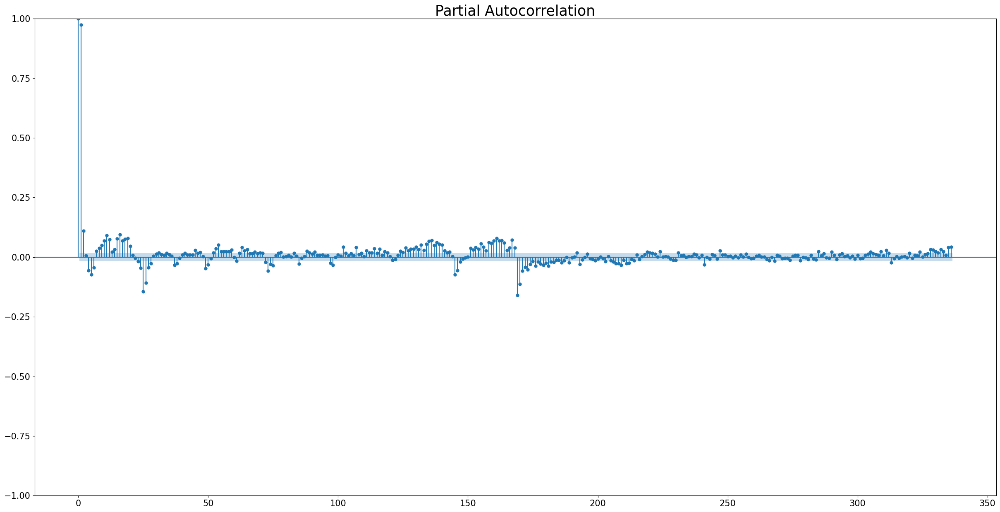

In [772]:
plot_pacf(resid, lags=336, method='ywm')
plt.show()

###### Análisis del resultado

Se continúa visualizando ciclos.

##### Test Dickey-Fuller

In [773]:
adf_test(resid)

Resultados del test de Dickey-Fuller:
Estadístico              -7.604403e+00
p-valor                   2.342980e-11
# Lags usados             4.000000e+01
# Observaciones usadas    1.455100e+04
Valor del umbral (1%)    -3.430799e+00
Valor del umbral (5%)    -2.861739e+00
Valor del umbral (10%)   -2.566876e+00
dtype: float64


###### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA. Ahora bien, se sospecha que la que es estacionaria es la serie diferenciada, ya que la serie original no parece ser estacionaria.

##### Test KPSS

In [774]:
kpsstest = kpss_test(resid)

Results of KPSS Test:
Estadístico                 17.683852
p-valor                      0.010000
Lags usados                 71.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


###### Análisis del resultado

El estadístico es mayor al umbral en los 4 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es NO ESTACIONARIA.

##### Análisis espectral: periodograma

###### Anual

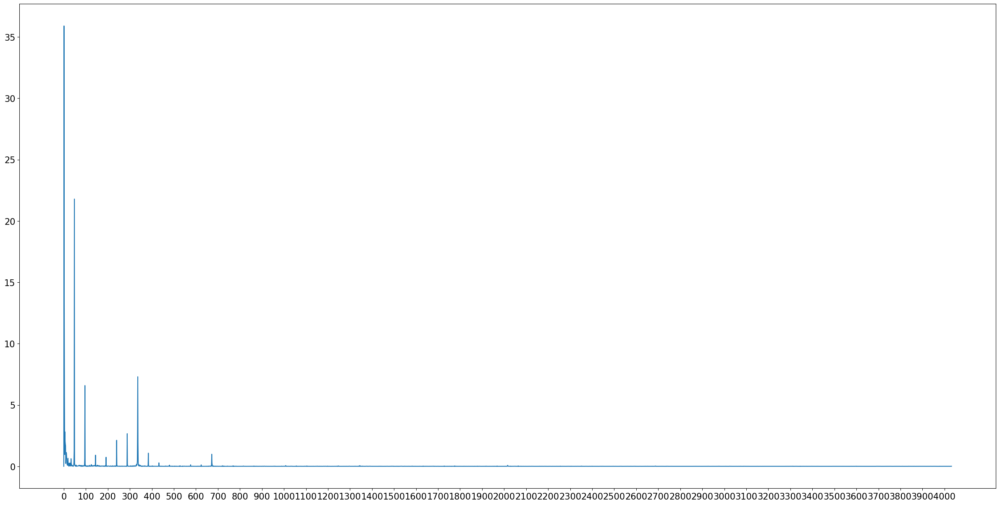

In [775]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F, P_den)
plt.xticks(np.arange(0, len(F), step=100))
plt.show()

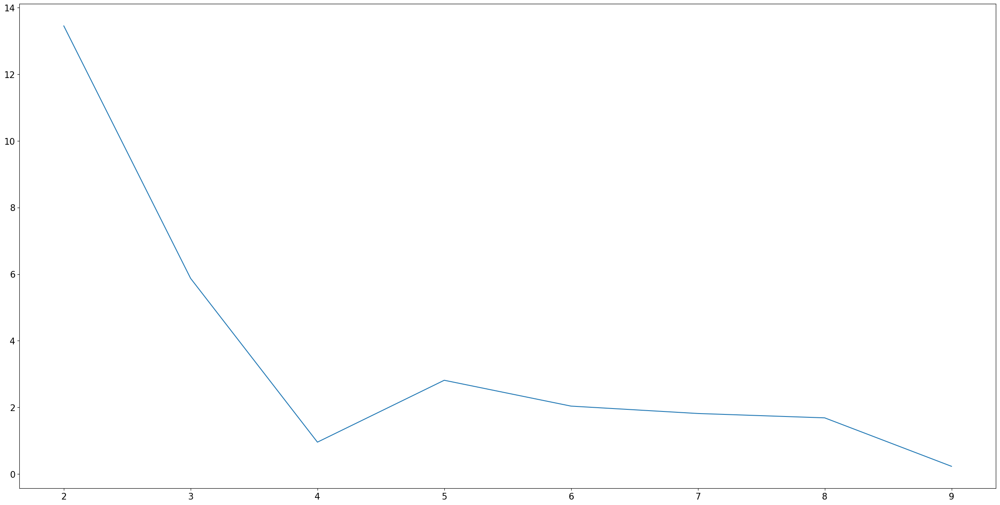

In [776]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[2:10], P_den[2:10])
plt.xticks(np.arange(2, 10, step=1))
plt.show()

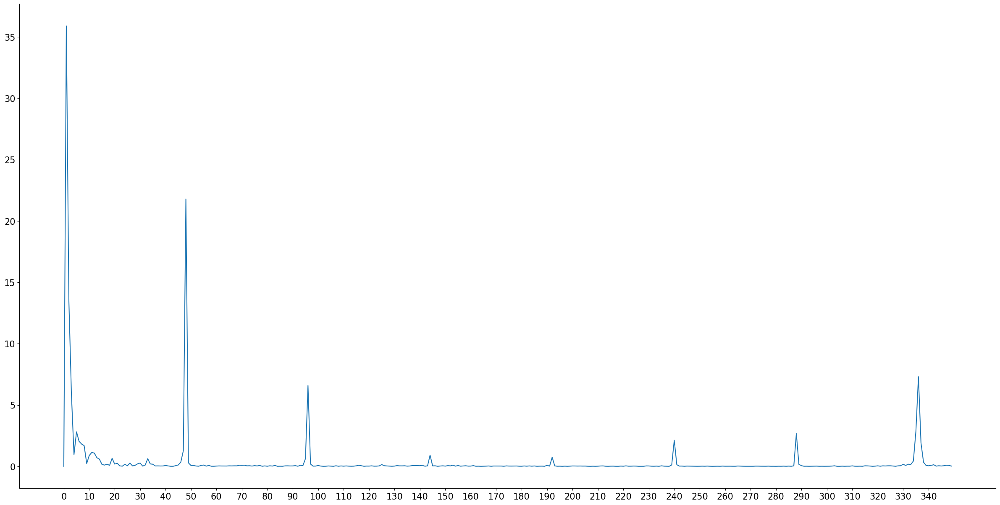

In [777]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[0:350], P_den[0:350])
plt.xticks(np.arange(0, 350, step=10))
plt.show()

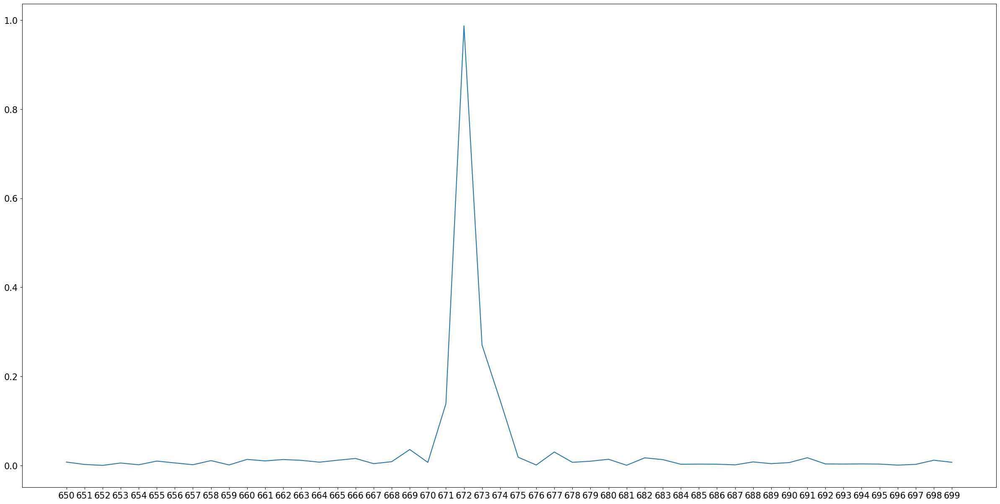

In [778]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[650:700], P_den[650:700])
plt.xticks(np.arange(650, 700, step=1))
plt.show()

El periodograma es muy similar al de la serie original excepto porque la frecuencia en 336 que representaba el período de 24 horas, paso del primer lugar en intensidad al cuarto. Por otro lado, el período de 12 horas paso del quinto lugar a casi desaparecer. 

Las 5 frecuencias, de mayor a menor intensidad, ahora tienen la siguiente configuración:

1- Hay una frecuencia en 1 -> 8064(n)/1(f)=8064(T). El período es de 8064 horas (1 año).

2- Hay una frecuencia en 48 -> 8064(n)/48(f)=168(T). El período es de 168 horas (1 semana). 

3- Hay una frecuencia en 2 -> 8064(n)/2(f)=4032(T). El período es de 4032 horas (1/2 año).

4- Hay una frecuencia en 336 -> 8064(n)/336(f)=24(T). El período es de 24 horas (1 día).

N- Hay una frecuencia en 672 -> 8064(n)/672(f)=12(T). El período es de 12 horas (1/2 día). 


Esto hace sentido porque se restó la tendencia cíclica de 24 horas a la serie original y eso a su vez afecto al ciclo de 12 horas.

##### Conclusiones

Se puede notar como la curva de estimación es mayor que la observada en los primeros períodos, pero menor en los últimos. Esto se debe a que el tránsito aumenta a lo largo del tiempo. Esto sucede porque la media no es constante a lo largo del tiempo, sino que va aumentando. Por lo tanto, el residuo no es estacionario. Además, la varianza continúa aumentando a medida lo hace el tiempo. Es decir, la varianza toma valores diferentes en distintos intervalos de la misma longitud, si se toma un intervalo al principio o al final del residuo.

Si observamos la autocorrelación, se ve la presencia de ciclos y que la serie no es estacionaria. Esto se confirma con el test KPSS. Incluso el periodograma sigue estableciendo diferentes ciclos, por ejemplo, semanal.

No obstante, el test DF indica que es estacionaria. Esto se debe a que probablemente haya que diferenciar.

Finalmente, se concluye que el residuo NO es ESTACIONARIO.

#### Período de 168 hs. (semanal)

In [779]:
#Determino un período de 168 hs.
period_168=168
#Cálculo de los parámetros de la observación por cuadrados mínimos.
data_graphic_real_168=np.array(dataset_Junction1['Vehicles'])
rows_168=int(len(dataset_Junction1['Vehicles'])/period_168)
data_array=np.array(dataset_Junction1['Vehicles'])
#Se descartan los últimos datos, porque no completan un período.
cant_data=rows_168*period_168
data_168=data_array[0:cant_data].reshape(rows_168,period_168)
print ("Cantidad de períodos:",data_168.shape[0])
betas_168=data_168.mean(axis=0)
print ("Parámetros estimados (betas):\n",betas_168)

Cantidad de períodos: 86
Parámetros estimados (betas):
 [35.5        29.79069767 25.25581395 22.65116279 20.15116279 18.75581395
 19.52325581 21.38372093 24.15116279 29.09302326 33.04651163 34.88372093
 35.53488372 33.69767442 33.04651163 33.10465116 33.03488372 34.55813953
 39.37209302 43.63953488 43.47674419 42.41860465 42.72093023 41.61627907
 37.89534884 32.20930233 27.94186047 25.81395349 23.46511628 23.22093023
 26.25581395 30.63953488 34.18604651 42.09302326 56.23255814 67.26744186
 67.89534884 59.58139535 65.30232558 64.65116279 61.09302326 61.03488372
 63.95348837 67.46511628 65.03488372 61.23255814 59.04651163 55.34883721
 50.03488372 43.3372093  38.1744186  32.55813953 28.36046512 26.39534884
 29.52325581 33.39534884 36.80232558 43.34883721 55.94186047 62.54651163
 64.88372093 57.73255814 63.58139535 63.1744186  60.38372093 60.06976744
 63.26744186 66.48837209 64.24418605 61.01162791 58.44186047 54.95348837
 50.84883721 43.84883721 38.11627907 32.68604651 28.         26.3720

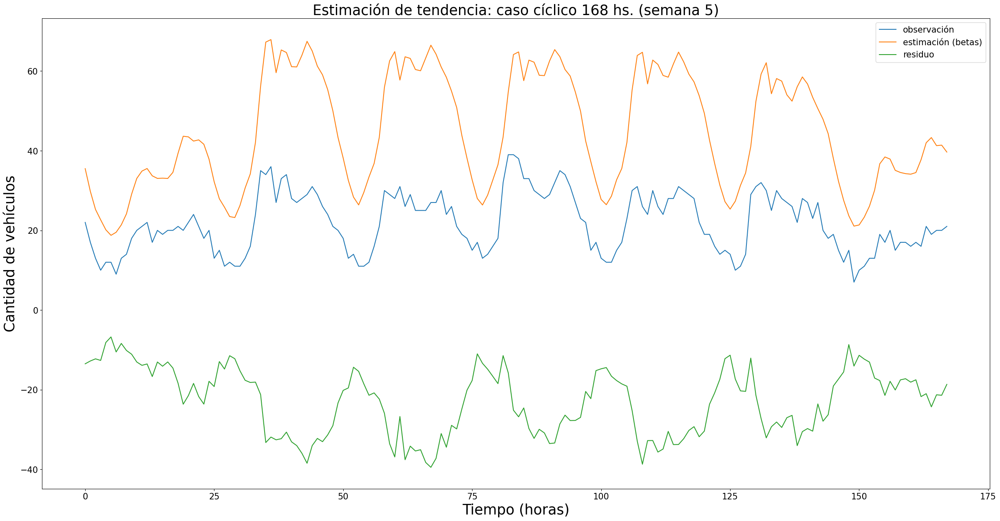

In [780]:
# Se ejemplifica el quinto período (quinta semana).
# Recordar que se enumera a partir del 0.
sample_168=4
# Plotea para el cuarto período (el cuarto día), el valor real de las 24 horas del día.
plt.plot(data_168[sample_168,:],label='observación')
# Plotea las estimaciones para cada hora del día, durante 24 horas.
plt.plot(betas_168,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
plt.plot(data_168[sample_168,:]-betas_168,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 168 hs. (semana 5)")
plt.legend()
plt.xlabel("Tiempo (horas)")
plt.ylabel("Cantidad de vehículos")
plt.show()

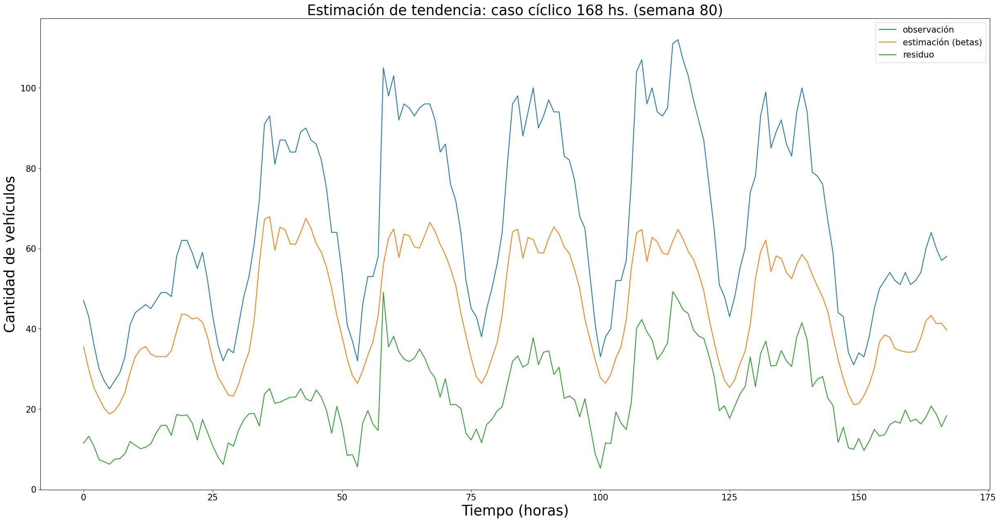

In [781]:
# Se ejemplifica el período número 80 (semana 80).
# Recordar que se enumera a partir del 0.
sample_168=79
# Plotea para el cuarto período (el cuarto día), el valor real de las 24 horas del día.
plt.plot(data_168[sample_168,:],label='observación')
# Plotea las estimaciones para cada hora del día, durante 24 horas.
plt.plot(betas_168,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
plt.plot(data_168[sample_168,:]-betas_168,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 168 hs. (semana 80)")
plt.legend()
plt.xlabel("Tiempo (horas)")
plt.ylabel("Cantidad de vehículos")
plt.show()

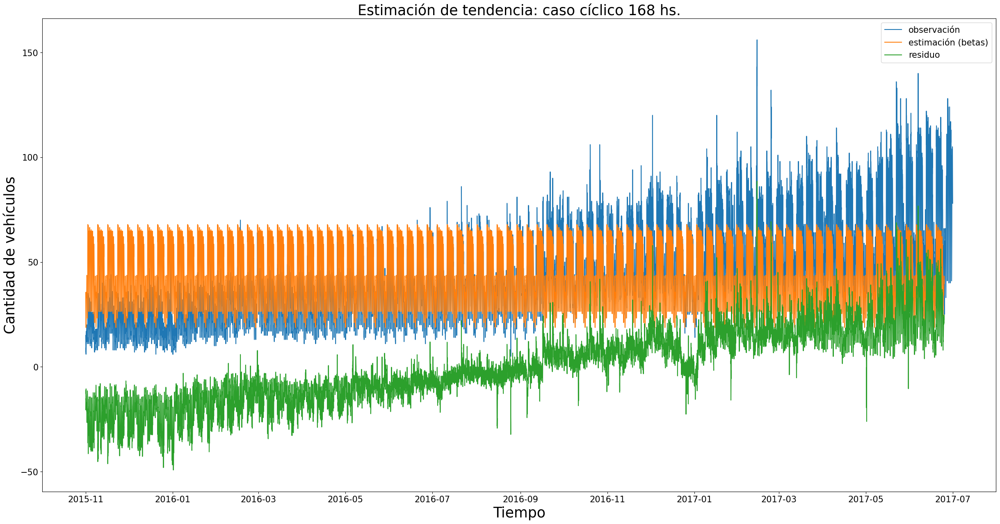

In [782]:
#Se muestra a lo largo de toda la serie.
est_168=np.tile(betas_168,rows_168)
# Plotea todas las observaciones (valor real).
plt.plot(dataset_Junction1.index,data_graphic_real_168,label='observación')
# Plotea las estimaciones de todas las observaciones
plt.plot(dataset_Junction1[0:cant_data].index,est_168,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
# Para el valor real solo se tienen en cuenta las observaciones, que tienen
# su correspondiente estimación. Es decir, se descartan las últimas, porque
# no llegan a completar un período de 168 horas.
resid=data_graphic_real_168[0:cant_data]-est_168
plt.plot(dataset_Junction1[0:cant_data].index,resid,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 168 hs.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

##### Autocorrelación

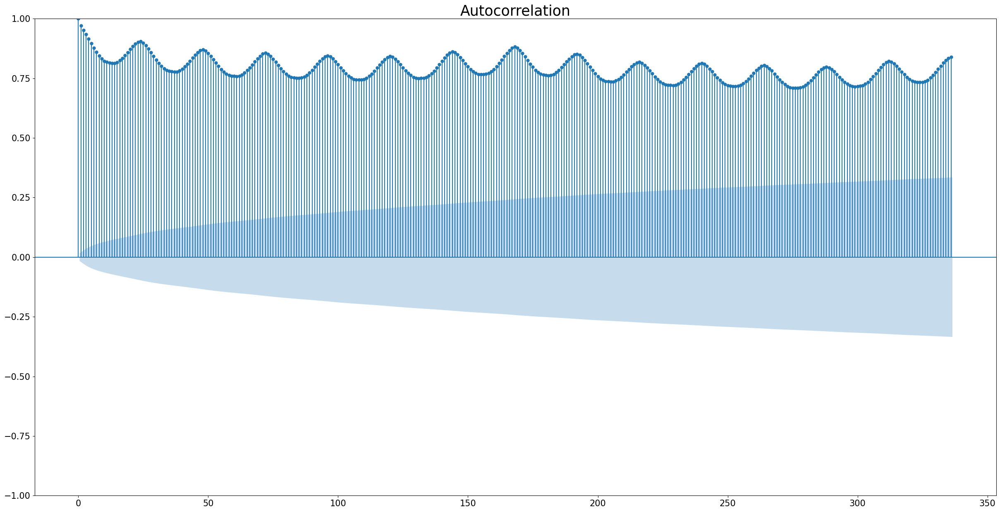

In [783]:
plot_acf(resid, lags=336)
plt.show()

###### Análisis del resultado

No cae exponencialmente. Además tiene ciclos. Por lo tanto, se sospecha que aunque se reste la tendencia cíclica de 168 hs. continúa siendo NO estacionaria.

##### Autocorrelación parcial

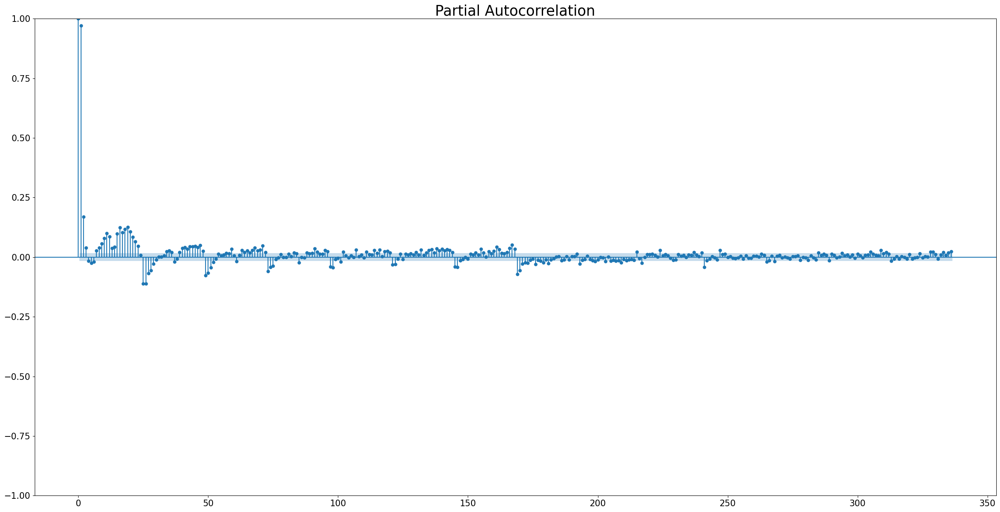

In [784]:
plot_pacf(resid, lags=336, method='ywm')
plt.show()

###### Análisis del resultado

Se continúa visualizando ciclos.

##### Test Dickey-Fuller

In [785]:
adf_test(resid)

Resultados del test de Dickey-Fuller:
Estadístico                  -3.466471
p-valor                       0.008891
# Lags usados                42.000000
# Observaciones usadas    14405.000000
Valor del umbral (1%)        -3.430804
Valor del umbral (5%)        -2.861741
Valor del umbral (10%)       -2.566877
dtype: float64


###### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA. Ahora bien, se sospecha que la que es estacionaria es la serie diferenciada, ya que la serie original no parece ser estacionaria.

##### Test KPSS

In [786]:
kpsstest = kpss_test(resid)

Results of KPSS Test:
Estadístico                 19.059286
p-valor                      0.010000
Lags usados                 71.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


###### Análisis del resultado

El estadístico es mayor al umbral en los 4 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es NO ESTACIONARIA.

##### Análisis espectral: periodograma

###### Anual

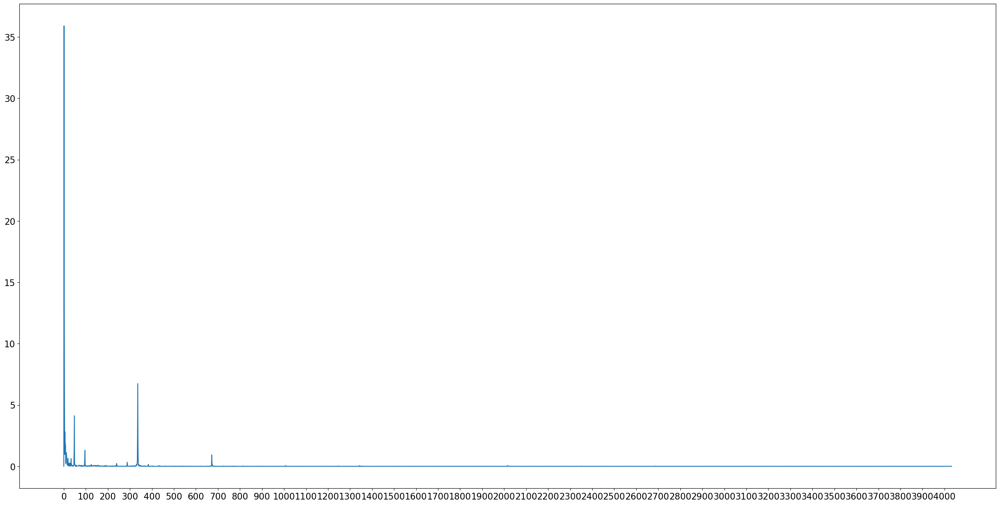

In [787]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F, P_den)
plt.xticks(np.arange(0, len(F), step=100))
plt.show()

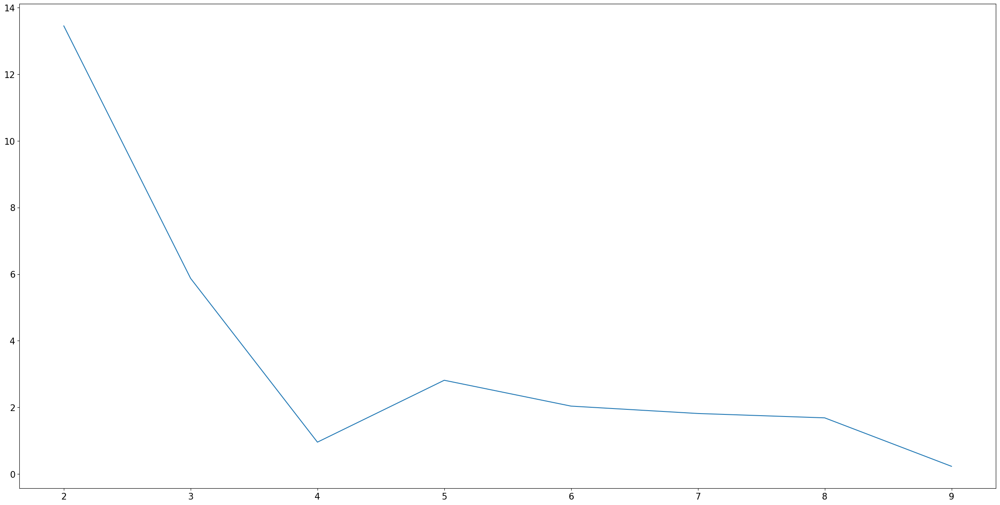

In [788]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[2:10], P_den[2:10])
plt.xticks(np.arange(2, 10, step=1))
plt.show()

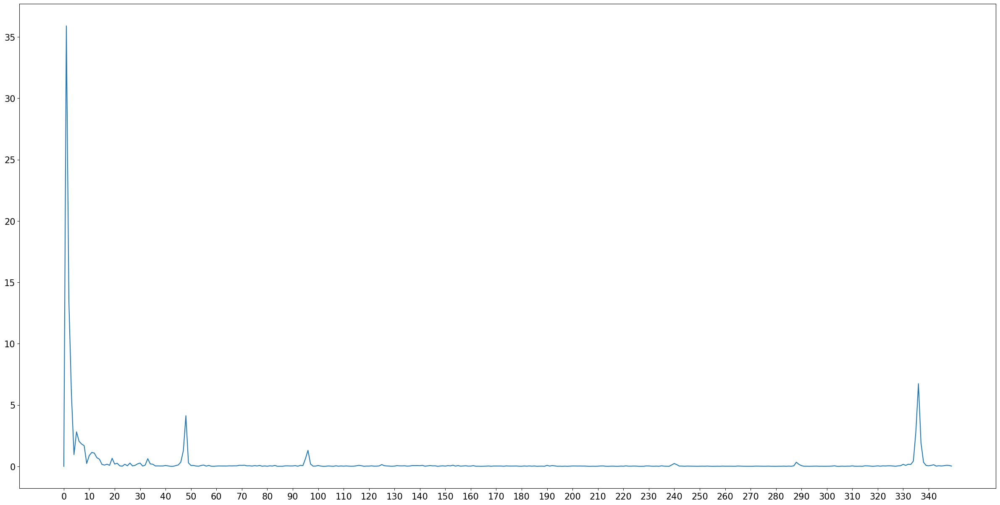

In [789]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[0:350], P_den[0:350])
plt.xticks(np.arange(0, 350, step=10))
plt.show()

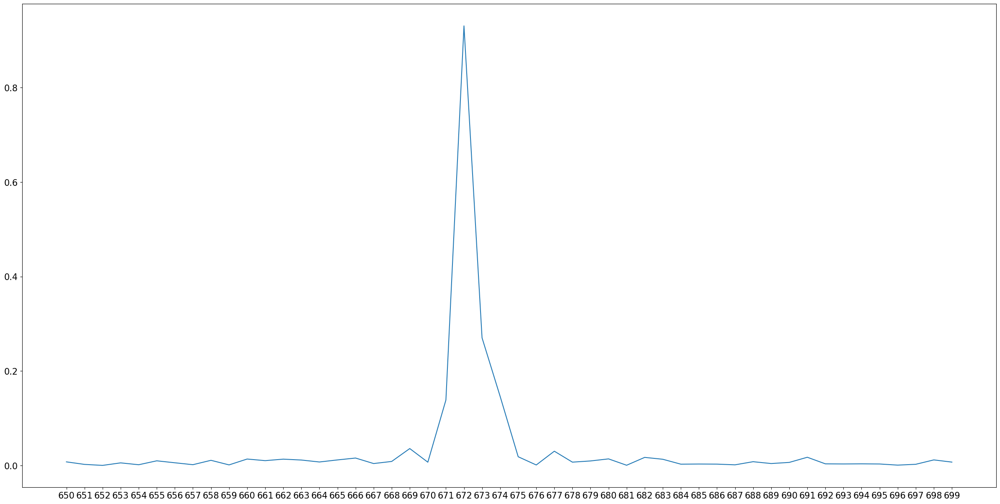

In [790]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[650:700], P_den[650:700])
plt.xticks(np.arange(650, 700, step=1))
plt.show()

El periodograma es muy similar al de la serie original excepto porque la frecuencia en 336 que representaba el período de 24 horas, paso del primer lugar en intensidad al tercero. Luego, la frecuencia en 48 que representaba al período de 1 semana disminuyó en intensidad de 20 a 5 aprox. y paso del tercer al cuarto puesto. Por último, el período de 12 horas paso del quinto lugar a casi desaparecer. 

Las 5 frecuencias, de mayor a menor intensidad, ahora tienen la siguiente configuración:

1- Hay una frecuencia en 1 -> 8064(n)/1(f)=8064(T). El período es de 8064 horas (1 año).

2- Hay una frecuencia en 2 -> 8064(n)/2(f)=4032(T). El período es de 4032 horas (1/2 año).

3- Hay una frecuencia en 336 -> 8064(n)/336(f)=24(T). El período es de 24 horas (1 día).

4- Hay una frecuencia en 48 -> 8064(n)/48(f)=168(T). El período es de 168 horas (1 semana). 

N- Hay una frecuencia en 672 -> 8064(n)/672(f)=12(T). El período es de 12 horas (1/2 día). 

Hace sentido que disminuya la intensidad de la frecuencia semanal, porque se restó la tendencia cíclica de 168 horas (1 semana) a la serie original. Esto a su vez, incide en el comportamiento diario y de 1/2 día. Este último desapareció practicamente.

##### Conclusiones

Se puede notar como la curva de estimación es mayor que la observada en los primeros períodos, pero menor en los últimos. Esto se debe a que el tránsito aumenta a lo largo del tiempo. Esto sucede porque la media no es constante a lo largo del tiempo, sino que va aumentando. Por lo tanto, el residuo no es estacionario. Además, la varianza continúa aumentando a medida lo hace el tiempo. Es decir, la varianza toma valores diferentes en distintos intervalos de la misma longitud, si se toma un intervalo al principio o al final del residuo.

Si observamos la autocorrelación, se ve la presencia de ciclos y que la serie no es estacionaria. Esto se confirma con el test KPSS. Incluso el periodograma sigue estableciendo diferentes ciclos, por ejemplo, diario.

No obstante, el test DF indica que es estacionaria. Esto se debe a que probablemente haya que diferenciar.

Finalmente, se concluye que el residuo NO es ESTACIONARIO.

#### Período de 4032 hs. (6 meses)

In [791]:
#Determino un período de 4032 hs.
period_4032=4032
#Cálculo de los parámetros de la observación por cuadrados mínimos.
data_graphic_real_4032=np.array(dataset_Junction1['Vehicles'])
rows_4032=int(len(dataset_Junction1['Vehicles'])/period_4032)
data_array=np.array(dataset_Junction1['Vehicles'])
#Se descartan los últimos datos, porque no completan un período.
cant_data=rows_4032*period_4032
data_4032=data_array[0:cant_data].reshape(rows_4032,period_4032)
print ("Cantidad de períodos:",data_4032.shape[0])
betas_4032=data_4032.mean(axis=0)
print ("Parámetros estimados (betas):\n",betas_4032)

Cantidad de períodos: 3
Parámetros estimados (betas):
 [28.33333333 25.         19.33333333 ... 44.33333333 47.
 44.        ]


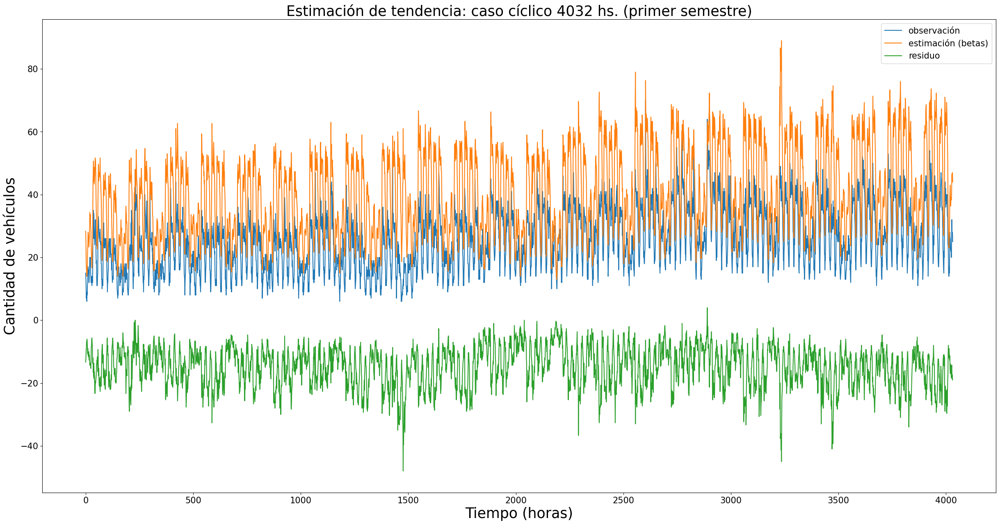

In [792]:
# Se ejemplifica el primer período (primer semestre).
# Recordar que se enumera a partir del 0.
sample_4032=0
# Plotea para el cuarto período (el cuarto día), el valor real de las 24 horas del día.
plt.plot(data_4032[sample_4032,:],label='observación')
# Plotea las estimaciones para cada hora del día, durante 24 horas.
plt.plot(betas_4032,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
plt.plot(data_4032[sample_4032,:]-betas_4032,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 4032 hs. (primer semestre)")
plt.legend()
plt.xlabel("Tiempo (horas)")
plt.ylabel("Cantidad de vehículos")
plt.show()

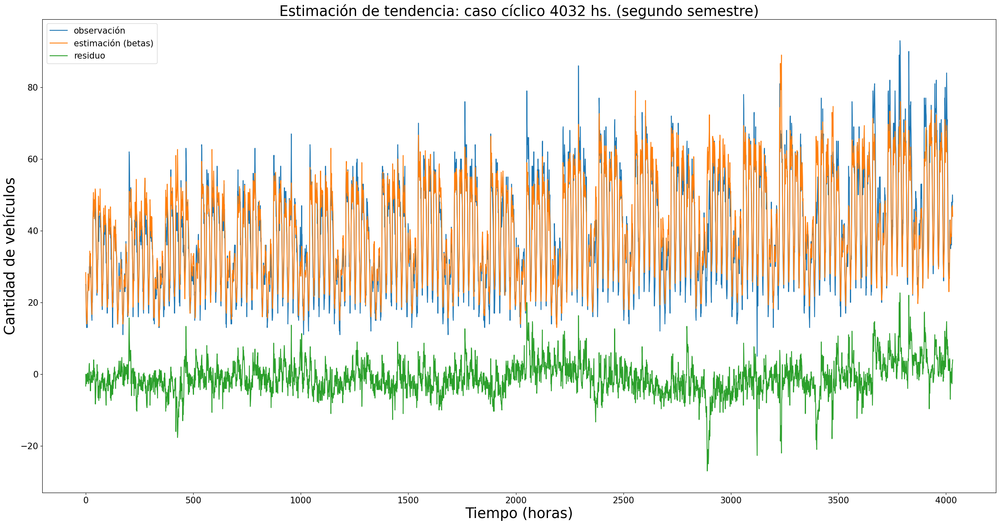

In [793]:
# Se ejemplifica el período número 2 (segundo semestre).
# Recordar que se enumera a partir del 0.
sample_4032=1
# Plotea para el cuarto período (el cuarto día), el valor real de las 24 horas del día.
plt.plot(data_4032[sample_4032,:],label='observación')
# Plotea las estimaciones para cada hora del día, durante 24 horas.
plt.plot(betas_4032,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
plt.plot(data_4032[sample_4032,:]-betas_4032,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 4032 hs. (segundo semestre)")
plt.legend()
plt.xlabel("Tiempo (horas)")
plt.ylabel("Cantidad de vehículos")
plt.show()

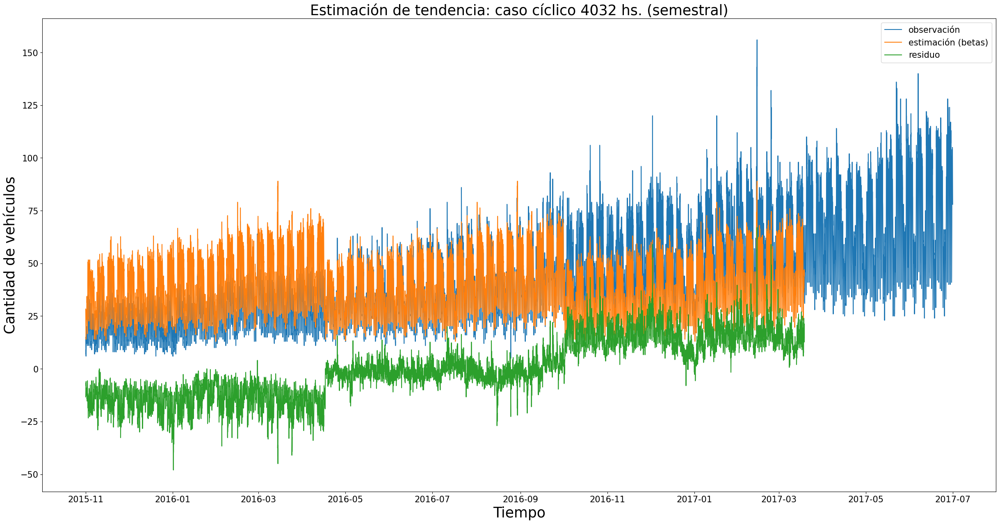

In [794]:
#Se muestra a lo largo de toda la serie.
est_4032=np.tile(betas_4032,rows_4032)
# Plotea todas las observaciones (valor real).
plt.plot(dataset_Junction1.index,data_graphic_real_4032,label='observación')
# Plotea las estimaciones de todas las observaciones
plt.plot(dataset_Junction1[0:cant_data].index,est_4032,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
# Para el valor real solo se tienen en cuenta las observaciones, que tienen
# su correspondiente estimación. Es decir, se descartan las últimas, porque
# no llegan a completar un período de 4032 horas.
resid=data_graphic_real_4032[0:cant_data]-est_4032
plt.plot(dataset_Junction1[0:cant_data].index,resid,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 4032 hs. (semestral)")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

##### Autocorrelación

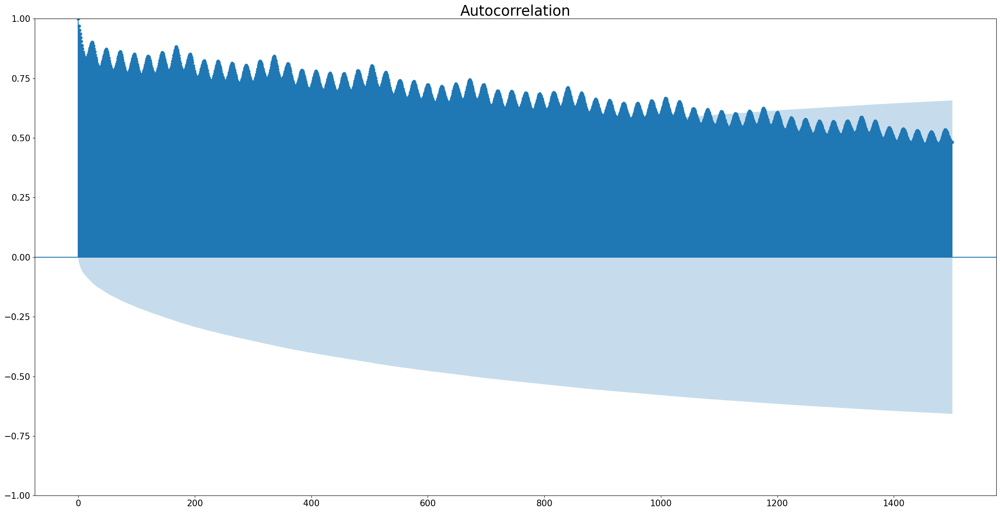

In [795]:
plot_acf(resid, lags=1500)
plt.show()

###### Análisis del resultado

Cae muy lentamente. Además tiene ciclos. Por lo tanto, se sospecha que aunque se reste la tendencia cíclica de 4032 hs. continúa siendo NO estacionaria.

##### Autocorrelación parcial

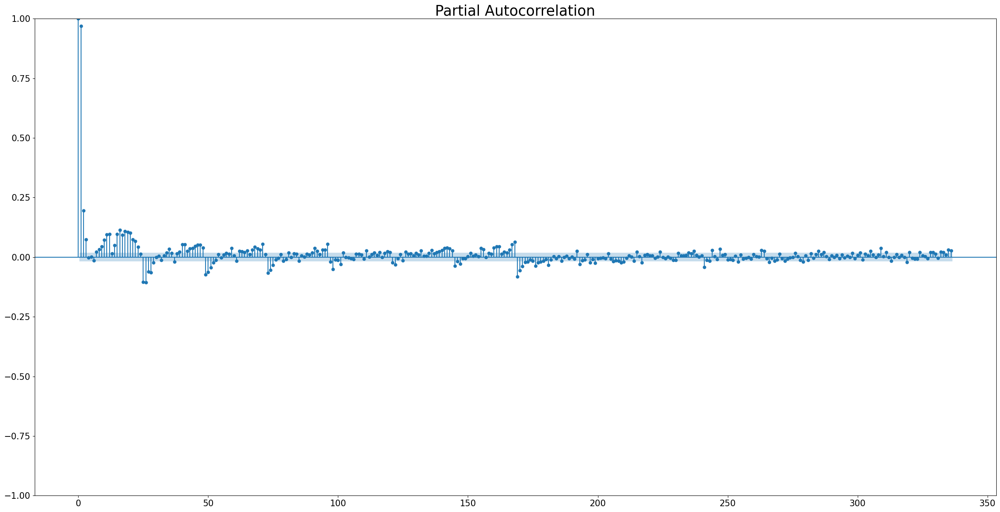

In [796]:
plot_pacf(resid, lags=336, method='ywm')
plt.show()

###### Análisis del resultado

Se continúa visualizando ciclos.

##### Test Dickey-Fuller

In [797]:
adf_test(resid)

Resultados del test de Dickey-Fuller:
Estadístico                  -3.254040
p-valor                       0.017062
# Lags usados                40.000000
# Observaciones usadas    12055.000000
Valor del umbral (1%)        -3.430893
Valor del umbral (5%)        -2.861780
Valor del umbral (10%)       -2.566898
dtype: float64


###### Análisis del resultado

El estadístico es menor al umbral en 2 de los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA. Ahora bien, se sospecha que la que es estacionaria es la serie diferenciada, ya que la serie original no parece ser estacionaria.

##### Test KPSS

In [798]:
kpsstest = kpss_test(resid)

Results of KPSS Test:
Estadístico                 15.58808
p-valor                      0.01000
Lags usados                 67.00000
Valor del umbrarl (10%)      0.34700
Valor del umbrarl (5%)       0.46300
Valor del umbrarl (2.5%)     0.57400
Valor del umbrarl (1%)       0.73900
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


###### Análisis del resultado

El estadístico es mayor al umbral en los 4 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es NO ESTACIONARIA.

##### Análisis espectral: periodograma

###### Anual

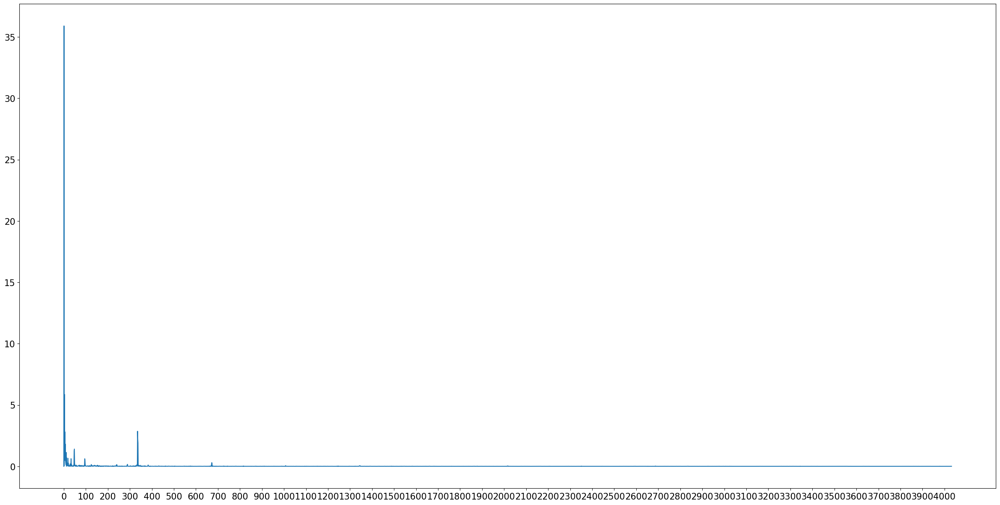

In [799]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F, P_den)
plt.xticks(np.arange(0, len(F), step=100))
plt.show()

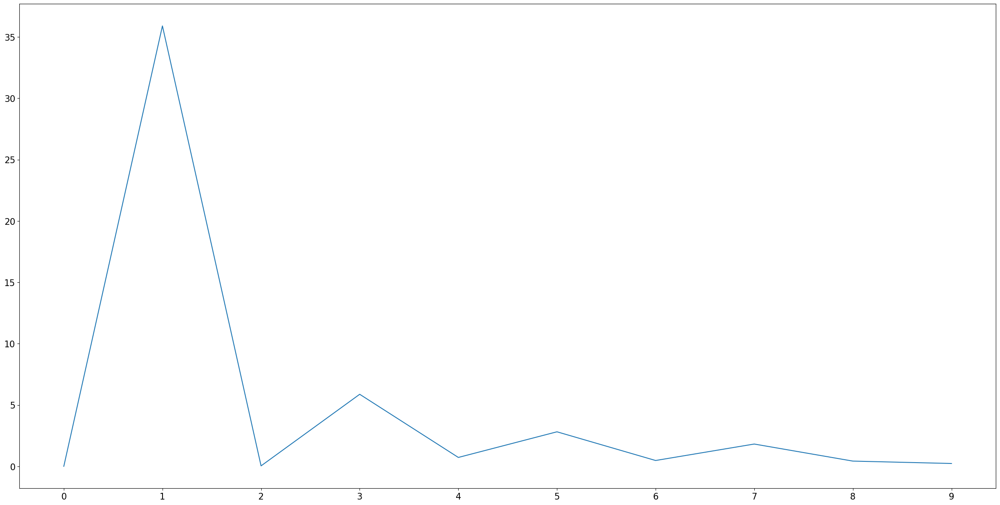

In [800]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[0:10], P_den[0:10])
plt.xticks(np.arange(0, 10, step=1))
plt.show()

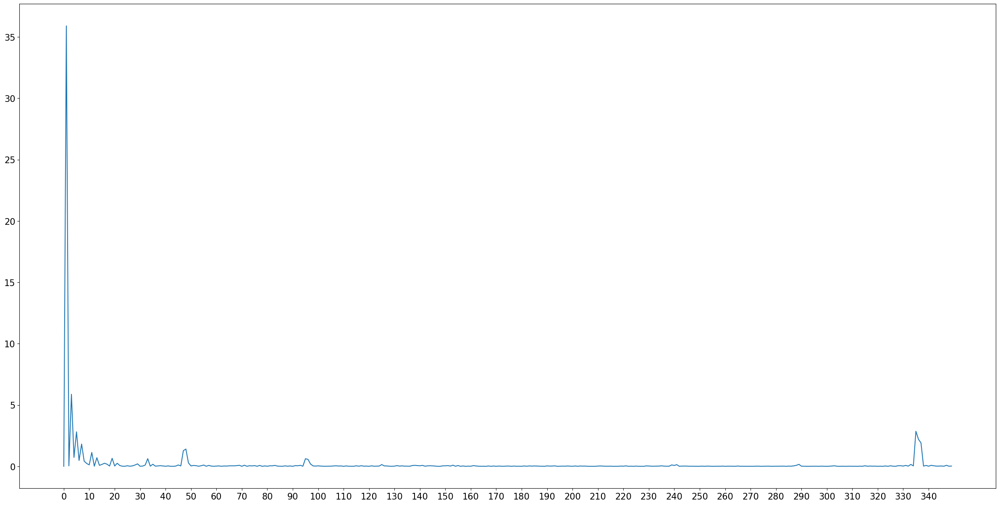

In [801]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[0:350], P_den[0:350])
plt.xticks(np.arange(0, 350, step=10))
plt.show()

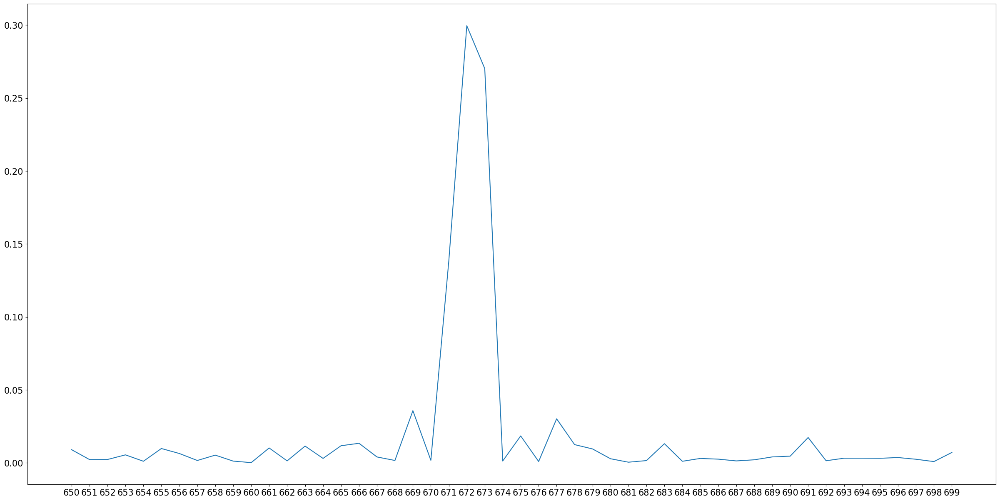

In [802]:
F, P_den = signal.periodogram(resid[0:8064],8064)
#F: muestras de frecuencias
#P_den: densidad espectral de potencia.
plt.plot(F[650:700], P_den[650:700])
plt.xticks(np.arange(650, 700, step=1))
plt.show()

El periodograma es muy diferente al de la serie original. Solo la frecuencia en 336 que representa el período de 24 horas y la frecuencia en 1 que representa el período anual sobrevivieron. No obstante, la primera, disminuyó mucho en intensidad.

1- Hay una frecuencia en 1 -> 8064(n)/1(f)=8064(T). El período es de 8064 horas (1 año).

2- Hay una frecuencia en 336 -> 8064(n)/336(f)=24(T). El período es de 24 horas (1 día).

Pareciera que la serie se deforma aplicando la resta de la tendencia cíclica semestral.

##### Conclusiones

Se puede notar como la curva de estimación es mayor que la observada en los primeros períodos, pero menor en los últimos. Esto se debe a que el tránsito aumenta a lo largo del tiempo. Esto sucede porque la media no es constante a lo largo del tiempo, sino que va aumentando. Por lo tanto, el residuo no es estacionario. Además, la varianza continúa aumentando a medida lo hace el tiempo. Es decir, la varianza toma valores diferentes en distintos intervalos de la misma longitud, si se toma un intervalo al principio o al final del residuo.

Si observamos la autocorrelación, se ve la presencia de ciclos y que la serie no es estacionaria. Esto se confirma con el test KPSS. Incluso el periodograma sigue estableciendo diferentes ciclos, por ejemplo, diario. Además, en este caso se deforma, por lo cual para confirmar la tendencia serían necesarios más datos.

No obstante, el test DF indica que es estacionaria. Esto se debe a que probablemente haya que diferenciar.

Finalmente, se concluye que el residuo NO es ESTACIONARIO, pero además que se necesitan más datos para confirmar que hay una tendencia cíclica semestral presente. Por este motivo, se descarta de la conclusiones finales.

### Conclusiones finales comparando caso lineal y cíclico de 24 y 168 hs.

Si se resta la tendencia lineal o cíclica a la serie original, el residuo continúa siendo NO ESTACIONARIO. Eso se puede observar mirando el gráfico del residuo o la función de autocorrelación.

Si queremos avanzar en un análisis más detallado, podemos observar los test de DF y KPPS:
* En el caso de restar la tendencia lineal, ambos dan como resultado que la serie es estacionaria, lo que hace sospechar que hay que, por un lado diferenciar, y por otro, quitar la tendencia cíclica. 
* En el caso de restar la tendencia cíclica, independientemente de si se hace a 24 o 168 hs., DF da como resultado que es estacionaria, cuando en realidad no lo es, indicando nuevamente que es necesario diferenciar. Por otro lado, KPSS indica que no es estacionaria, lo que confirma la sospecha de que era necesario quitar la tendencia cíclica.


## Preprocesamiento

### Serie con preprocesamiento box-cox

Se utiliza la transformación de Box-Cox de sklearn.preprocessing y scipy.stats. Ambas eligen automáticamente el mejor lambda.

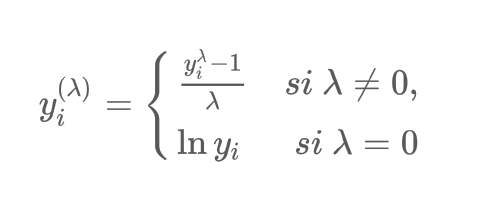

In [803]:
#Scipy
dataset_trasform_bc=stats.boxcox(dataset_Junction1['Vehicles'])
print ("El lambda es:", dataset_trasform_bc[1])

El lambda es: 0.23755533174941695


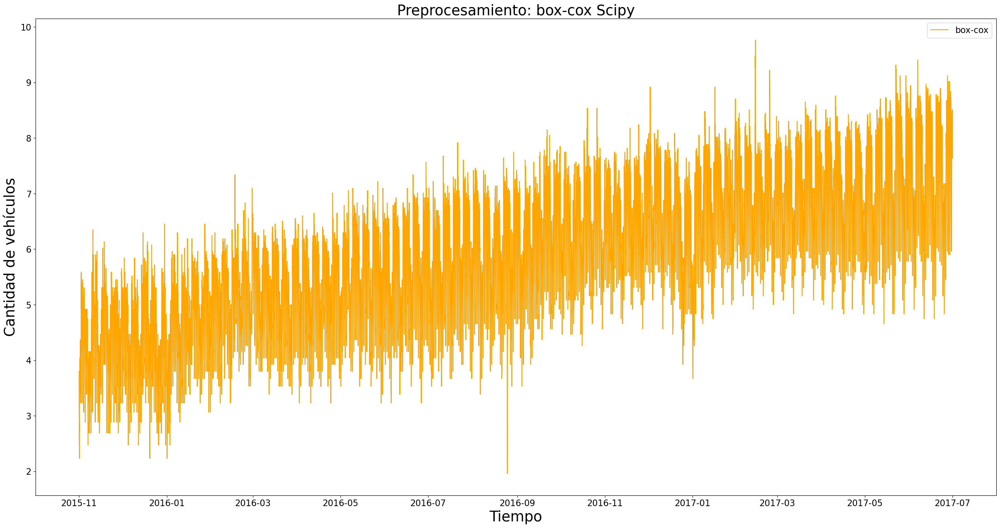

In [804]:
plt.plot(dataset_Junction1.index,dataset_trasform_bc[0],label='box-cox',color='orange')
plt.title("Preprocesamiento: box-cox Scipy")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

In [805]:
#Sklearn
bc = PowerTransformer(method='box-cox')
dataset_trasform_bc_2=bc.fit_transform(dataset_Junction1)
print ("El lambda es:", bc.lambdas_)

El lambda es: [0.23755533]


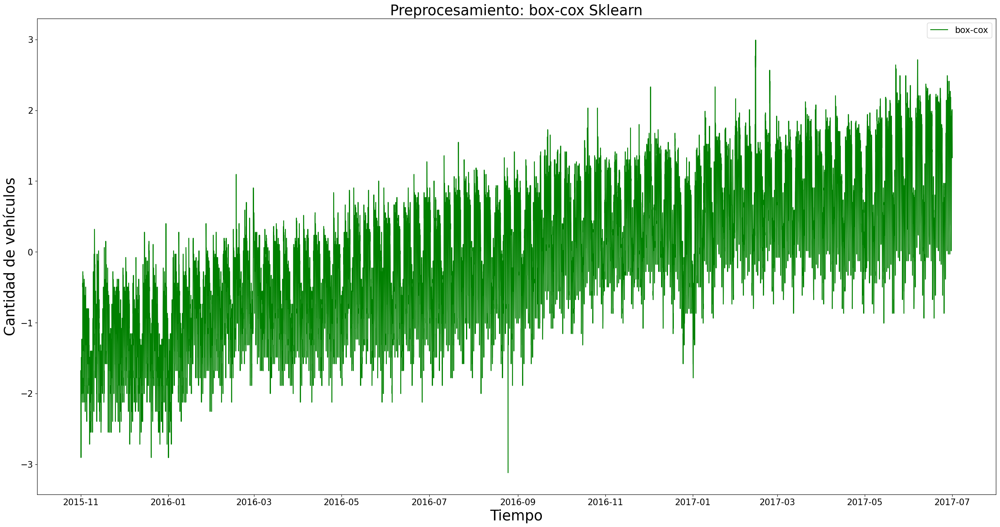

In [806]:
plt.plot(dataset_Junction1.index,dataset_trasform_bc_2,label='box-cox',color='green')
plt.title("Preprocesamiento: box-cox Sklearn")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

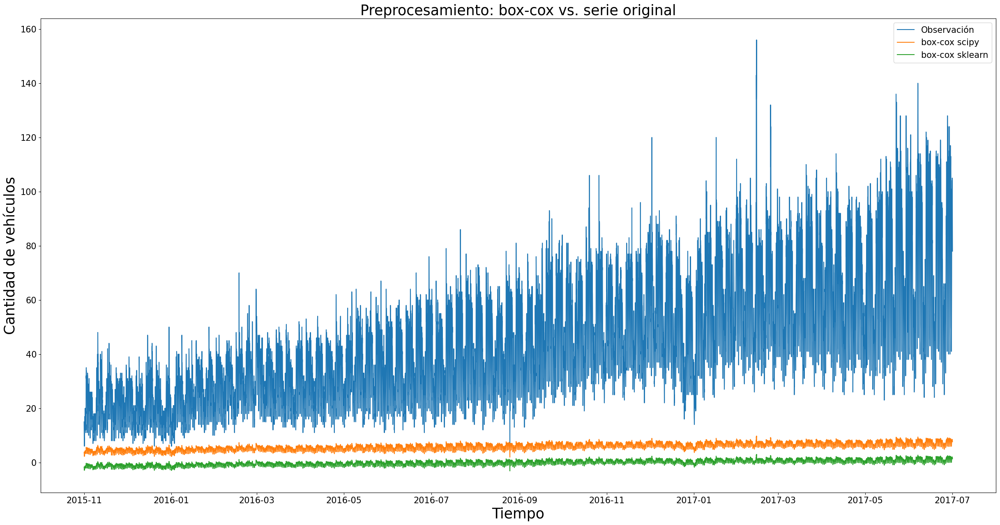

In [807]:
plt.plot(dataset_Junction1.index, dataset_Junction1['Vehicles'], label='Observación')
plt.plot(dataset_Junction1.index,dataset_trasform_bc[0],label='box-cox scipy')
plt.plot(dataset_Junction1.index,dataset_trasform_bc_2,label='box-cox sklearn')
plt.title("Preprocesamiento: box-cox vs. serie original")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

A partir de acá se utiliza solo el resultado luego aplicar box-cox de Scipy, porque con Sklearn se obtienen las mismas conclusiones. 

#### Autocorrelación

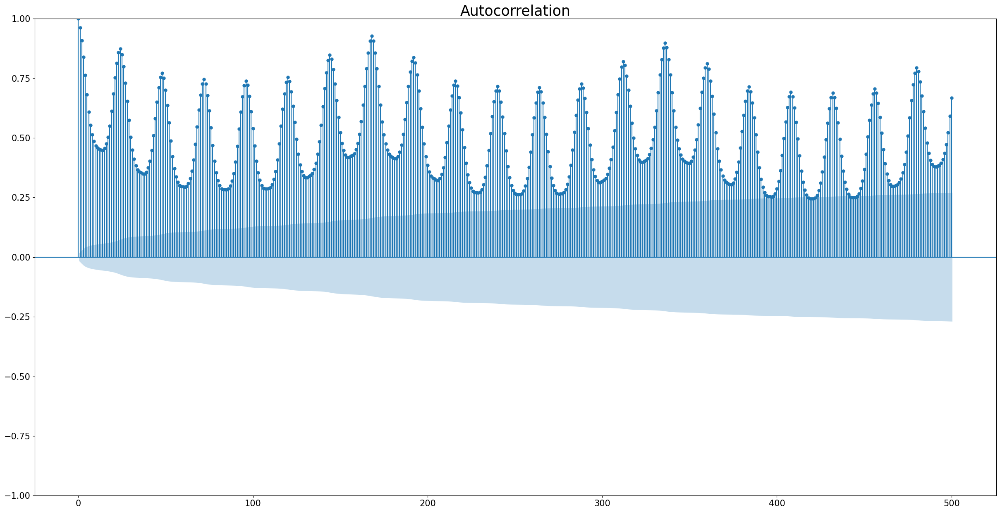

In [808]:
plot_acf(dataset_trasform_bc[0], lags=500)
plt.show()

##### Análisis del resultado

No cae exponencialmente. Además tiene ciclos. Por lo tanto, se sospecha que aunque se aplique box-cox continúa siendo NO estacionaria.

#### Autocorrelación parcial

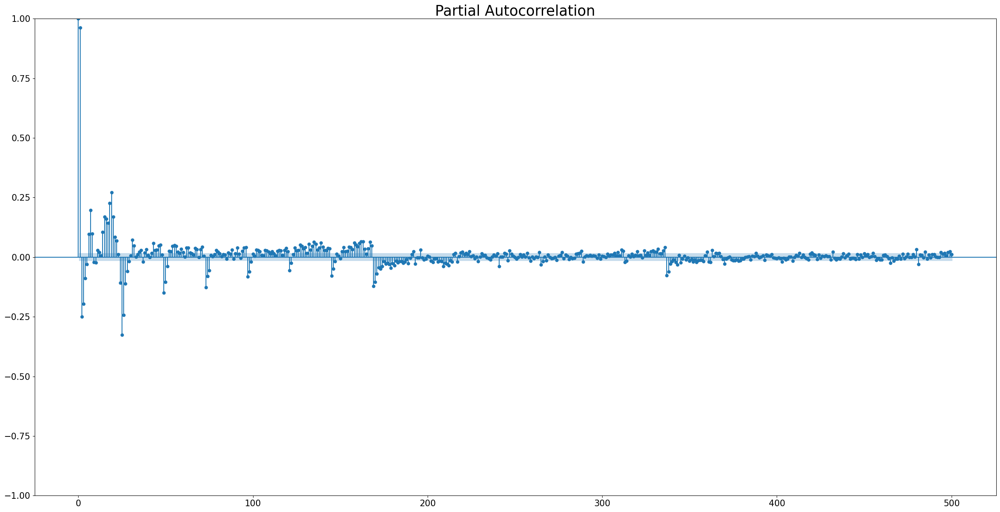

In [809]:
plot_pacf(dataset_trasform_bc[0], lags=500, method='ywm')
plt.show()

##### Análisis del resultado

Presenta ciclos.

#### Test Dickey-Fuller

In [810]:
adf_test(dataset_trasform_bc[0])

Resultados del test de Dickey-Fuller:
Estadístico              -6.413057e+00
p-valor                   1.870125e-08
# Lags usados             4.200000e+01
# Observaciones usadas    1.454900e+04
Valor del umbral (1%)    -3.430800e+00
Valor del umbral (5%)    -2.861739e+00
Valor del umbral (10%)   -2.566876e+00
dtype: float64


##### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA. Ahora bien, se sospecha que la que es estacionaria es la serie con preprocesamiento por box-cox diferenciada, ya que la serie con procesamiento por box-cox no tiene pinta de ser estacionaria.

#### Test KPSS

In [811]:
kpsstest = kpss_test(dataset_trasform_bc[0])

Results of KPSS Test:
Estadístico                 18.961118
p-valor                      0.010000
Lags usados                 66.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


##### Análisis del resultado

El estadístico es mayor al umbral en los 4 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es NO ESTACIONARIA.
Esto estaría confirmando que la serie con preprocesamiento por box-cox es no estacionaria.

#### Conclusiones

La serie con procesamiento box-cox NO es ESTACIONARIA, según se puede observar en el gráfico de autocorrelación y el gráfico de la serie. Más allá, que este último mejoró, en cuanto a su similitud a una serie estacionaria, porque se eliminó el aumento de la varianza a lo largo del tiempo. Además, el test KPSS confirma que no es estacionaria. No obstante, el test de DF indica que es estacionaria, por lo tanto se sospecha que la serie diferenciada, luego de aplicar box-cox lo es.

### Serie con preprocesamiento por diferenciación

In [812]:
#Función de diferenciación.
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return diff

#### A 1 hs.

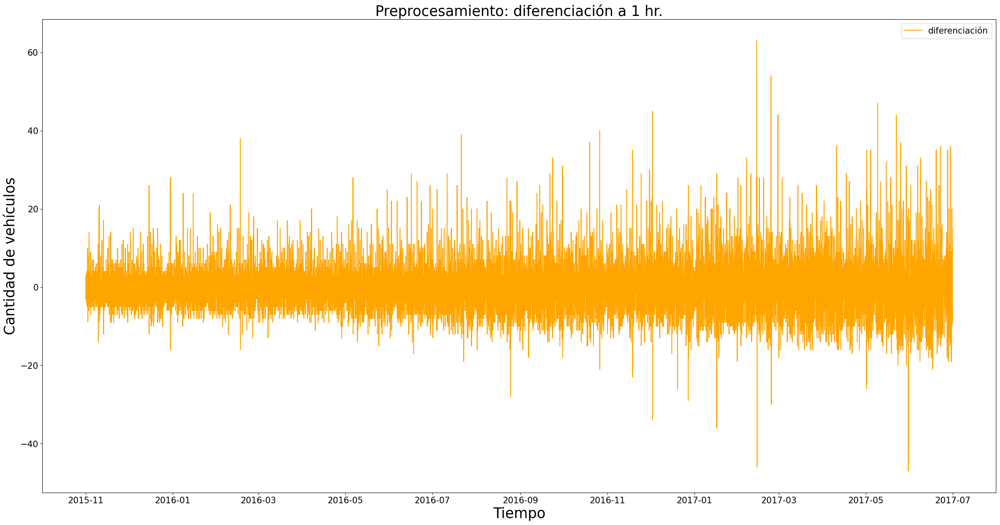

In [813]:
inter=1
#Diferenciación.
differ=difference(dataset_Junction1['Vehicles'],inter)
# print (len(differ))
# print (len(dataset_Junction1.index))
plt.plot(dataset_Junction1.index[inter:],differ,label='diferenciación',color='orange')
plt.title("Preprocesamiento: diferenciación a 1 hr.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

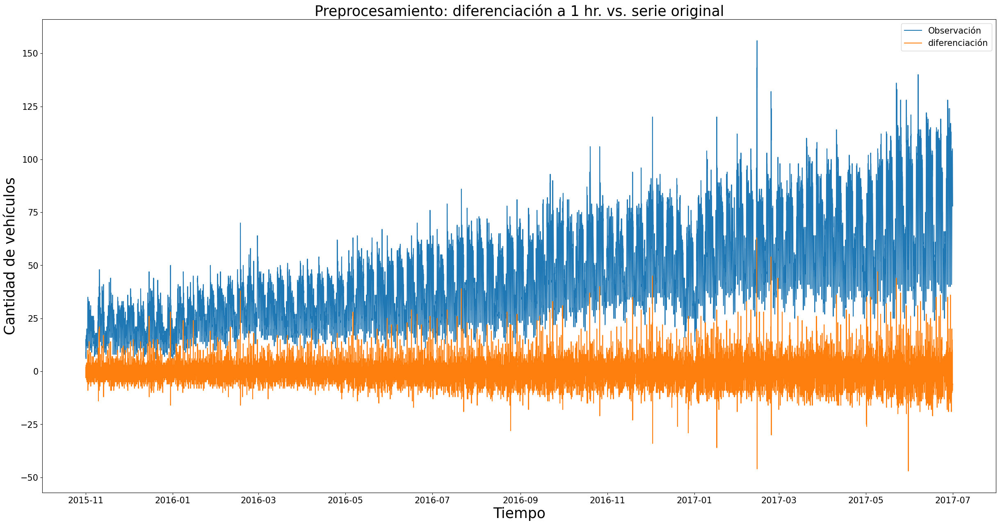

In [814]:
plt.plot(dataset_Junction1.index, dataset_Junction1['Vehicles'], label='Observación')
plt.plot(dataset_Junction1.index[inter:],differ,label='diferenciación')
plt.title("Preprocesamiento: diferenciación a 1 hr. vs. serie original")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

##### Autocorrelación

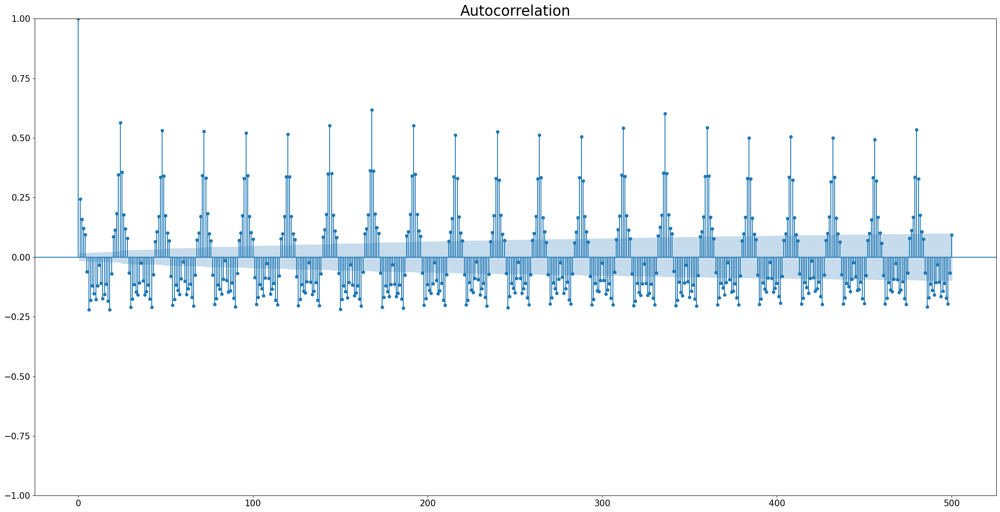

In [815]:
plot_acf(differ, lags=500)
plt.show()

###### Análisis del resultado

No cae exponencialmente, porque tiene ciclos. Por lo tanto, se sospecha que aunque se aplique diferenciación, continúa siendo NO estacionaria.

##### Autocorrelación parcial

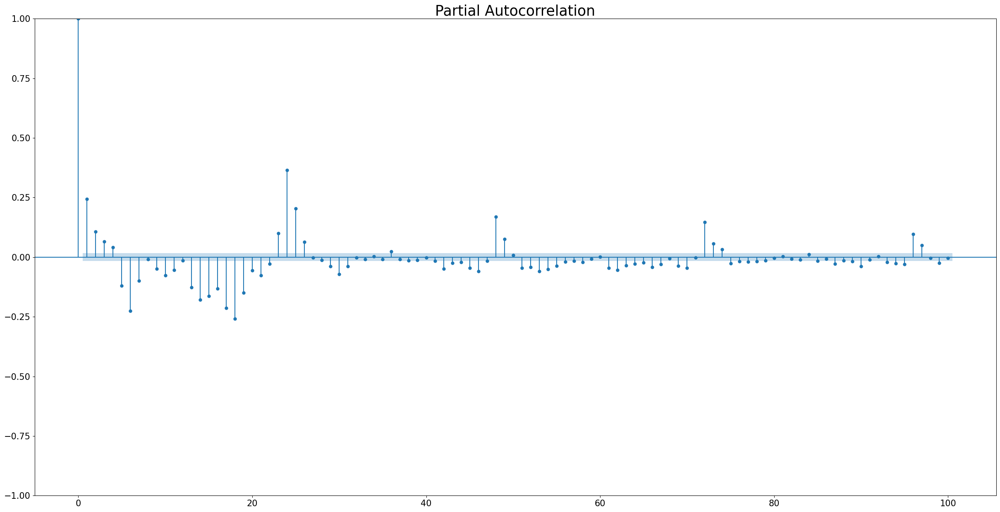

In [816]:
differ_np=np.array(differ)
#plot_pacf no procesa listas, por lo tanto differ se convierte a array de numpy.
plot_pacf(differ_np, lags=100, method='ywm')
plt.show()

###### Análisis del resultado

Presenta ciclos.

##### Test Dickey-Fuller

In [817]:
adf_test(differ)

Resultados del test de Dickey-Fuller:
Estadístico                 -21.997598
p-valor                       0.000000
# Lags usados                42.000000
# Observaciones usadas    14548.000000
Valor del umbral (1%)        -3.430800
Valor del umbral (5%)        -2.861739
Valor del umbral (10%)       -2.566876
dtype: float64


###### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA.

##### Test KPSS

In [818]:
kpsstest = kpss_test(differ)

Results of KPSS Test:
Estadístico                  0.002137
p-valor                      0.100000
Lags usados                 78.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


###### Análisis del resultado

El estadístico es menor al umbral en los 4 casos, por lo tanto NO puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy grande. En consecuencia, según esto es ESTACIONARIA.
Por lo tanto, ahora sí los dos test me indican que la serie es estacionaria.

#### A 24 hs.

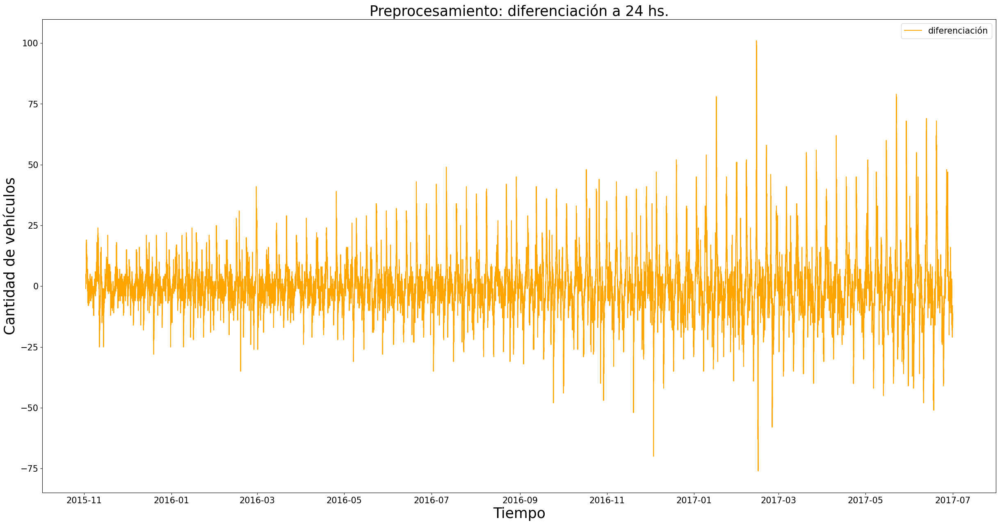

In [819]:
inter=24
#Diferenciación.
differ=difference(dataset_Junction1['Vehicles'],inter)
# print (len(differ))
# print (len(dataset_Junction1.index))
plt.plot(dataset_Junction1.index[inter:],differ,label='diferenciación',color='orange')
plt.title("Preprocesamiento: diferenciación a 24 hs.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

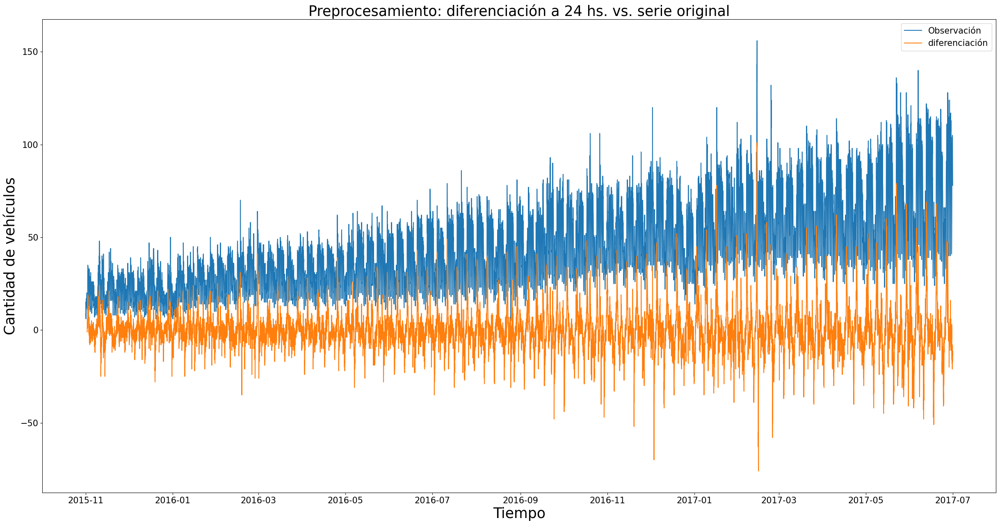

In [820]:
plt.plot(dataset_Junction1.index, dataset_Junction1['Vehicles'], label='Observación')
plt.plot(dataset_Junction1.index[inter:],differ,label='diferenciación')
plt.title("Preprocesamiento: diferenciación a 24 hs. vs. serie original")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

##### Autocorrelación

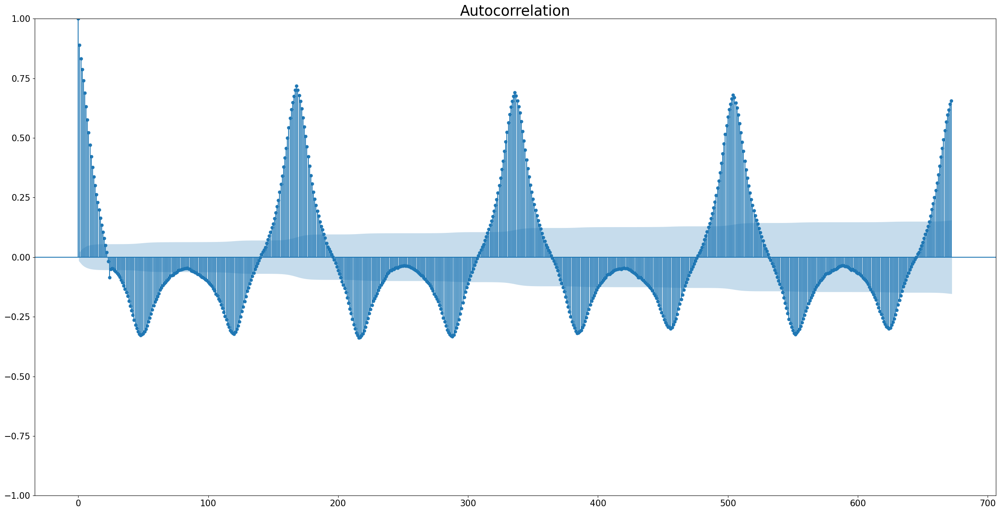

In [821]:
plot_acf(differ, lags=672)
plt.show()

###### Análisis del resultado

No cae exponencialmente, porque tiene ciclos. Por lo tanto, se sospecha que aunque se aplique diferenciación, continúa siendo NO estacionaria.

##### Autocorrelación parcial

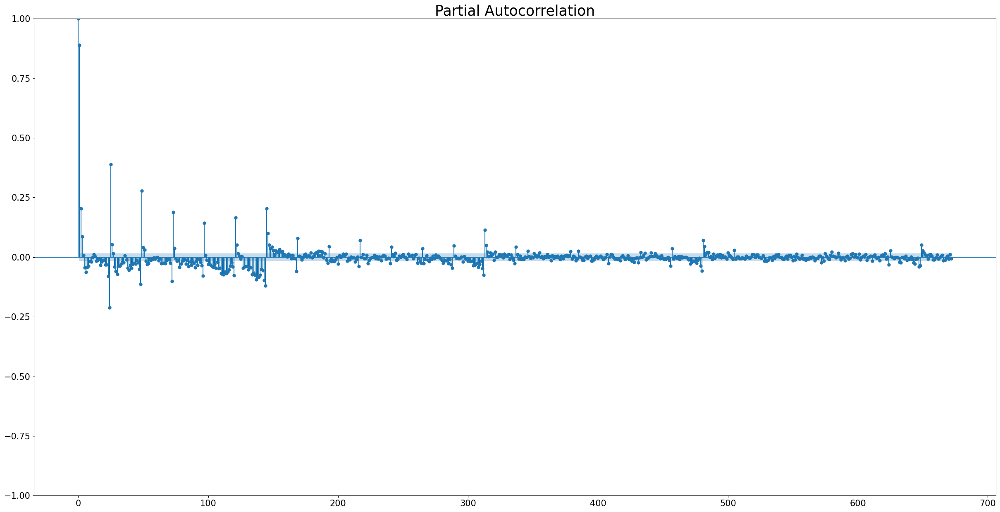

In [822]:
differ_np=np.array(differ)
#plot_pacf no procesa listas, por lo tanto differ se convierte a array de numpy.
plot_pacf(differ_np, lags=672, method='ywm')
plt.show()

###### Análisis del resultado

Presenta ciclos.

##### Test Dickey-Fuller

In [823]:
adf_test(differ)

Resultados del test de Dickey-Fuller:
Estadístico                 -23.432946
p-valor                       0.000000
# Lags usados                42.000000
# Observaciones usadas    14525.000000
Valor del umbral (1%)        -3.430800
Valor del umbral (5%)        -2.861739
Valor del umbral (10%)       -2.566876
dtype: float64


###### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA.

##### Test KPSS

In [824]:
kpsstest = kpss_test(differ)

Results of KPSS Test:
Estadístico                  0.00189
p-valor                      0.10000
Lags usados                 67.00000
Valor del umbrarl (10%)      0.34700
Valor del umbrarl (5%)       0.46300
Valor del umbrarl (2.5%)     0.57400
Valor del umbrarl (1%)       0.73900
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


###### Análisis del resultado

El estadístico es menor al umbral en los 4 casos, por lo tanto NO puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy grande. En consecuencia, según esto es ESTACIONARIA.
Por lo tanto, ahora sí los dos test me indican que la serie es estacionaria.

#### A 168 hs (una semana).

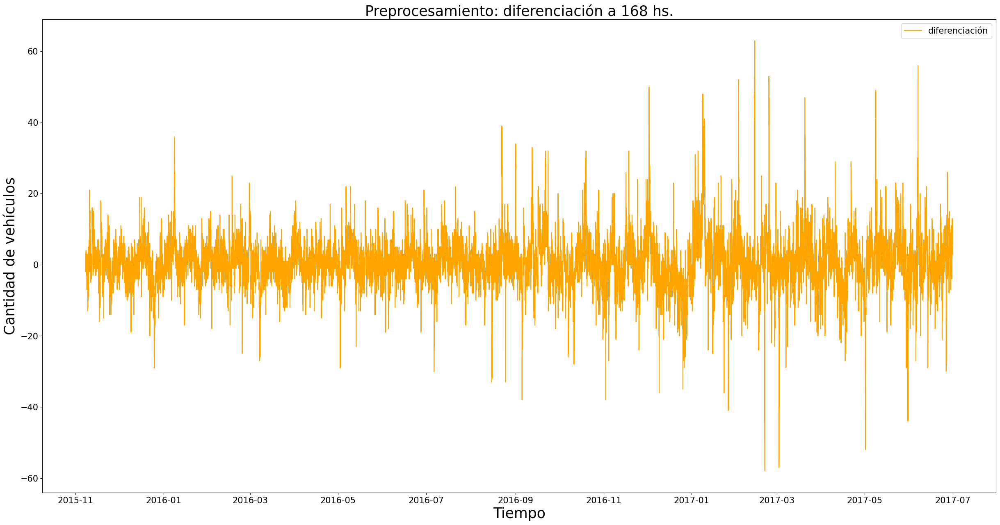

In [825]:
inter=168
#Diferenciación.
differ=difference(dataset_Junction1['Vehicles'],inter)
# print (len(differ))
# print (len(dataset_Junction1.index))
plt.plot(dataset_Junction1.index[inter:],differ,label='diferenciación',color='orange')
plt.title("Preprocesamiento: diferenciación a 168 hs.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

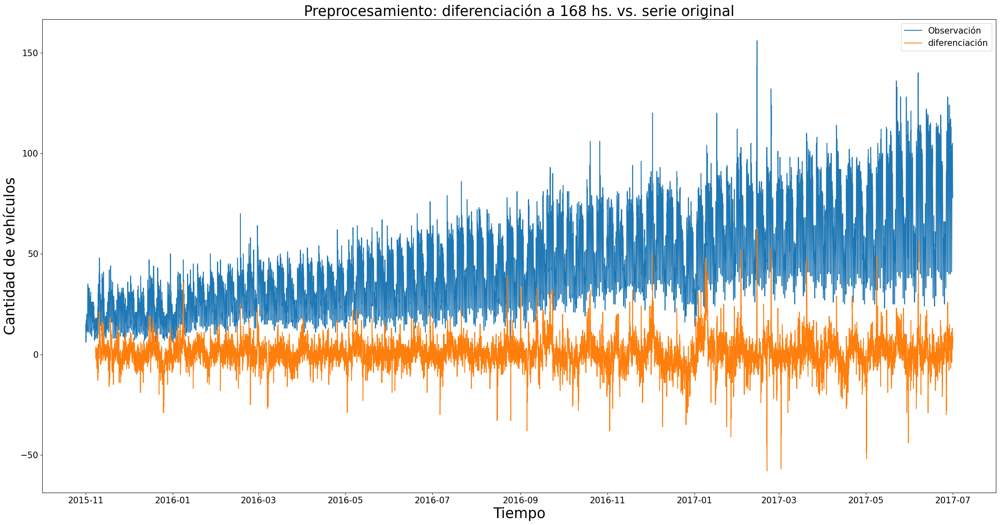

In [826]:
plt.plot(dataset_Junction1.index, dataset_Junction1['Vehicles'], label='Observación')
plt.plot(dataset_Junction1.index[inter:],differ,label='diferenciación')
plt.title("Preprocesamiento: diferenciación a 168 hs. vs. serie original")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

##### Autocorrelación

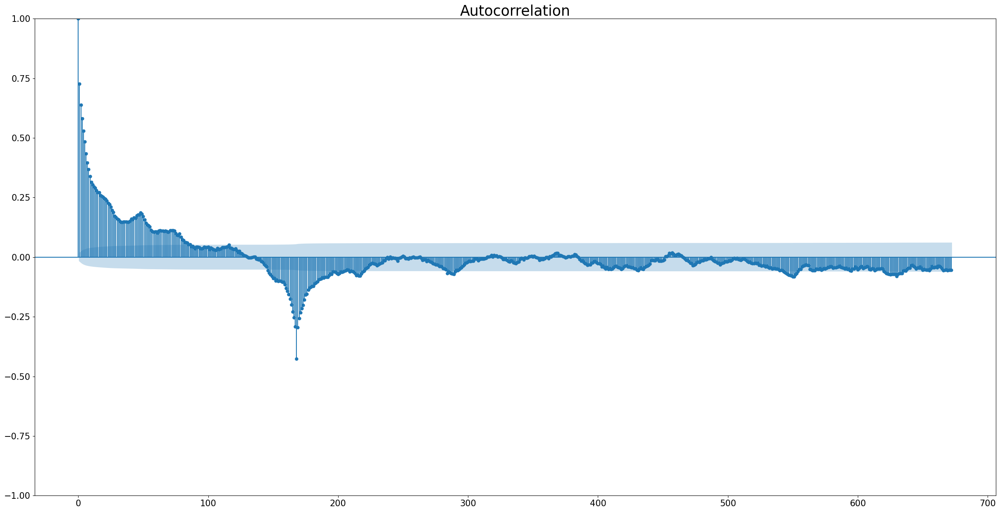

In [827]:
plot_acf(differ, lags=672)
#Observo a 4 semanas.
plt.show()

###### Análisis del resultado

A pesar que continúa teniendo ciclos, tiene una cierta caída exponencial. Por lo tanto, se sospecha que podría ser estacionaria.

##### Autocorrelación parcial

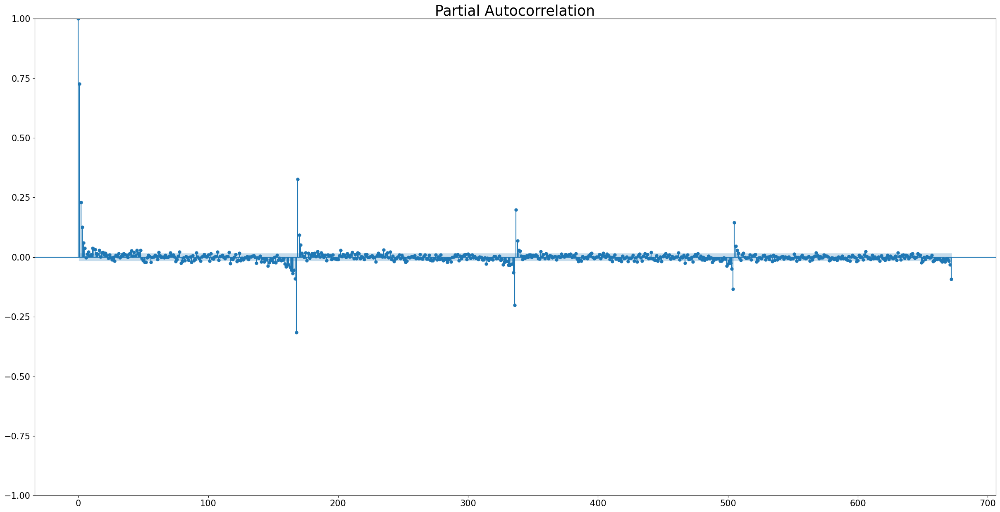

In [828]:
differ_np=np.array(differ)
#plot_pacf no procesa listas, por lo tanto differ se convierte a array de numpy.
plot_pacf(differ_np, lags=672, method='ywm')
plt.show()

###### Análisis del resultado

Presenta ciclos.

##### Test Dickey-Fuller

In [829]:
adf_test(differ)

Resultados del test de Dickey-Fuller:
Estadístico              -1.526530e+01
p-valor                   4.798540e-28
# Lags usados             2.000000e+01
# Observaciones usadas    1.440300e+04
Valor del umbral (1%)    -3.430804e+00
Valor del umbral (5%)    -2.861741e+00
Valor del umbral (10%)   -2.566877e+00
dtype: float64


###### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA.

##### Test KPSS

In [830]:
kpsstest = kpss_test(differ)

Results of KPSS Test:
Estadístico                  0.019635
p-valor                      0.100000
Lags usados                 65.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


###### Análisis del resultado

El estadístico es menor al umbral en los 4 casos, por lo tanto NO puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy grande. En consecuencia, según esto es ESTACIONARIA.
Por lo tanto, ahora sí los dos test me indican que la serie es estacionaria.

#### Conclusiones

Si se diferencia a 1, 24 o 168 hs. y se observa el gráfico de la serie diferenciada, se ve claramente que NO es ESTACIONARIA, porque la varianza se modifica a lo largo del tiempo.

Observando el gráfico de autocorrelación, a 1 o 24 hs. claramente NO es estacionaria, sin embargo, en el de 168 hs. tiene una cierta caída exponencial.

Si queremos avanzar en un análisis más detallado, podemos observar los test de DF y KPPS, ambos dan como resultado que la serie es estacionaria. 

Se concluye que NO son ESTACIONARIAS.

## Combinación de preprocesamientos y tendencias

De todos los procesamientos y tendencias analizados en forma individual se busca una combinación que permita obtener una serie estacionaria.

### 1 - Aplicar preprocesamiento box-cox

El objetivo es lograr que la varianza sea más pareja a lo largo del tiempo, lo que acerca la serie a algo estacionario. En realidad, en dos intervalos de tiempos de la misma longitud la varianza será diferente, pero se logrará que ese aumento que había en la varianza a medida que avanza el tiempo no ocurra.

Se utiliza la transformación de Box-Cox de scipy.stats, que elige automaticamente el mejor lambda.

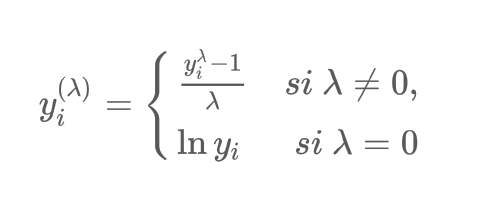

In [831]:
#Scipy
dataset_trasform_bc=stats.boxcox(dataset_Junction1['Vehicles'])
print ("El lambda es:", dataset_trasform_bc[1])

El lambda es: 0.23755533174941695


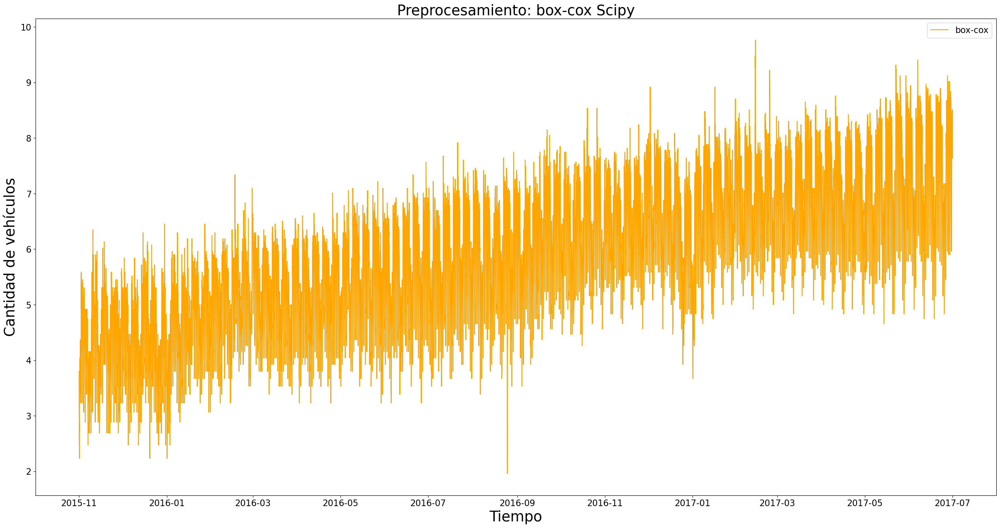

In [832]:
parameters = {'axes.labelsize': 25,
              'axes.titlesize': 25,
              'figure.figsize': (30,15),
              'xtick.labelsize': 15,
              'ytick.labelsize': 15,
              'legend.fontsize': 15}
plt.rcParams.update(parameters)
plt.plot(dataset_Junction1.index,dataset_trasform_bc[0],label='box-cox',color='orange')
plt.title("Preprocesamiento: box-cox Scipy")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

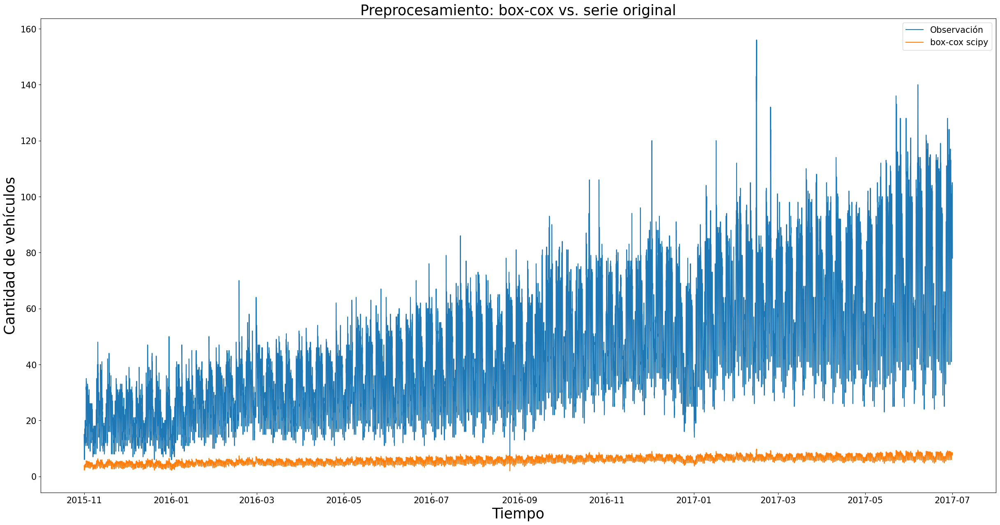

In [833]:
plt.plot(dataset_Junction1.index, dataset_Junction1['Vehicles'], label='Observación')
plt.plot(dataset_Junction1.index,dataset_trasform_bc[0],label='box-cox scipy')
plt.title("Preprocesamiento: box-cox vs. serie original")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Autocorrelación

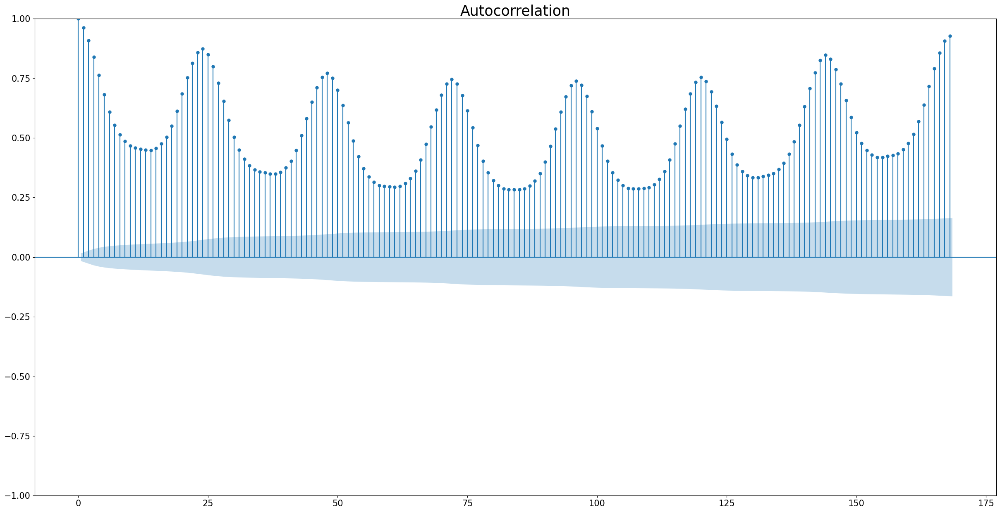

In [834]:
plot_acf(dataset_trasform_bc[0], lags=168)
plt.show()

##### Análisis del resultado

No cae exponencialmente. Además tiene ciclos. Por lo tanto, se sospecha que aunque se aplique box-cox continúa siendo NO estacionaria.

No puedo calcular el orden del modelo MA.

#### Autocorrelación parcial

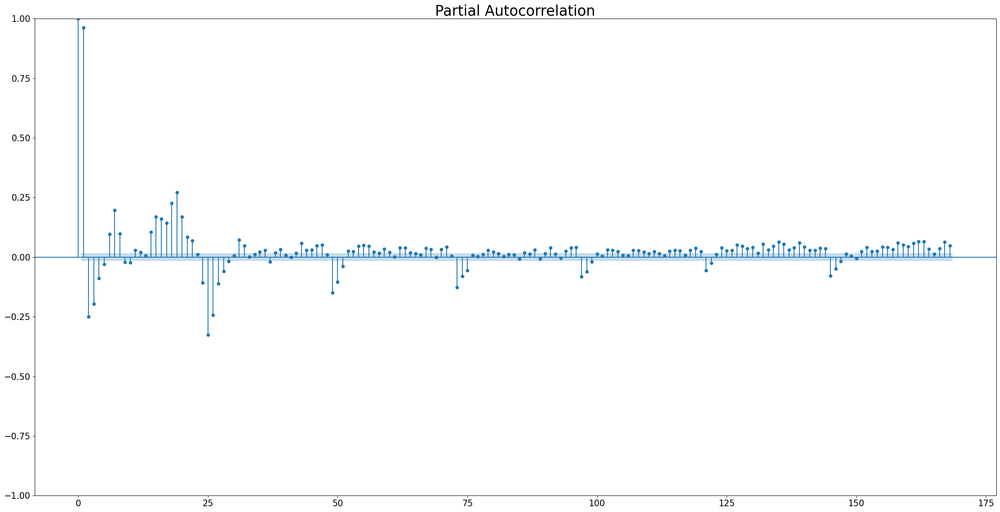

In [835]:
plot_pacf(dataset_trasform_bc[0],lags=168, method='ywm')
plt.show()

##### Análisis del resultado

No puedo calcular el orden del modelo AR.

#### Test Dickey-Fuller

In [836]:
adf_test(dataset_trasform_bc[0])

Resultados del test de Dickey-Fuller:
Estadístico              -6.413057e+00
p-valor                   1.870125e-08
# Lags usados             4.200000e+01
# Observaciones usadas    1.454900e+04
Valor del umbral (1%)    -3.430800e+00
Valor del umbral (5%)    -2.861739e+00
Valor del umbral (10%)   -2.566876e+00
dtype: float64


##### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA. Ahora bien, se sospecha que la que es estacionaria es la serie con preprocesamiento por box-cox diferenciada, ya que la serie con procesamiento por box-cox no tiene pinta de ser estacionaria.

#### Test KPSS

In [837]:
kpsstest = kpss_test(dataset_trasform_bc[0])

Results of KPSS Test:
Estadístico                 18.961118
p-valor                      0.010000
Lags usados                 66.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


##### Análisis del resultado

El estadístico es mayor al umbral en los 4 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es NO ESTACIONARIA.
Esto estaría confirmando que la serie con preprocesamiento por box-cox es no estacionaria.

#### Conclusiones

La serie con procesamiento box-cox NO es ESTACIONARIA, según se puede observar en el gráfico de autocorrelación y el gráfico de la serie. Más allá, que este último mejoró, en cuanto a su similitud a una serie estacionaria, porque se eliminó el aumento de la varianza a lo largo del tiempo. Además, el test KPSS confirma que no es estacionaria. No obstante, el test de DF indica que es estacionaria, por lo tanto se sospecha que la serie diferenciada, luego de aplicar box-cox lo es.

### 2 - Restar la tendencia determinística del período de 168 hs.

El objetivo es quedarse solamente con el período de 24 hs., ya que el modelo SARIMA solo puede procesar un período, y en este caso existen dos: diario y semanal.

In [838]:
#Determino un período de 168 hs.
period_168=168
#Cálculo de los parámetros de la observación por cuadrados mínimos.
data_graphic_real_168=np.array(dataset_trasform_bc[0])
rows_168=int(len(dataset_trasform_bc[0])/period_168)
data_array=np.array(dataset_trasform_bc[0])
#Se descartan los primeros datos, porque no completan un período.
cant_data=rows_168*period_168
start=len(dataset_Junction1)-cant_data
data_168=data_array[start:].reshape(rows_168,period_168)
print ("Cantidad de períodos:",data_168.shape[0])
betas_168=data_168.mean(axis=0)
print ("Parámetros estimados (betas):\n",betas_168)

Cantidad de períodos: 86
Parámetros estimados (betas):
 [6.01083181 5.65530264 5.27244148 4.90947079 4.59351918 4.3519734
 4.3684631  4.56581346 4.79726945 5.11894063 5.59434925 5.68208975
 5.64368434 5.46683007 5.43965534 5.41579865 5.40955646 5.42695216
 5.6332008  5.89627587 5.95243392 5.83998813 5.85727266 5.75256552
 5.53032981 5.13836877 4.77753677 4.52645842 4.28849922 4.14385728
 4.22870523 4.42139466 4.65392418 5.07798571 5.37961545 5.49790387
 5.53767502 5.42211177 5.3695642  5.37236043 5.36423371 5.46810496
 5.76151057 6.009366   5.9989051  5.92819988 5.94625136 5.88867216
 5.6824273  5.2977761  4.96810947 4.79694266 4.58711931 4.56821168
 4.80323016 5.15437368 5.42214192 5.92879083 6.64989686 7.10658724
 7.12695072 6.78797053 7.01610433 6.99049863 6.83500768 6.83789507
 6.96541244 7.111661   7.01892131 6.86012485 6.75652963 6.59996961
 6.34990394 5.99999035 5.68942707 5.30555844 5.00269768 4.84767252
 5.09466712 5.36027515 5.59154765 5.99137009 6.63731742 6.9456944
 7.03469

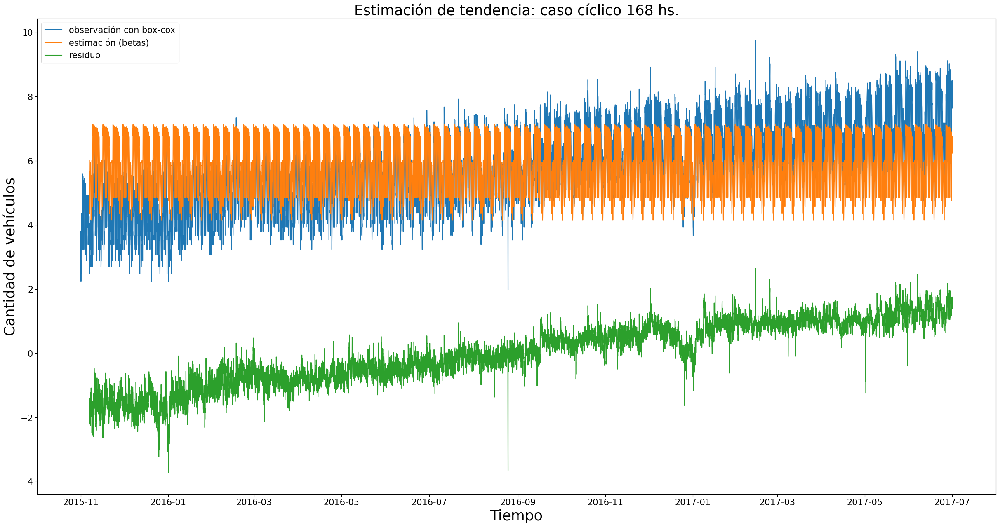

In [839]:
#Se muestra a lo largo de toda la serie.
est_168=np.tile(betas_168,rows_168)
# Plotea todas las observaciones (valor real).
plt.plot(dataset_Junction1.index,data_graphic_real_168,label='observación con box-cox')
# Plotea las estimaciones de las observaciones.
plt.plot(dataset_Junction1[start:].index,est_168,label='estimación (betas)')
# Plotea la diferencia entre el valor real y el estimado.
# Para el valor real solo se tienen en cuenta las observaciones, que tienen
# su correspondiente estimación. Es decir, se descartan las primeras, porque
# no llegan a completar un período de 168 horas.
resid=data_graphic_real_168[start:]-est_168
plt.plot(dataset_Junction1[start:].index,resid,label='residuo')
plt.title("Estimación de tendencia: caso cíclico 168 hs.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Autocorrelación

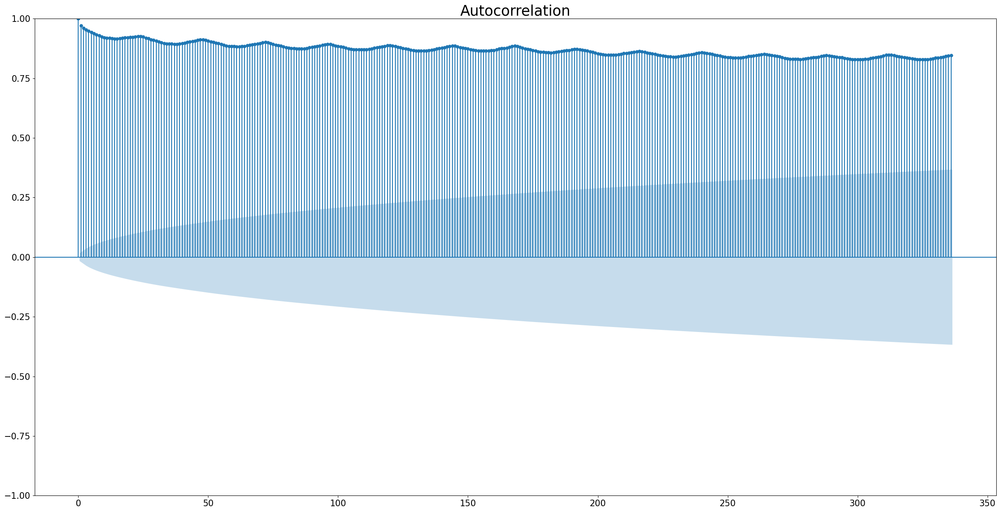

In [840]:
plot_acf(resid, lags=336)
# 336 hs. = 14 días.
plt.show()

##### Análisis del resultado

No cae exponencialmente. Además tiene ciclos. Por lo tanto, se sospecha que aunque se reste la tendencia cíclica de 168 hs. continúa siendo NO estacionaria. No obstante, se observa que los ciclos son a 24 hs. Por lo tanto, pudimos deshacernos del ciclo de 168 hs. (1 semana).

#### Autocorrelación parcial

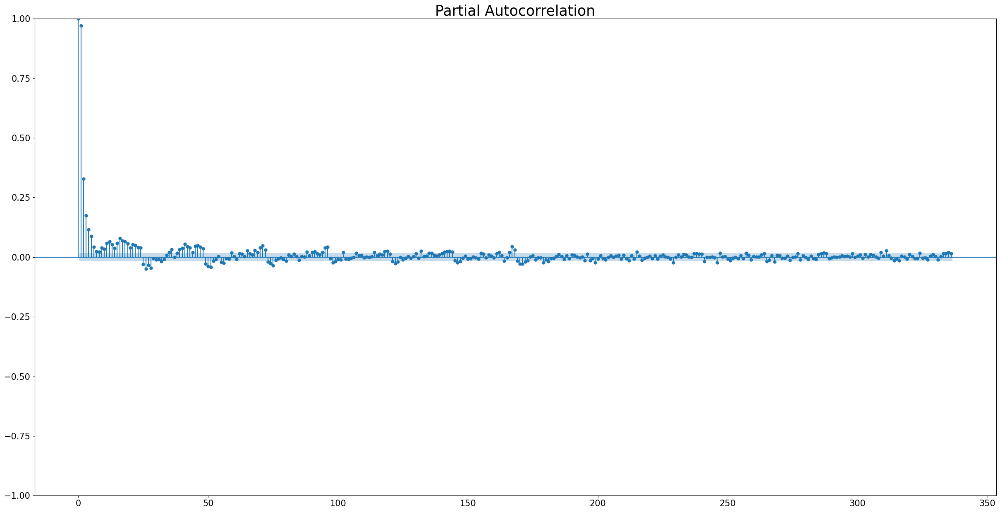

In [841]:
plot_pacf(resid, lags=336, method='ywm')
plt.show()

##### Análisis del resultado

Se continúa visualizando ciclos cada 24 lags.

#### Test Dickey-Fuller

In [842]:
adf_test(resid)

Resultados del test de Dickey-Fuller:
Estadístico                  -2.337909
p-valor                       0.160033
# Lags usados                42.000000
# Observaciones usadas    14405.000000
Valor del umbral (1%)        -3.430804
Valor del umbral (5%)        -2.861741
Valor del umbral (10%)       -2.566877
dtype: float64


##### Análisis del resultado

El estadístico es mayor al umbral en los 3 casos, por lo tanto no puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es grande. En consecuencia, según esto es NO ESTACIONARIA.

#### Test KPSS

In [843]:
kpsstest = kpss_test(resid)

Results of KPSS Test:
Estadístico                 18.899268
p-valor                      0.010000
Lags usados                 72.000000
Valor del umbrarl (10%)      0.347000
Valor del umbrarl (5%)       0.463000
Valor del umbrarl (2.5%)     0.574000
Valor del umbrarl (1%)       0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


##### Análisis del resultado

El estadístico es mayor al umbral en los 4 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es NO ESTACIONARIA.

#### Conclusiones

Se puede notar como la curva de estimación es mayor que la observada en los primeros períodos, pero menor en los últimos. Esto se debe a que el tránsito aumenta a lo largo del tiempo. Esto sucede porque la media no es constante a lo largo del tiempo, sino que va aumentando. Por lo tanto, el residuo no es estacionario. Además, la varianza toma valores diferentes en distintos intervalos de la misma longitud específicos (a la noche y a la mañana, por ejemplo).

Si observamos la autocorrelación, se ve la presencia de ciclos, por lo tanto, la serie no es estacionaria. Esto se confirma con el test KPSS y DF.

Finalmente, se concluye que el residuo (serie preprocesada por box-cox - tendencia cíclica a 168 hs) NO es ESTACIONARIO.

Por otro lado, en el gráfico de autocorrelación con lags 336 hs. (14 días) se observan 14 ciclos parejos. Por lo tanto, el comportamiento cíclico que se presenta es el diario, de manera tal, que se pudo restar exitosamente el comportamiento cíclico semanal de 168 hs. cumpliendo con el objetivo inicial. Esto se puede confirmar también, observando el gráfico de autocorrelación parcial, que muestra ciclos a 24 lags.

### 3 - Diferenciación a 24 hs.

El objetivo es lograr que la media sea constante a través del tiempo y finalmente alcanzar una serie estacionaria.

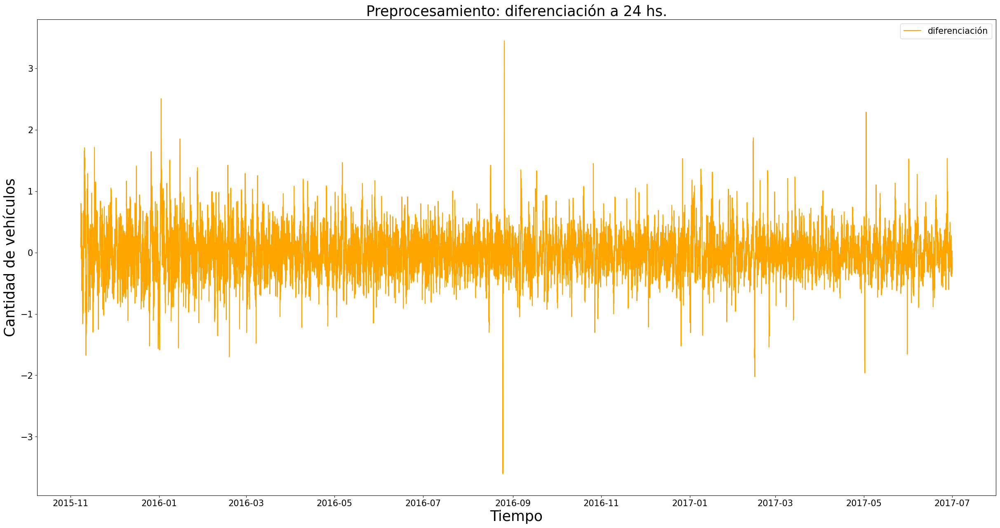

In [844]:
inter=24
#Diferenciación.
differ=difference(resid,inter)
# print (len(differ))
# print (len(resid))
plt.plot(dataset_Junction1.index[start+inter:],differ,label='diferenciación',color='orange')
plt.title("Preprocesamiento: diferenciación a 24 hs.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

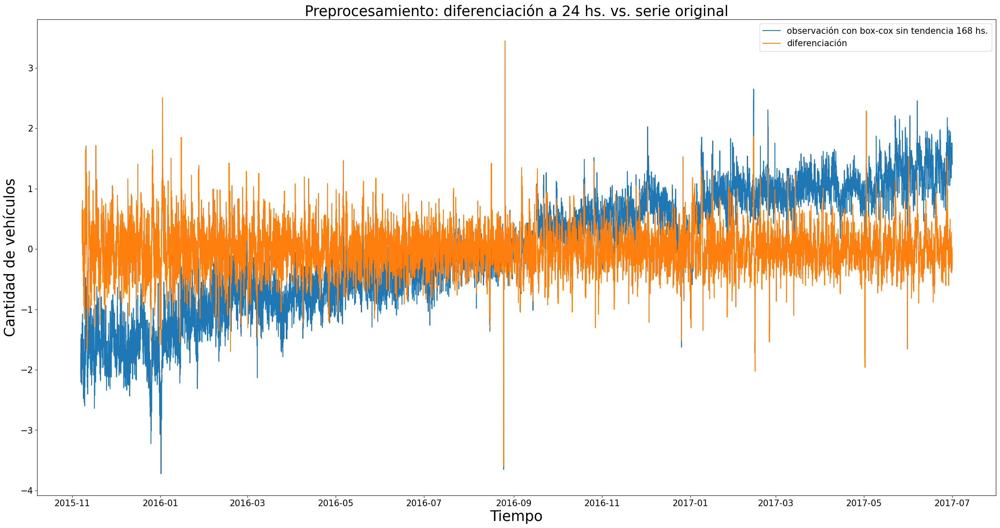

In [845]:
plt.plot(dataset_Junction1.index[start:], resid, label='observación con box-cox sin tendencia 168 hs.')
plt.plot(dataset_Junction1.index[start+inter:],differ,label='diferenciación')
plt.title("Preprocesamiento: diferenciación a 24 hs. vs. serie original")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Autocorrelación

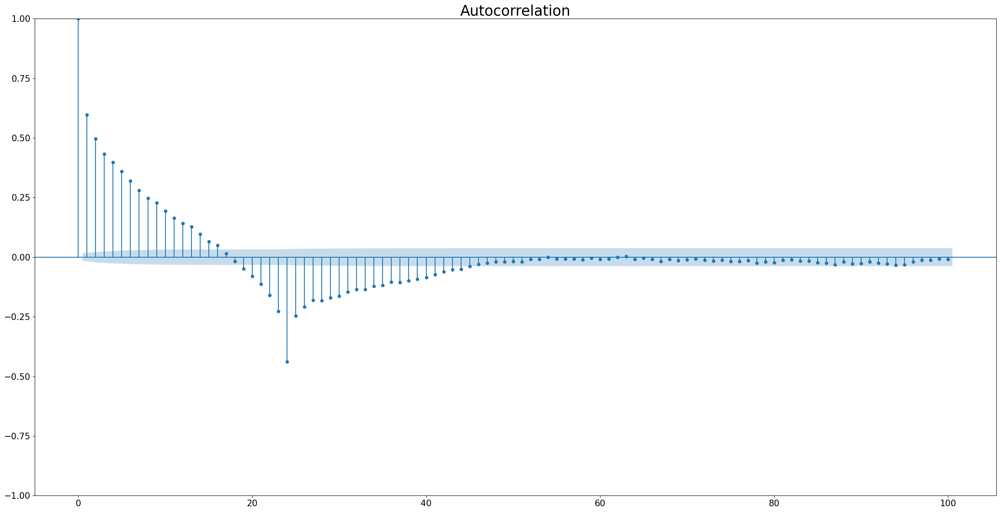

In [846]:
plot_acf(differ, lags=100)
plt.show()

##### Análisis del resultado

Tiene una cierta caida exponencial. Por lo tanto, se sospecha que es estacionaria.

Se puede calcular el orden del MA.

#### Autocorrelación parcial

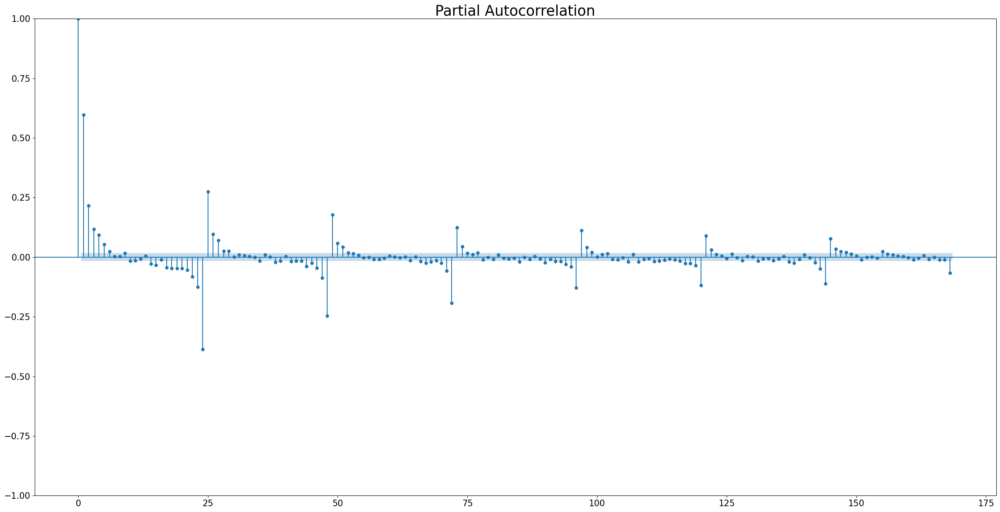

In [847]:
differ_np=np.array(differ)
#plot_pacf no procesa listas, por lo tanto differ se convierte a array de numpy.
plot_pacf(differ_np, lags=168, method='ywm')
plt.show()

##### Análisis del resultado

Se puede calcular el orden del modelo AR.

#### Test Dickey-Fuller

In [848]:
adf_test(differ)

Resultados del test de Dickey-Fuller:
Estadístico                 -20.306236
p-valor                       0.000000
# Lags usados                42.000000
# Observaciones usadas    14381.000000
Valor del umbral (1%)        -3.430805
Valor del umbral (5%)        -2.861741
Valor del umbral (10%)       -2.566877
dtype: float64


##### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA.

#### Test KPSS

In [849]:
kpsstest = kpss_test(differ)

Results of KPSS Test:
Estadístico                  0.00693
p-valor                      0.10000
Lags usados                 62.00000
Valor del umbrarl (10%)      0.34700
Valor del umbrarl (5%)       0.46300
Valor del umbrarl (2.5%)     0.57400
Valor del umbrarl (1%)       0.73900
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


##### Análisis del resultado

El estadístico es menor al umbral en los 4 casos, por lo tanto NO puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy grande. En consecuencia, según esto es ESTACIONARIA.
Por lo tanto, ahora sí los dos test me indican que la serie es estacionaria.

#### Conclusiones

Si se diferencia a 24 hs. y se observa el gráfico de la serie diferenciada, se ve claramente que no es estacionaria, porque la varianza es diferente en intervalos de tiempo de la misma longitud. No obstante, esto sucede porque tiene ciclos, lo que queremos conservar. Además, la media, ahora es constante a lo largo del tiempo.

Observando el gráfico de autocorrelación tiene una cierta caída exponencial, lo que podría indicar que es estacionaria, más allá de que tiene ciclos según se observa en el gráfico de autocorrelación parcial claramente.

Si queremos avanzar en un análisis más detallado, podemos observar los test de DF y KPPS, ambos dan como resultado que la serie es estacionaria. 

Se concluye que es ESTACIONARIA.

### 4 - Diferenciación a 1 hr.

El objetivo es disminuir el orden del modelo, es decir, la cantidad de parámetros.

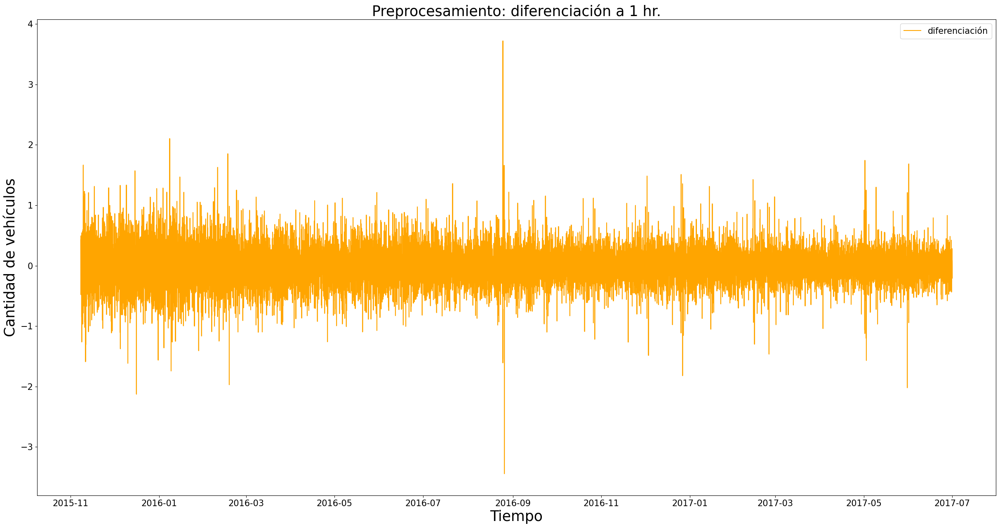

In [850]:
inter_2=1
#Diferenciación.
differ_2=difference(differ,inter_2)
# print (len(differ))
# print (len(resid))
plt.plot(dataset_Junction1.index[(start+inter+inter_2):],differ_2,label='diferenciación',color='orange')
plt.title("Preprocesamiento: diferenciación a 1 hr.")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

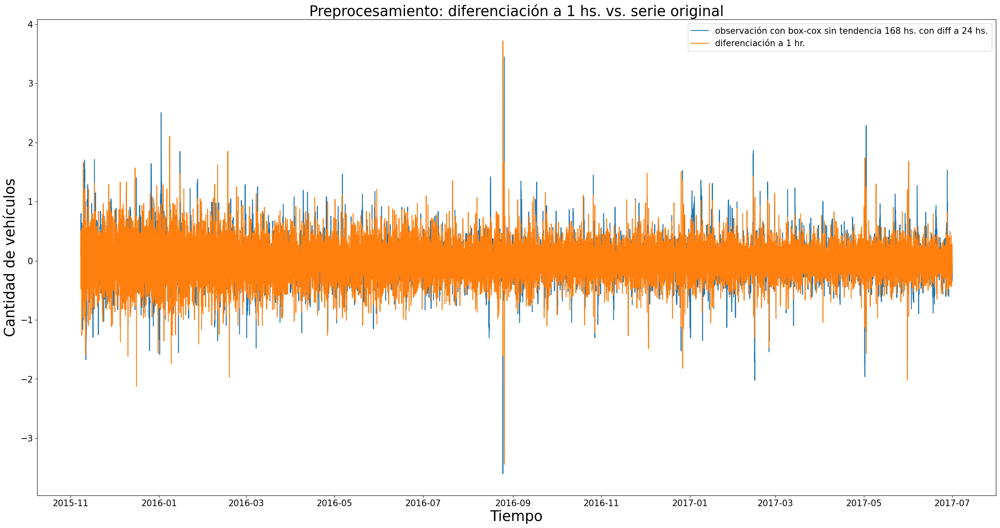

In [851]:
plt.plot(dataset_Junction1.index[start+inter:], differ, label='observación con box-cox sin tendencia 168 hs. con diff a 24 hs.')
plt.plot(dataset_Junction1.index[(start+inter+inter_2):],differ_2,label='diferenciación a 1 hr.')
plt.title("Preprocesamiento: diferenciación a 1 hs. vs. serie original")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Autocorrelación

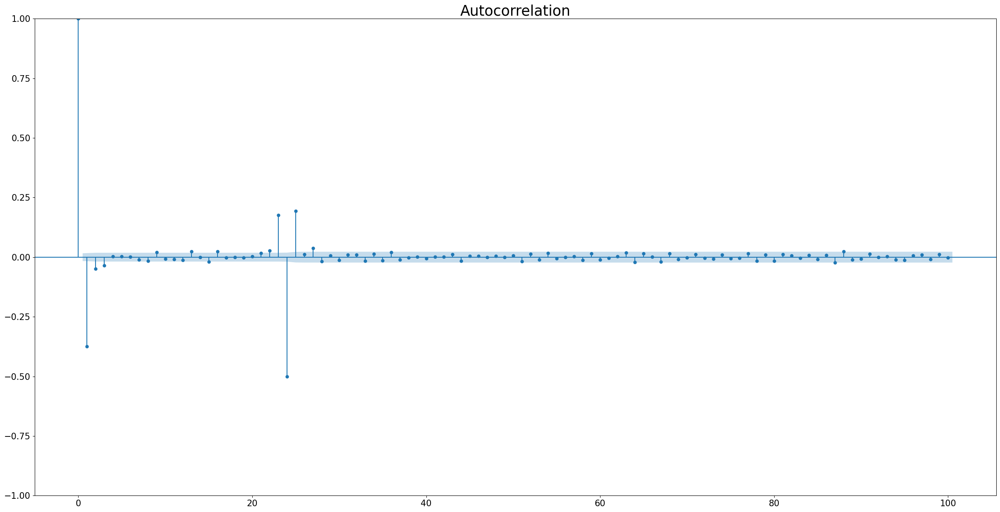

In [852]:
plot_acf(differ_2, lags=100)
plt.show()

##### Análisis del resultado

Tiene una caida exponencial. Por lo tanto, se sospecha que es estacionaria.

Se puede calcular el orden del modelo MA.

#### Autocorrelación parcial

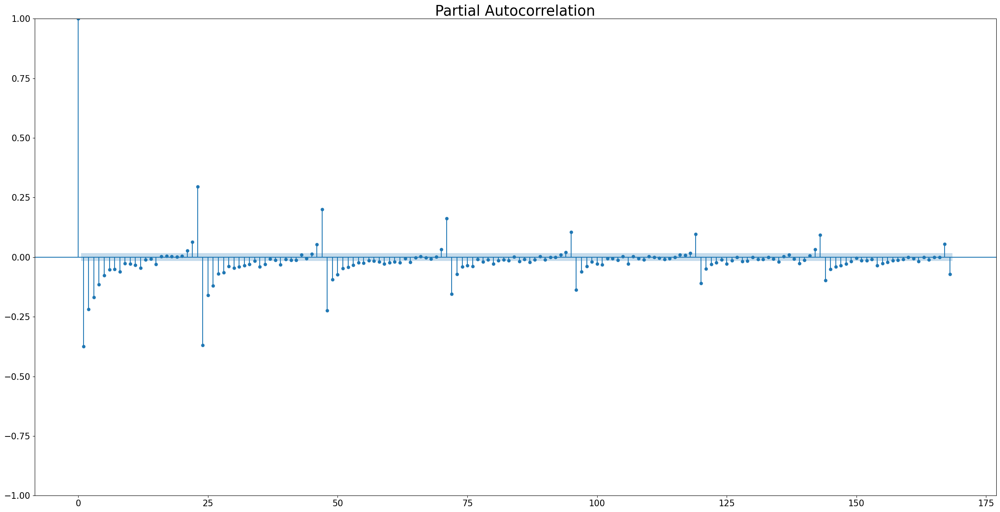

In [853]:
differ_np_2=np.array(differ_2)
#plot_pacf no procesa listas, por lo tanto differ se convierte a array de numpy.
plot_pacf(differ_np_2, lags=168, method='ywm')
plt.show()

##### Análisis del resultado

Se puede calcular el orden del modelo AR.

#### Test Dickey-Fuller

In [854]:
adf_test(differ_2)

Resultados del test de Dickey-Fuller:
Estadístico                 -32.443813
p-valor                       0.000000
# Lags usados                38.000000
# Observaciones usadas    14384.000000
Valor del umbral (1%)        -3.430805
Valor del umbral (5%)        -2.861741
Valor del umbral (10%)       -2.566877
dtype: float64


##### Análisis del resultado

El estadístico es menor al umbral en los 3 casos, por lo tanto puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy chico. En consecuencia, según esto es ESTACIONARIA.

#### Test KPSS

In [855]:
kpsstest = kpss_test(differ_2)

Results of KPSS Test:
Estadístico                   0.011072
p-valor                       0.100000
Lags usados                 279.000000
Valor del umbrarl (10%)       0.347000
Valor del umbrarl (5%)        0.463000
Valor del umbrarl (2.5%)      0.574000
Valor del umbrarl (1%)        0.739000
dtype: float64


C:\Users\Anahi\anaconda3\envs\SeriesTemporales\lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


##### Análisis del resultado

El estadístico es menor al umbral en los 4 casos, por lo tanto NO puedo rechazar la hipótesis nula. Además, esto se confirma porque el p-valor es muy grande. En consecuencia, según esto es ESTACIONARIA.
Por lo tanto, ahora sí los dos test me indican que la serie es estacionaria.

#### Conclusiones

Si se diferencia a 1 hr. y se observa el gráfico de la serie diferenciada, se ve claramente que no es estacionaria, porque la varianza es diferente en intervalos de tiempo de la misma longitud. No obstante, esto sucede porque tiene ciclos, lo que queremos conservar. Además, la media, ahora es constante a lo largo del tiempo. Esto se mantiene con el paso anterior.

Observando el gráfico de autocorrelación tiene una mayor caída exponencial, lo que podría indicar que es estacionaria, más allá de que tiene ciclos según se observa en el gráfico de autocorrelación parcial claramente.

Si queremos avanzar en un análisis más detallado, podemos observar los test de DF y KPPS, ambos dan como resultado que la serie es estacionaria. 

Se concluye que es ESTACIONARIA, además se logra disminuir el orden del MA estacionario a raíz de que el gráfico de autocorrelación tiene una mayor caída.

## Modelos SARIMA

Se probará con varios modelos para analizar cuál ajusta mejor. El valor de los parámetros y el orden del modelo se determina observando los gráficos de correlación y autocorrelación parcial. Luego, se realizan variantes sobre estos generando otros modelos.

El modelo SARIMA se aplicará a la serie original que posee el preprocesamiento box-cox y la serie determinística de 168 hs. extraída.

### Modelo 1

#### Estimación del orden del modelo, parámetros y coeficientes

Si se tiene en cuenta hasta el paso 3 en donde solo se diferencia a 24 hrs., se debe aplicar un modelo SARIMA por las siguiente razones:

1) El modelo tiene una componente estacionaria y una no estacionaria. La componente no estacionaria tiene relación con el comportamiento cíclico a 24 hs. Por lo tanto, el componente S es 24.

2) Además, fue necesario realizar una diferenciación a 24 hs. Por lo tanto D=1.

El resto de los parámetros son los siguientes:

1) d=0, porque hubo diferenciación a 1 hr.

2) ARMA estacionario: AR(p=3), MA(q=1). Si bien el coeficiente p podría alcanzar un valor hasta 6 según el gráfico de autocorrelación parcial, con el objeto de buscar un modelo más pequeño se define p=3. Cabe aclarar, que también se probó con p=2, pero no se obtuvieron mejores resultados que los presentados en este modelo.

3) ARMA no estacionario o SARMA (cíclico): AR(P=2), MA(Q=1). Si bien el coeficiente P podría alcanzar un valor hasta 5 según el gráfico de autocorrelación parcial, con el objeto de buscar un modelo más pequeño se define p=2. Dado que existen ciclos en donde solo se ven dos componentes fuera del intervalo de confianza.

NOTAS: 

* Para determinar el AR se observa el gráfico de autocorrelación parcial y para el MA el de autocorrelación de la serie a la cual se le aplicó diferenciación a 24 hrs.
* Como hay componentes AR, la componente MA no se puede determinar con precisión del gráfico de autocorrelación, ya que podría ser menor. Por este motivo, se comienza probando con valores bajos (0 o 1) para ambos casos. No se incorpora en la notebook las variantes con q o Q igual a cero, porque no se obtienen mejores resultados que los del modelo presentado aquí.

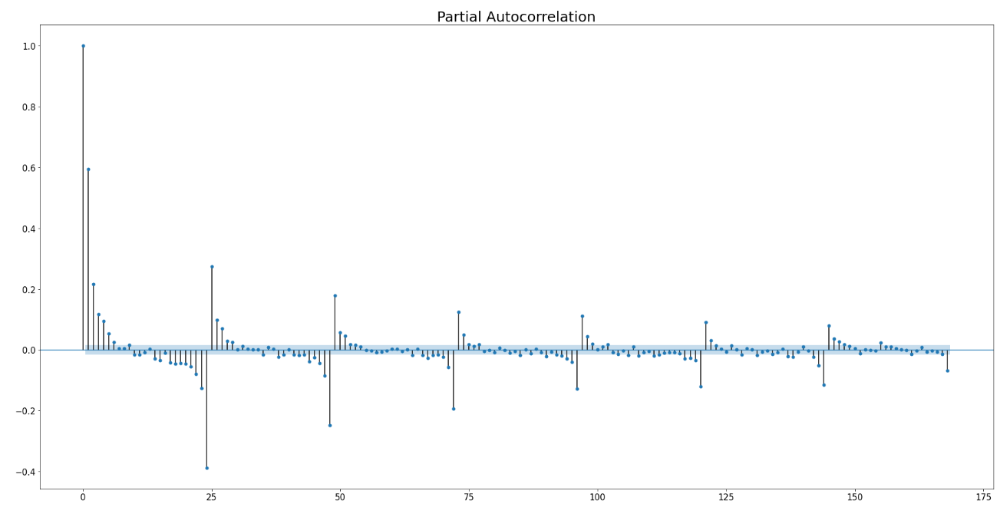

In [304]:
arima = ARIMA(resid, order=(3,0,1), seasonal_order=(2,1,1,24))
arima_fit = arima.fit()
summary_modelo1=arima_fit.summary()
print (summary_modelo1)

C:\Users\Anahi\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(3, 0, 1)x(2, 1, 1, 24)   Log Likelihood                2577.932
Date:                          Fri, 07 Oct 2022   AIC                          -5139.863
Time:                                  19:31:52   BIC                          -5079.250
Sample:                                       0   HQIC                         -5119.714
                                        - 14448                                         
Covariance Type:                            opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.2034      0.016     75.613      0.000       1.172       1.235
ar.L2         -0.1784      0.011    -16.715      0.

#### Diagnóstico del modelo

##### Ljung-Box

El p_valor es 0.82, un valor alto, por lo tanto, no rechazo. Esto quiere decir que entonces los residuos están descorrelacionados. Este es el resultado que se esperaba obtener.

##### Análisis residual

###### Gráfico del residuo

In [305]:
resid_SARIMA = arima_fit.resid
resid_SARIMA_std=(resid_SARIMA-resid_SARIMA.mean())/resid_SARIMA.std()

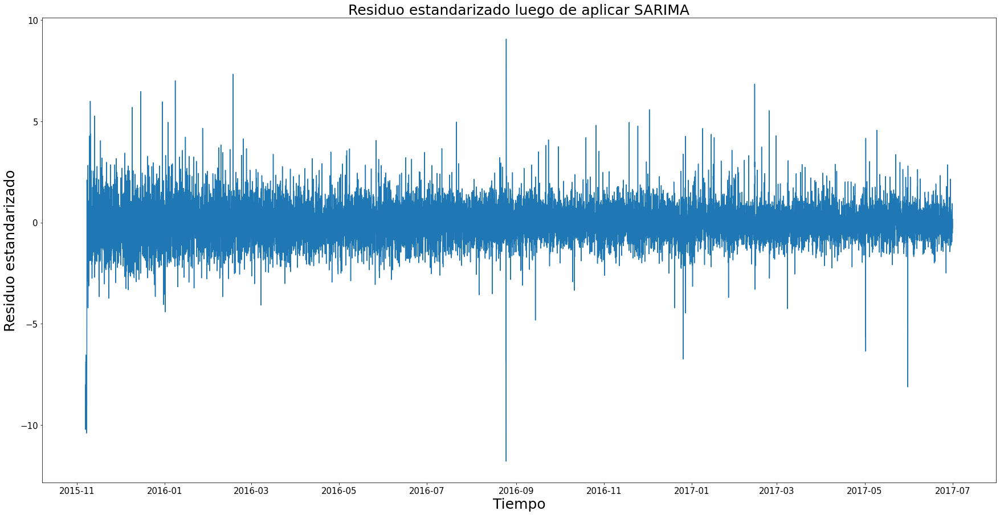

In [306]:
plt.plot(dataset_Junction1.index[start:], resid_SARIMA_std)
plt.title("Residuo estandarizado luego de aplicar SARIMA")
plt.xlabel("Tiempo")
plt.ylabel("Residuo estandarizado")
plt.show()

Hay muchos valores que se encuentran en más de 3 desvíos. Por lo tanto, parecería que el modelo no ajusta bien.

###### Normalidad de los residuos

C:\Users\Anahi\anaconda3\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


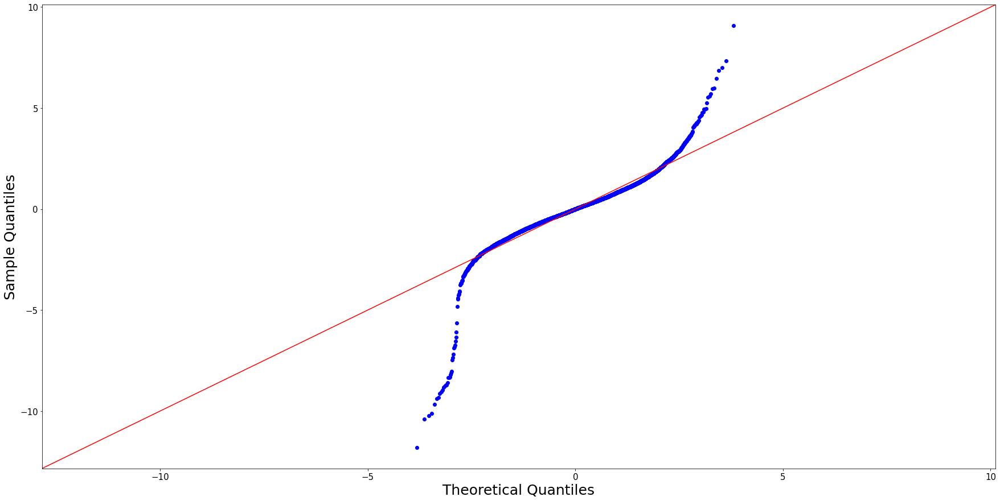

In [307]:
sm.qqplot(resid_SARIMA_std, line="45")
plt.show()

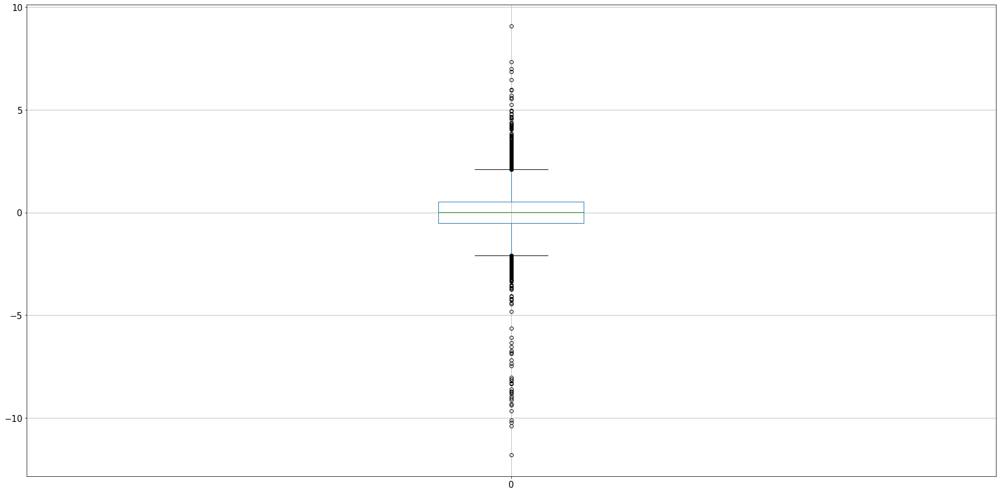

In [308]:
df_resid_SARIMA_std=pd.DataFrame(resid_SARIMA_std)
boxplot = df_resid_SARIMA_std.boxplot() 

Hay mucha curtosis en el QQ-Plot. De hecho, tiene un valor de 9.20. La oblicuidad está muy bien. Presenta muchos outliers según el Box-Plot, aunque no se puede asegurar que realmente lo sean.
En principio, parecería que el modelo no está ajustando bien.

###### Autocorrelación de los residuos

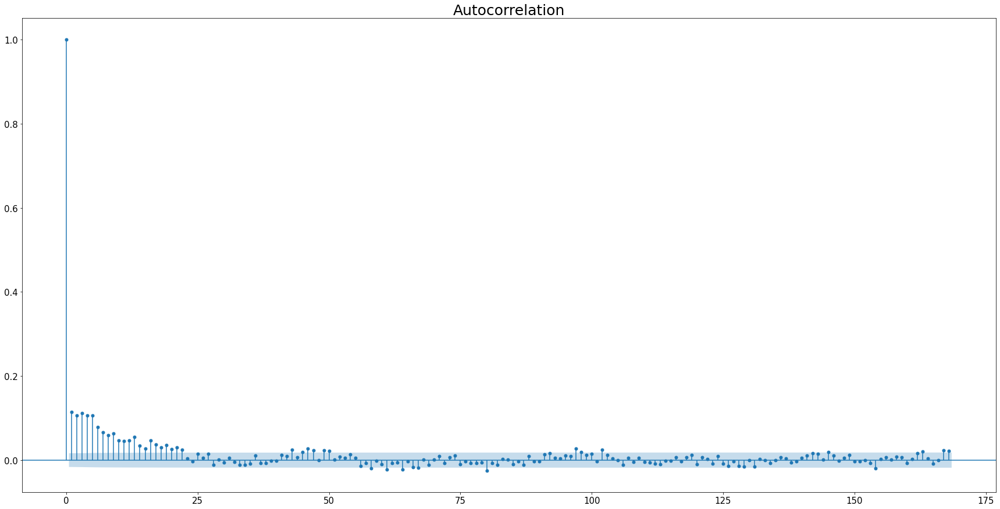

In [309]:
plot_acf(resid_SARIMA,lags=168)
plt.show()

Hay lags en donde la autocorrelacion parcial no es cero. Por lo tanto, parecería que el modelo NO está ajustando bien.

#### Criterios de bondad del modelo

Obtenemos el AIC, BIC y HQIC. Además, el log likelihood. Estos serán de utilidad para comparar con los modelos restantes.

In [310]:
print (summary_modelo1.tables[0])

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(3, 0, 1)x(2, 1, 1, 24)   Log Likelihood                2577.932
Date:                          Fri, 07 Oct 2022   AIC                          -5139.863
Time:                                  19:31:52   BIC                          -5079.250
Sample:                                       0   HQIC                         -5119.714
                                        - 14448                                         
Covariance Type:                            opg                                         


### Modelo 2

En este segundo modelo, se va a incorporar la diferenciación a 1 hora. Esa será la única modificación con respecto al modelo anterior (d=1).

1) ARMA estacionario: AR(p=3), MA(q=1). Si bien el coeficiente p podría alcanzar un valor hasta 12 según el gráfico de autocorrelación parcial, con el objeto de buscar un modelo más pequeño se define p=3 para poder comparar con el modelo anterior.

2) ARMA no estacionario o SARMA (cíclico): AR(P=2), MA(Q=1). Si bien el coeficiente P podría alcanzar un valor hasta 10 según el gráfico de autocorrelación parcial, con el objeto de buscar un modelo más pequeño se define p=2 para poder comparar con el modelo anterior.

NOTAS: 

* Para determinar el AR se observa el gráfico de autocorrelación parcial y para el MA el de autocorrelación de la serie a la cual se le aplicó diferenciación a 1 hora.
* Como hay componentes AR, la componente MA no se puede determinar con precisión del gráfico de autocorrelación, ya que podría ser menor. Por este motivo, se comienza probando con valores bajos (0 o 1) para ambos casos.

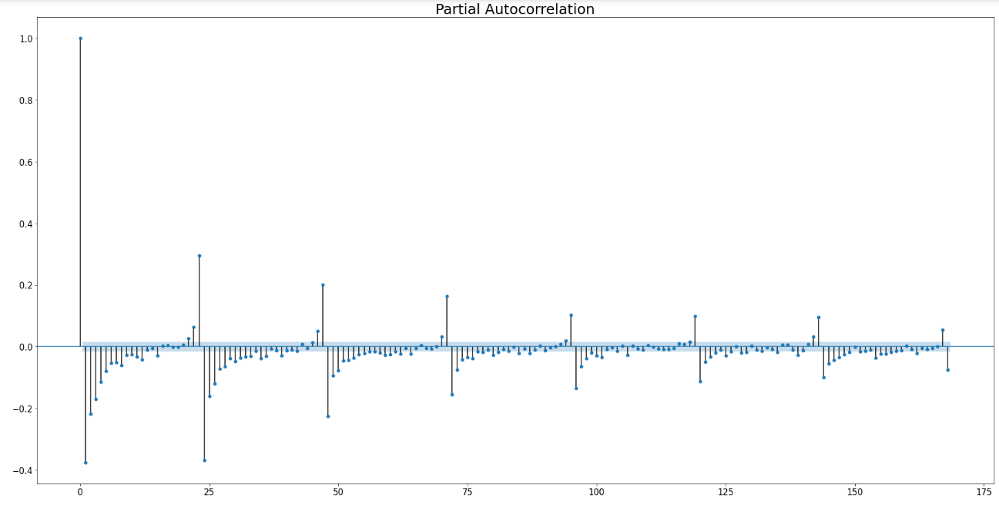

#### Estimación del orden del modelo, parámetros y coeficientes

In [148]:
arima = ARIMA(resid, order=(3,1,1), seasonal_order=(2,1,1,24))
arima_fit = arima.fit()
summary_modelo2=arima_fit.summary()
print (summary_modelo2)

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(3, 1, 1)x(2, 1, 1, 24)   Log Likelihood                2524.038
Date:                          Fri, 07 Oct 2022   AIC                          -5032.076
Time:                                  19:16:41   BIC                          -4971.464
Sample:                                       0   HQIC                         -5011.927
                                        - 14448                                         
Covariance Type:                            opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4104      0.006     67.575      0.000       0.399       0.422
ar.L2          0.1403      0.007     19.882      0.

#### Diagnóstico del modelo

##### Ljung-Box

El p_valor es 0.53, un valor alto, por lo tanto, no rechazo. Esto quiere decir que entonces los residuos están descorrelacionados. Este es el resultado que se esperaba obtener.

##### Análisis residual

###### Gráfico del residuo

In [150]:
resid_SARIMA = arima_fit.resid
resid_SARIMA_std=(resid_SARIMA-resid_SARIMA.mean())/resid_SARIMA.std()

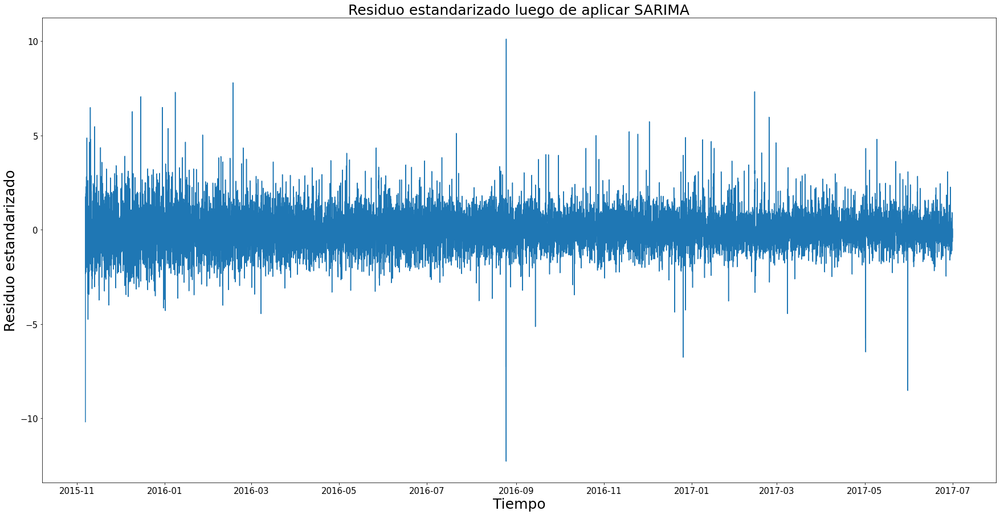

In [151]:
plt.plot(dataset_Junction1.index[start:], resid_SARIMA_std)
plt.title("Residuo estandarizado luego de aplicar SARIMA")
plt.xlabel("Tiempo")
plt.ylabel("Residuo estandarizado")
plt.show()

Hay muchos valores que se encuentran en más de 3 desvíos. Por lo tanto, parecería que el modelo no ajusta bien.

###### Normalidad de los residuos

C:\Users\Anahi\anaconda3\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


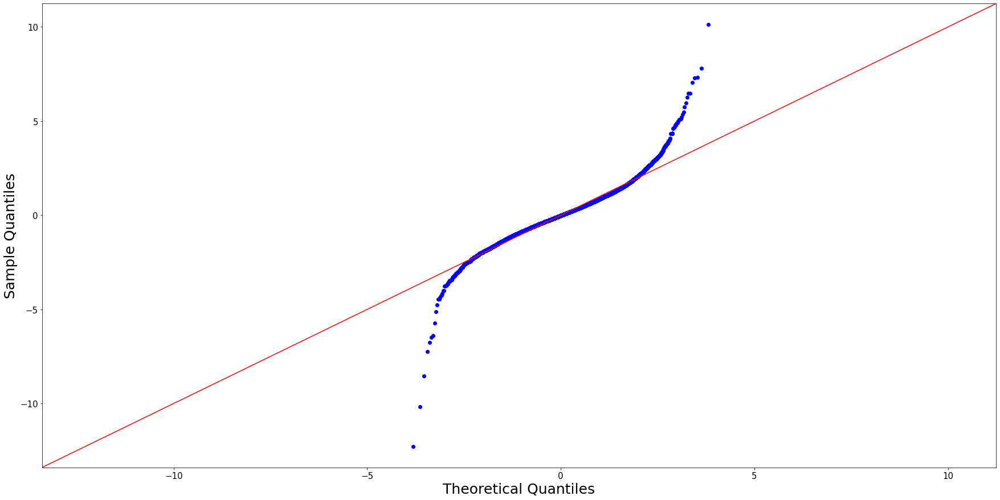

In [152]:
sm.qqplot(resid_SARIMA_std, line="45")
plt.show()

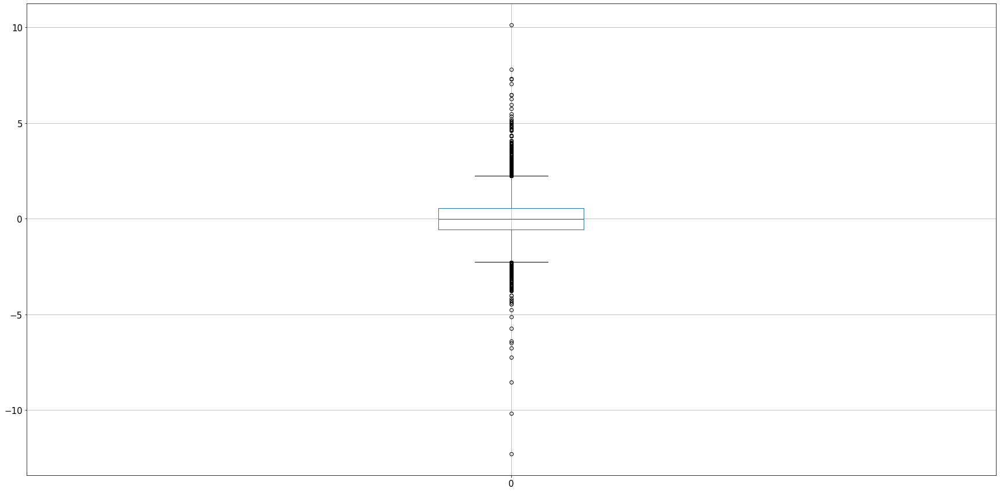

In [153]:
df_resid_SARIMA_std=pd.DataFrame(resid_SARIMA_std)
boxplot = df_resid_SARIMA_std.boxplot() 

Hay mucha curtosis en el QQ-Plot. De hecho, tiene un valor de 9.10. La oblicuidad está muy bien. Presenta muchos outliers según el Box-Plot, aunque no se puede asegurar que realmente lo sean.
En principio, parecería que el modelo no está ajustando bien.

###### Autocorrelación de los residuos

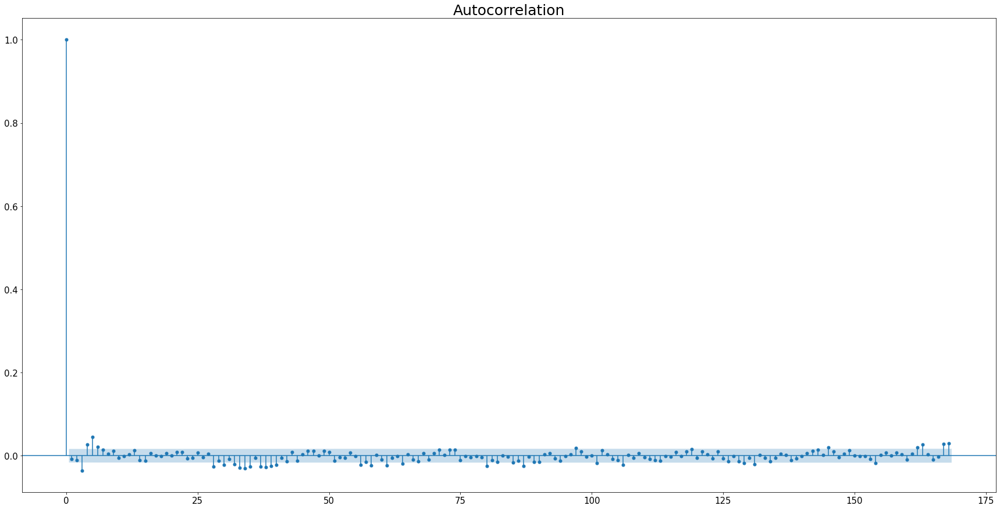

In [154]:
plot_acf(resid_SARIMA,lags=168)
plt.show()

Hay lags en donde la autocorrelacion parcial no es cero. Sin embargo, no se alejan demasiado del intervalo de confianza. Por lo tanto, parecería que el modelo está ajustando bastante bien.

#### Criterios de bondad del modelo

Obtenemos el AIC, BIC y HQIC. Además, el log likelihood. Estos serán de utilidad para comparar con los modelos restantes.

In [155]:
print (summary_modelo2.tables[0])

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(3, 1, 1)x(2, 1, 1, 24)   Log Likelihood                2524.038
Date:                          Fri, 07 Oct 2022   AIC                          -5032.076
Time:                                  19:16:41   BIC                          -4971.464
Sample:                                       0   HQIC                         -5011.927
                                        - 14448                                         
Covariance Type:                            opg                                         


### Modelo 3

En este tercer modelo, se va modificar el modelo 2. Más precisamente se va a cambiar el AR(p=3) a p=2. Esto es así, porque en el primer modelo, según lo observado en su gráfico de autocorrelación parcial, podría ser p=2.

#### Estimación del orden del modelo, parámetros y coeficientes

In [460]:
arima = ARIMA(resid, order=(2,1,1), seasonal_order=(2,1,1,24))
arima_fit = arima.fit()
summary_modelo3=arima_fit.summary()
print (summary_modelo3)

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(2, 1, 1)x(2, 1, 1, 24)   Log Likelihood                2489.331
Date:                          Fri, 07 Oct 2022   AIC                          -4964.662
Time:                                  19:46:06   BIC                          -4911.626
Sample:                                       0   HQIC                         -4947.032
                                        - 14448                                         
Covariance Type:                            opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3498      0.008     46.366      0.000       0.335       0.365
ar.L2          0.1182      0.008     15.508      0.

#### Diagnóstico del modelo

##### Ljung-Box

El p_valor es 0.47, un valor alto, por lo tanto, no rechazo. Esto quiere decir que entonces los residuos están descorrelacionados. Este es el resultado que se esperaba obtener.

##### Análisis residual

###### Gráfico del residuo

In [461]:
resid_SARIMA = arima_fit.resid
resid_SARIMA_std=(resid_SARIMA-resid_SARIMA.mean())/resid_SARIMA.std()

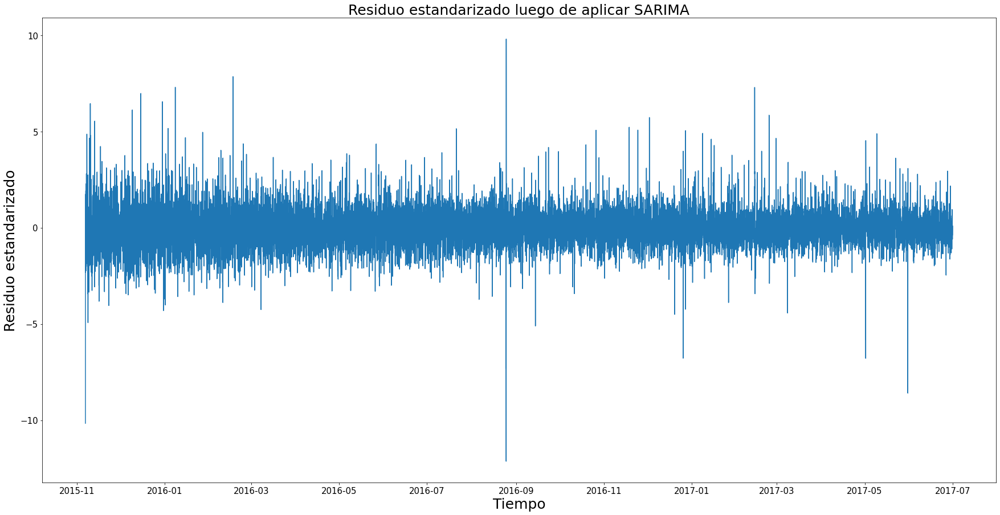

In [462]:
plt.plot(dataset_Junction1.index[start:], resid_SARIMA_std)
plt.title("Residuo estandarizado luego de aplicar SARIMA")
plt.xlabel("Tiempo")
plt.ylabel("Residuo estandarizado")
plt.show()

Hay muchos valores que se encuentran en más de 3 desvíos. Por lo tanto, parecería que el modelo no ajusta bien.

###### Normalidad de los residuos

C:\Users\Anahi\anaconda3\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


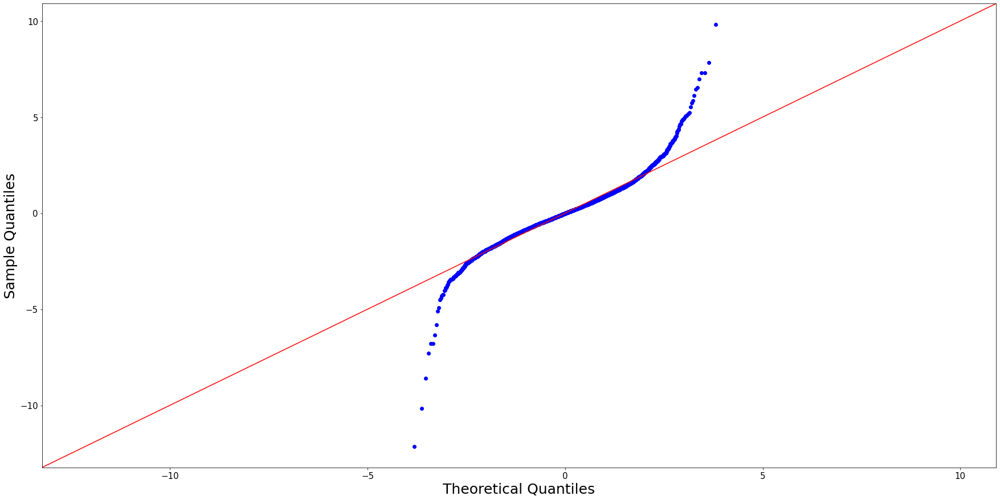

In [463]:
sm.qqplot(resid_SARIMA_std, line="45")
plt.show()

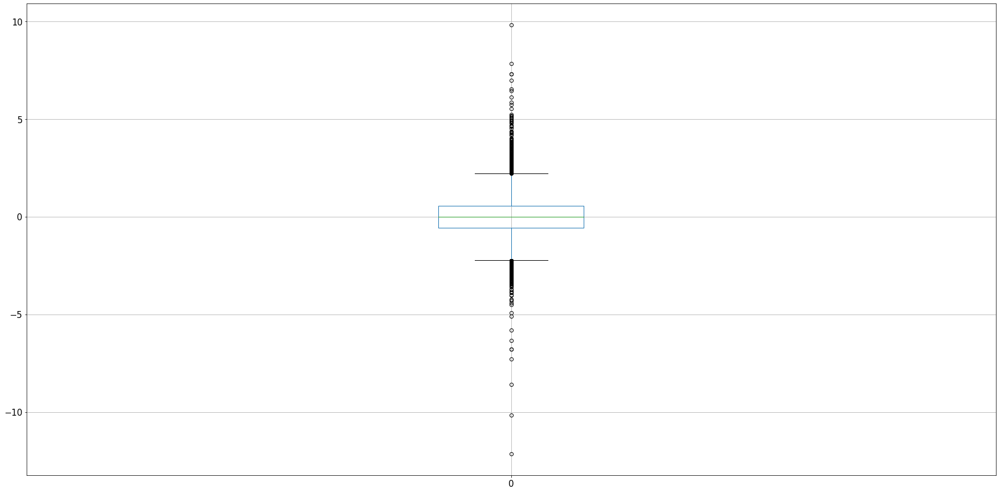

In [464]:
df_resid_SARIMA_std=pd.DataFrame(resid_SARIMA_std)
boxplot = df_resid_SARIMA_std.boxplot() 

Hay mucha curtosis en el QQ-Plot. De hecho, tiene un valor de 8.94. La oblicuidad está muy bien. Presenta muchos outliers según el Box-Plot, aunque no se puede asegurar que realmente lo sean.
En principio, parecería que el modelo no está ajustando bien.

###### Autocorrelación de los residuos

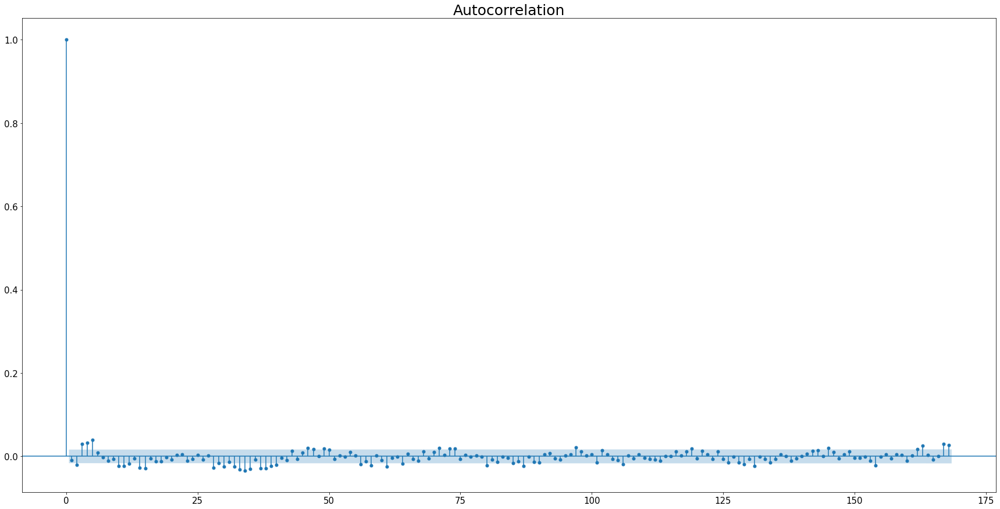

In [465]:
plot_acf(resid_SARIMA,lags=168)
plt.show()

Hay lags en donde la autocorrelacion parcial no es cero. Sin embargo, no se alejan demasiado del intervalo de confianza. Por lo tanto, parecería que el modelo está ajustando bastante bien.

#### Criterios de bondad del modelo

Obtenemos el AIC, BIC y HQIC. Además, el log likelihood. Estos serán de utilidad para comparar con los modelos restantes.

In [466]:
print (summary_modelo3.tables[0])

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(2, 1, 1)x(2, 1, 1, 24)   Log Likelihood                2489.331
Date:                          Fri, 07 Oct 2022   AIC                          -4964.662
Time:                                  19:46:06   BIC                          -4911.626
Sample:                                       0   HQIC                         -4947.032
                                        - 14448                                         
Covariance Type:                            opg                                         


### Modelo 4

En este tercer modelo, se va modificar el modelo 2. Más precisamente se va a cambiar el MA(Q=1) a Q=0. Esto es así, porque al haber componentes AR, no está claro el orden del modelo MA.

#### Estimación del orden del modelo, parámetros y coeficientes

In [615]:
arima = ARIMA(resid, order=(3,1,1), seasonal_order=(2,1,0,24))
arima_fit = arima.fit()
summary_modelo4=arima_fit.summary()
print (summary_modelo4)

                                     SARIMAX Results                                     
Dep. Variable:                                 y   No. Observations:                14448
Model:             ARIMA(3, 1, 1)x(2, 1, [], 24)   Log Likelihood                 844.062
Date:                           Fri, 07 Oct 2022   AIC                          -1674.124
Time:                                   19:57:06   BIC                          -1621.088
Sample:                                        0   HQIC                         -1656.494
                                         - 14448                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3170      0.009     33.619      0.000       0.298       0.335
ar.L2          0.0862      0.008     10.325

#### Diagnóstico del modelo

##### Ljung-Box

El p_valor es 0.84, un valor alto, por lo tanto, no rechazo. Esto quiere decir que entonces los residuos están descorrelacionados. Este es el resultado que se esperaba obtener.

##### Análisis residual

###### Gráfico del residuo

In [616]:
resid_SARIMA = arima_fit.resid
resid_SARIMA_std=(resid_SARIMA-resid_SARIMA.mean())/resid_SARIMA.std()

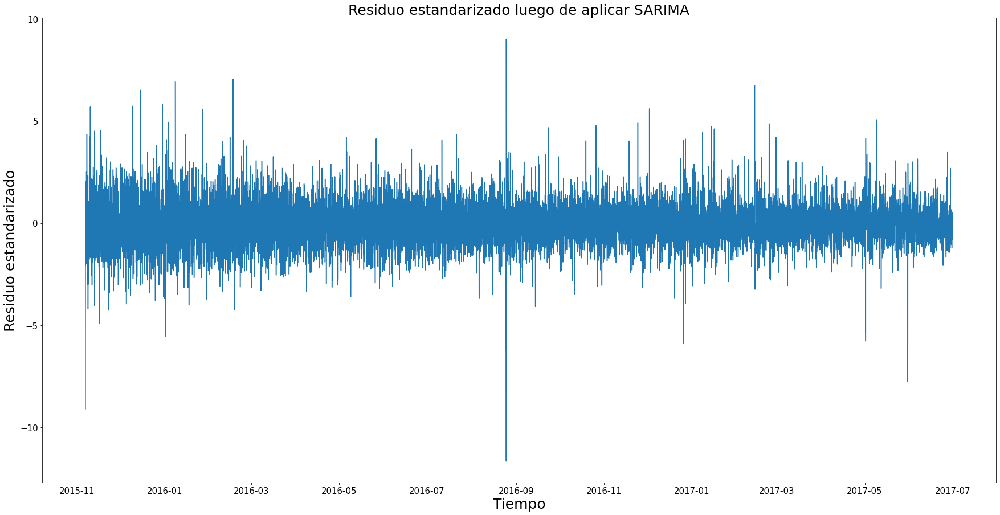

In [617]:
plt.plot(dataset_Junction1.index[start:], resid_SARIMA_std)
plt.title("Residuo estandarizado luego de aplicar SARIMA")
plt.xlabel("Tiempo")
plt.ylabel("Residuo estandarizado")
plt.show()

Hay muchos valores que se encuentran en más de 3 desvíos. Por lo tanto, parecería que el modelo no ajusta bien.

###### Normalidad de los residuos

C:\Users\Anahi\anaconda3\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


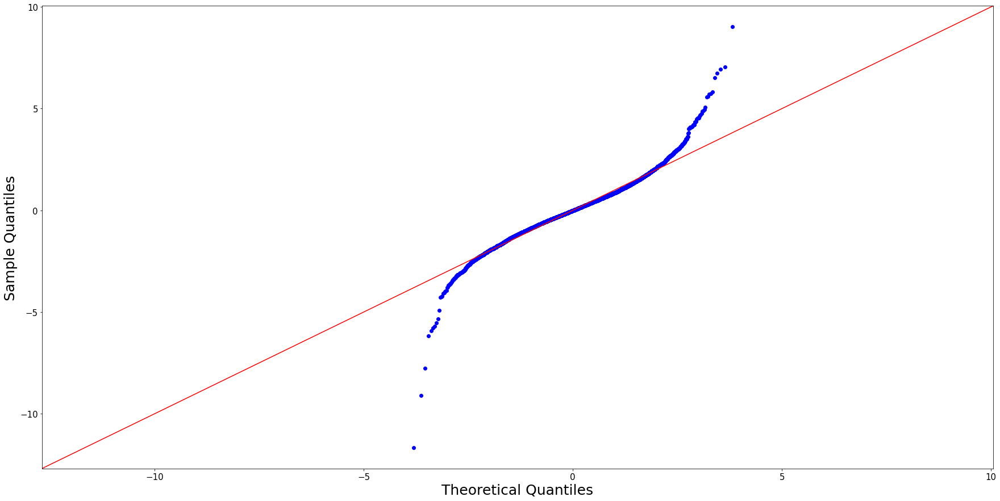

In [618]:
sm.qqplot(resid_SARIMA_std, line="45")
plt.show()

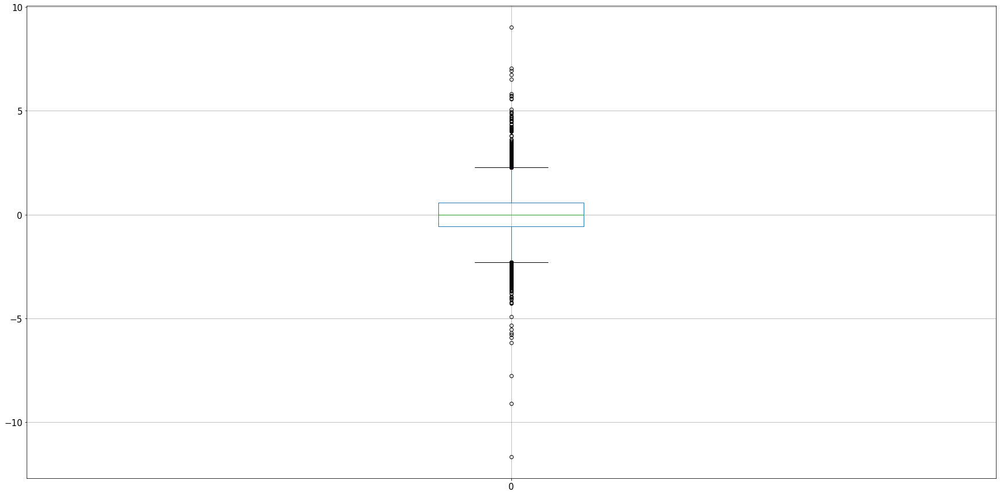

In [619]:
df_resid_SARIMA_std=pd.DataFrame(resid_SARIMA_std)
boxplot = df_resid_SARIMA_std.boxplot() 

Hay mucha curtosis en el QQ-Plot. De hecho, tiene un valor de 7.53. La oblicuidad está muy bien. Presenta muchos outliers según el Box-Plot, aunque no se puede asegurar que realmente lo sean.
En principio, parecería que el modelo no está ajustando bien.

###### Autocorrelación de los residuos

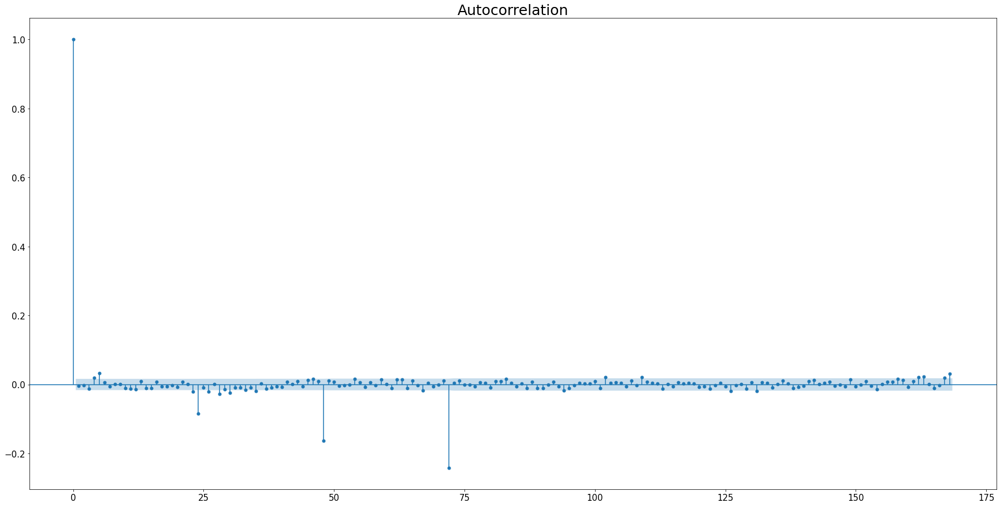

In [620]:
plot_acf(resid_SARIMA,lags=168)
plt.show()

Hay 3 lags bien marcados en donde la autocorrelacion parcial no es cero. Sin embargo, el resto no se alejan demasiado del intervalo de confianza. Por lo tanto, parecería que el modelo está ajustando bastante bien.

#### Criterios de bondad del modelo

Obtenemos el AIC, BIC y HQIC. Además, el log likelihood. Estos serán de utilidad para comparar con los modelos restantes.

In [621]:
print (summary_modelo4.tables[0])

                                     SARIMAX Results                                     
Dep. Variable:                                 y   No. Observations:                14448
Model:             ARIMA(3, 1, 1)x(2, 1, [], 24)   Log Likelihood                 844.062
Date:                           Fri, 07 Oct 2022   AIC                          -1674.124
Time:                                   19:57:06   BIC                          -1621.088
Sample:                                        0   HQIC                         -1656.494
                                         - 14448                                         
Covariance Type:                             opg                                         


### Modelo 5

En este tercer modelo, se va modificar el modelo 2. Más precisamente se va a cambiar el MA(q=1) a q=0. Esto es así, porque al haber componentes AR, no está claro el orden del modelo MA.

#### Estimación del orden del modelo, parámetros y coeficientes

In [771]:
arima = ARIMA(resid, order=(3,1,0), seasonal_order=(2,1,1,24))
arima_fit = arima.fit()
summary_modelo5=arima_fit.summary()
print (summary_modelo5)

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                14448
Model:             ARIMA(3, 1, 0)x(2, 1, [1], 24)   Log Likelihood                2223.384
Date:                            Fri, 07 Oct 2022   AIC                          -4432.767
Time:                                    20:16:46   BIC                          -4379.731
Sample:                                         0   HQIC                         -4415.137
                                          - 14448                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4882      0.005   -107.355      0.000      -0.497      -0.479
ar.L2         -0.2869      0.006   

#### Diagnóstico del modelo

##### Ljung-Box

El p_valor es 0.04, un valor bajo, por lo tanto, rechazo. Esto quiere decir que entonces los residuos NO están descorrelacionados. Este NO es el resultado que se esperaba obtener.

##### Análisis residual

###### Gráfico del residuo

In [772]:
resid_SARIMA = arima_fit.resid
resid_SARIMA_std=(resid_SARIMA-resid_SARIMA.mean())/resid_SARIMA.std()

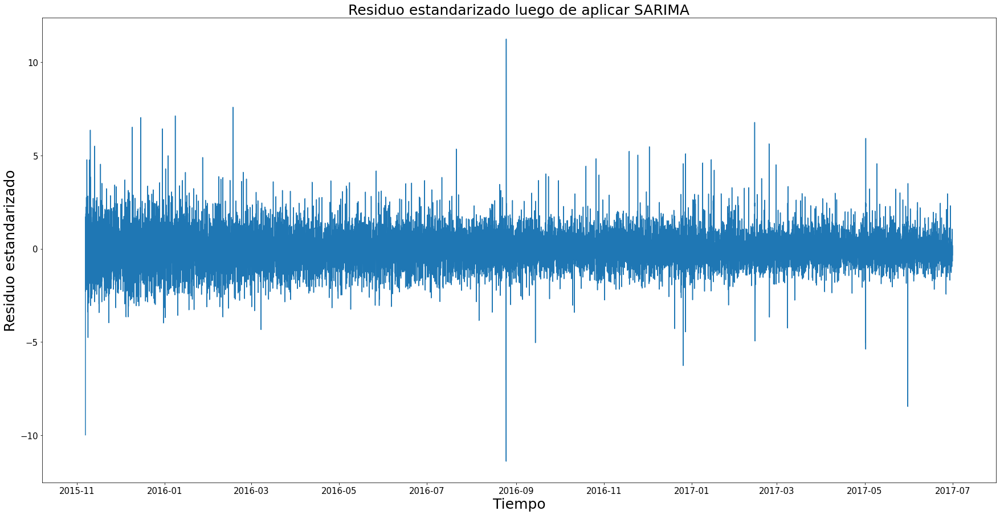

In [773]:
plt.plot(dataset_Junction1.index[start:], resid_SARIMA_std)
plt.title("Residuo estandarizado luego de aplicar SARIMA")
plt.xlabel("Tiempo")
plt.ylabel("Residuo estandarizado")
plt.show()

Hay muchos valores que se encuentran en más de 3 desvíos. Por lo tanto, parecería que el modelo no ajusta bien.

###### Normalidad de los residuos

C:\Users\Anahi\anaconda3\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


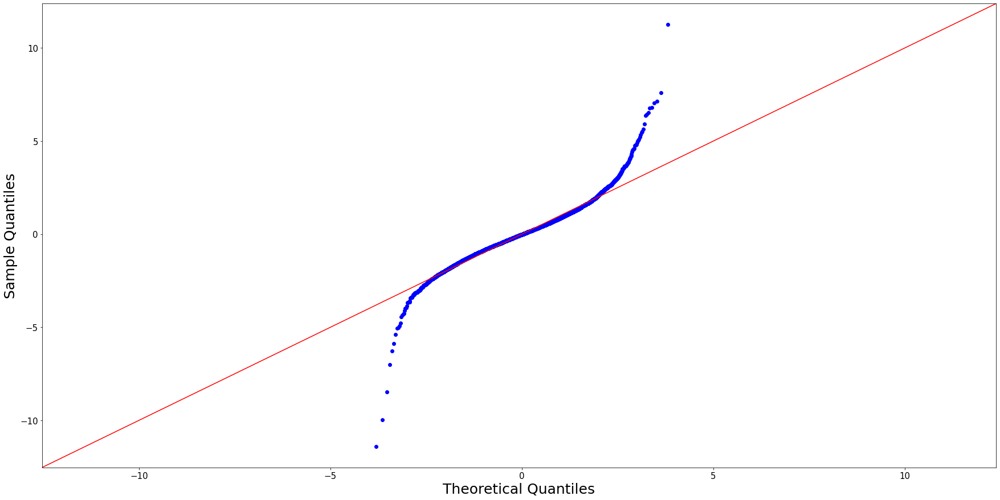

In [774]:
sm.qqplot(resid_SARIMA_std, line="45")
plt.show()

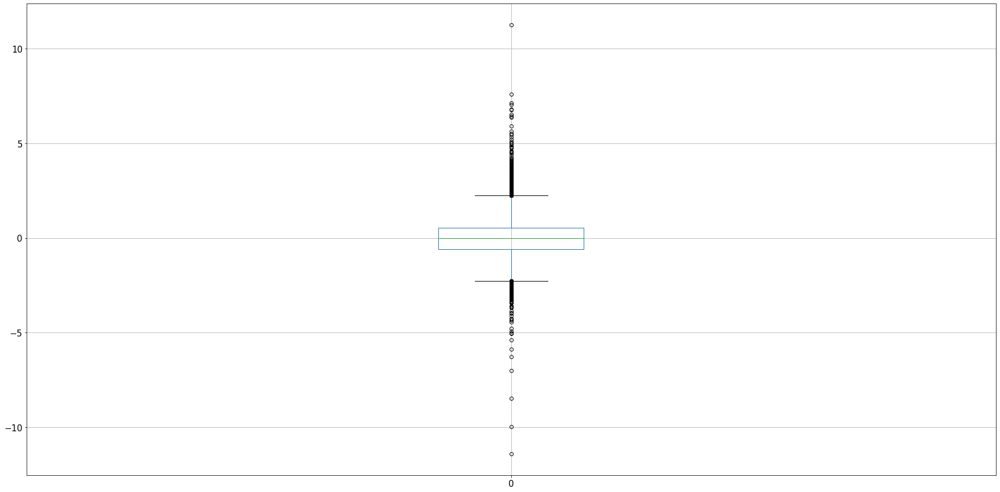

In [775]:
df_resid_SARIMA_std=pd.DataFrame(resid_SARIMA_std)
boxplot = df_resid_SARIMA_std.boxplot() 

Hay mucha curtosis en el QQ-Plot. De hecho, tiene un valor de 8.82. La oblicuidad está muy bien. Presenta muchos outliers según el Box-Plot, aunque no se puede asegurar que realmente lo sean.
En principio, parecería que el modelo no está ajustando bien.

###### Autocorrelación de los residuos

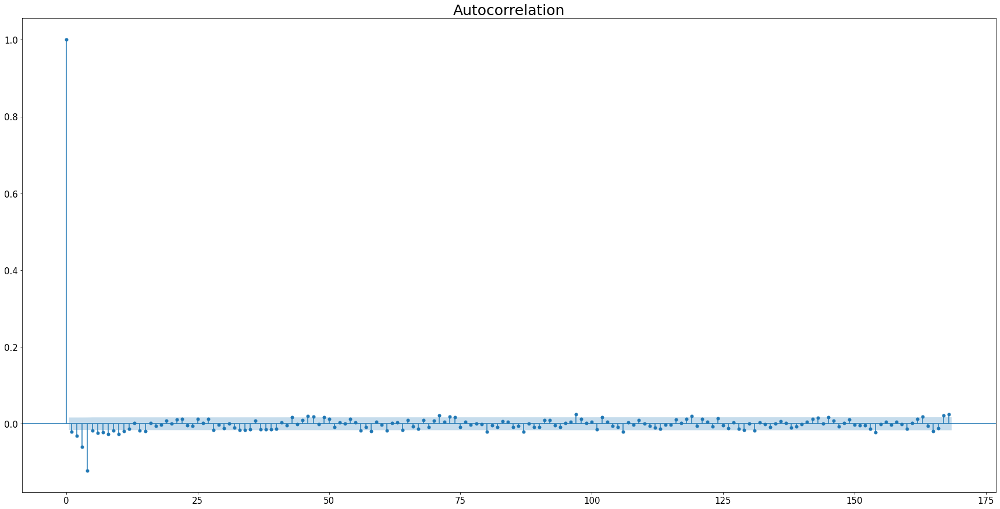

In [776]:
plot_acf(resid_SARIMA,lags=168)
plt.show()

Hay lags en donde la autocorrelacion parcial no es cero. Por lo tanto, parecería que el modelo NO está ajustando bien.

#### Criterios de bondad del modelo

Obtenemos el AIC, BIC y HQIC. Además, el log likelihood. Estos serán de utilidad para comparar con los modelos restantes.

In [777]:
print (summary_modelo5.tables[0])

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                14448
Model:             ARIMA(3, 1, 0)x(2, 1, [1], 24)   Log Likelihood                2223.384
Date:                            Fri, 07 Oct 2022   AIC                          -4432.767
Time:                                    20:16:46   BIC                          -4379.731
Sample:                                         0   HQIC                         -4415.137
                                          - 14448                                         
Covariance Type:                              opg                                         


### Comparación de modelos

#### Coeficientes de error

In [313]:
print (summary_modelo1.tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.2034      0.016     75.613      0.000       1.172       1.235
ar.L2         -0.1784      0.011    -16.715      0.000      -0.199      -0.157
ar.L3         -0.0508      0.010     -5.271      0.000      -0.070      -0.032
ma.L1         -0.7542      0.015    -50.545      0.000      -0.783      -0.725
ar.S.L24      -0.0029      0.008     -0.356      0.722      -0.019       0.013
ar.S.L48       0.0132      0.008      1.702      0.089      -0.002       0.028
ma.S.L24      -0.9418      0.003   -309.035      0.000      -0.948      -0.936
sigma2         0.0408      0.000    169.820      0.000       0.040       0.041


In [156]:
print (summary_modelo2.tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4104      0.006     67.575      0.000       0.399       0.422
ar.L2          0.1403      0.007     19.882      0.000       0.126       0.154
ar.L3          0.0916      0.008     12.214      0.000       0.077       0.106
ma.L1         -0.9466      0.004   -235.896      0.000      -0.954      -0.939
ar.S.L24      -0.0083      0.008     -1.026      0.305      -0.024       0.008
ar.S.L48       0.0055      0.008      0.727      0.467      -0.009       0.021
ma.S.L24      -0.9519      0.003   -354.430      0.000      -0.957      -0.947
sigma2         0.0411      0.000    167.449      0.000       0.041       0.042


In [467]:
print (summary_modelo3.tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3498      0.008     46.366      0.000       0.335       0.365
ar.L2          0.1182      0.008     15.508      0.000       0.103       0.133
ma.L1         -0.8809      0.006   -151.091      0.000      -0.892      -0.869
ar.S.L24      -0.0128      0.008     -1.589      0.112      -0.028       0.003
ar.S.L48       0.0095      0.008      1.232      0.218      -0.006       0.025
ma.S.L24      -0.9493      0.003   -344.835      0.000      -0.955      -0.944
sigma2         0.0413      0.000    167.445      0.000       0.041       0.042


In [622]:
print (summary_modelo4.tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3170      0.009     33.619      0.000       0.298       0.335
ar.L2          0.0862      0.008     10.325      0.000       0.070       0.103
ar.L3          0.0543      0.009      6.307      0.000       0.037       0.071
ma.L1         -0.8698      0.008   -108.185      0.000      -0.886      -0.854
ar.S.L24      -0.6825      0.006   -113.274      0.000      -0.694      -0.671
ar.S.L48      -0.3345      0.006    -54.195      0.000      -0.347      -0.322
sigma2         0.0520      0.000    151.464      0.000       0.051       0.053


In [778]:
print (summary_modelo5.tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4882      0.005   -107.355      0.000      -0.497      -0.479
ar.L2         -0.2869      0.006    -51.411      0.000      -0.298      -0.276
ar.L3         -0.1525      0.006    -26.117      0.000      -0.164      -0.141
ar.S.L24      -0.0023      0.008     -0.283      0.777      -0.018       0.014
ar.S.L48       0.0120      0.008      1.532      0.126      -0.003       0.027
ma.S.L24      -0.9504      0.003   -343.852      0.000      -0.956      -0.945
sigma2         0.0428      0.000    163.767      0.000       0.042       0.043


#### Criterios de bondad

In [312]:
print (summary_modelo1.tables[0])

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(3, 0, 1)x(2, 1, 1, 24)   Log Likelihood                2577.932
Date:                          Fri, 07 Oct 2022   AIC                          -5139.863
Time:                                  19:31:52   BIC                          -5079.250
Sample:                                       0   HQIC                         -5119.714
                                        - 14448                                         
Covariance Type:                            opg                                         


In [157]:
print (summary_modelo2.tables[0])

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(3, 1, 1)x(2, 1, 1, 24)   Log Likelihood                2524.038
Date:                          Fri, 07 Oct 2022   AIC                          -5032.076
Time:                                  19:16:41   BIC                          -4971.464
Sample:                                       0   HQIC                         -5011.927
                                        - 14448                                         
Covariance Type:                            opg                                         


In [468]:
print (summary_modelo3.tables[0])

                                    SARIMAX Results                                     
Dep. Variable:                                y   No. Observations:                14448
Model:             ARIMA(2, 1, 1)x(2, 1, 1, 24)   Log Likelihood                2489.331
Date:                          Fri, 07 Oct 2022   AIC                          -4964.662
Time:                                  19:46:06   BIC                          -4911.626
Sample:                                       0   HQIC                         -4947.032
                                        - 14448                                         
Covariance Type:                            opg                                         


In [623]:
print (summary_modelo4.tables[0])

                                     SARIMAX Results                                     
Dep. Variable:                                 y   No. Observations:                14448
Model:             ARIMA(3, 1, 1)x(2, 1, [], 24)   Log Likelihood                 844.062
Date:                           Fri, 07 Oct 2022   AIC                          -1674.124
Time:                                   19:57:06   BIC                          -1621.088
Sample:                                        0   HQIC                         -1656.494
                                         - 14448                                         
Covariance Type:                             opg                                         


In [779]:
print (summary_modelo5.tables[0])

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                14448
Model:             ARIMA(3, 1, 0)x(2, 1, [1], 24)   Log Likelihood                2223.384
Date:                            Fri, 07 Oct 2022   AIC                          -4432.767
Time:                                    20:16:46   BIC                          -4379.731
Sample:                                         0   HQIC                         -4415.137
                                          - 14448                                         
Covariance Type:                              opg                                         


Los mejores criterios los obtenemos en el modelo 1 seguido por el modelo 2.

#### Test Ljung-Box y análisis residual

In [314]:
print (summary_modelo1.tables[2])

Ljung-Box (L1) (Q):                   0.05   Jarque-Bera (JB):             23181.80
Prob(Q):                              0.82   Prob(JB):                         0.00
Heteroskedasticity (H):               0.55   Skew:                             0.15
Prob(H) (two-sided):                  0.00   Kurtosis:                         9.20


In [158]:
print (summary_modelo2.tables[2])

Ljung-Box (L1) (Q):                   0.40   Jarque-Bera (JB):             22495.42
Prob(Q):                              0.53   Prob(JB):                         0.00
Heteroskedasticity (H):               0.54   Skew:                             0.21
Prob(H) (two-sided):                  0.00   Kurtosis:                         9.10


In [469]:
print (summary_modelo3.tables[2])

Ljung-Box (L1) (Q):                   0.53   Jarque-Bera (JB):             21297.00
Prob(Q):                              0.47   Prob(JB):                         0.00
Heteroskedasticity (H):               0.55   Skew:                             0.20
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.94


In [624]:
print (summary_modelo4.tables[2])

Ljung-Box (L1) (Q):                   0.04   Jarque-Bera (JB):             12369.84
Prob(Q):                              0.84   Prob(JB):                         0.00
Heteroskedasticity (H):               0.55   Skew:                             0.14
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.53


In [780]:
print (summary_modelo5.tables[2])

Ljung-Box (L1) (Q):                   4.43   Jarque-Bera (JB):             20562.47
Prob(Q):                              0.04   Prob(JB):                         0.00
Heteroskedasticity (H):               0.54   Skew:                             0.29
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.82


#### Resumen

Lo que se busca es:
* Coeficientes (error): que sean lo más bajo posible.
* Criterios de bondad (AIC/BIC): que sean lo más bajo posibles (comparando entre modelos).
* Test de LJUNG-BOX: que sea lo más alto posible (arriba de 0.05) para asegurar que los residuos están descorrelacionados.
* Curtosis del residuo: que sea lo más baja posible para que se asemeje a una normal.

In [781]:
summary_general = [["(3,0,1) (2,1,1,24)", "0.0X","-5139/-5032" ,0.82 ,9.20],
                 ["(3,1,1) (2,1,1,24)", "0.00X", "-5079/-4971", 0.53, 9.10],
                 ["(2,1,1) (2,1,1,24)", "0.00X", "-4964/-4911", 0.47, 8.94],
                 ["(3,1,1) (2,1,0,24)", "0.00X", "-1674/-1621", 0.84, 7.53],
                 ["(3,1,0) (2,1,1,24)", "0.00X", "-4432/-4379", 0.04, 8.82]]
dataframe_conclusion = pd.DataFrame(summary_general, columns = ['Modelo','Error coef.','AIC/BIC','LJUNG-BOX','CURTOSIS'])
print(dataframe_conclusion)

               Modelo Error coef.      AIC/BIC  LJUNG-BOX  CURTOSIS
0  (3,0,1) (2,1,1,24)        0.0X  -5139/-5032       0.82      9.20
1  (3,1,1) (2,1,1,24)       0.00X  -5079/-4971       0.53      9.10
2  (2,1,1) (2,1,1,24)       0.00X  -4964/-4911       0.47      8.94
3  (3,1,1) (2,1,0,24)       0.00X  -1674/-1621       0.84      7.53
4  (3,1,0) (2,1,1,24)       0.00X  -4432/-4379       0.04      8.82


Analizando esta tabla la mejor solución es el modelo 2: (3,1,1) (2,1,1,24), ya que se descartan las restantes por las siguientes razones:

* El modelo 1 es el que mayor desvío tiene en el error de los coeficientes. Los modelos restantes son similares.
* El modelo 5 es el único en el que el test de LJUNG-BOX el p_valor es menor a 0.05, por lo que los residuos NO están descorrelacionados.
* El modelo 4 tiene el AIC/BIC más alto en comparación con los modelos restantes.

Finalmente, entre el modelo 2 y 3, el modelo 2 tiene mejor AIC/BIC (más bajo) y LJUNG-BOX (más alto). Además, si observamos en detalle el error de los coeficientes para el modelo 2 es menor. La única contrapartida es que la curtosis es un poco más elevada en el modelo 2. El gráfico de autocorrelación de residuos es muy bueno en ambos casos, a diferencia de los otros modelos.

Dada la cantidad de datos, si se prueba con modelos de orden mayor, no alcanza la memoria del Colab.

## Ajuste (fit) y predicción (predict)

Se va a realizar el ajuste y la predicción con el modelo 2 elegido anteriormente: (3,1,1) (2,1,1,24). Además, se va a visualizar la predicción sin y con antitransformación.

### Sin antitrasformación

In [148]:
# Se crea el dataset con los datos preprocesados y la fecha/hora como índice.
dataframe_real=pd.DataFrame(resid,columns=['Vehicles'])
dataframe_real.index=dataset_Junction1[start:].index
dataframe_real.tail(10)

,Vehicles
DateTime,
2017-06-30 14:00:00,1.749366
2017-06-30 15:00:00,1.684558
2017-06-30 16:00:00,1.660580
2017-06-30 17:00:00,1.590324
2017-06-30 18:00:00,1.581491
2017-06-30 19:00:00,1.754926
2017-06-30 20:00:00,1.570242
2017-06-30 21:00:00,1.535229
2017-06-30 22:00:00,1.474706


In [149]:
# Se establece que el índice tiene una frecuencia por hora.
dataframe_real.index=pd.DatetimeIndex(dataframe_real.index.values,freq='H')
dataframe_real.tail(10)

,Vehicles
2017-06-30 14:00:00,1.749366
2017-06-30 15:00:00,1.684558
2017-06-30 16:00:00,1.660580
2017-06-30 17:00:00,1.590324
2017-06-30 18:00:00,1.581491
2017-06-30 19:00:00,1.754926
2017-06-30 20:00:00,1.570242
2017-06-30 21:00:00,1.535229
2017-06-30 22:00:00,1.474706
2017-06-30 23:00:00,1.401856


In [150]:
# Se ajusta el modelo.
arima = ARIMA(dataframe_real, order=(3,1,1), seasonal_order=(2,1,1,24))
arima_fit = arima.fit()
summary_modelo2=arima_fit.summary()
print (summary_modelo2)

                                    SARIMAX Results                                     
Dep. Variable:                         Vehicles   No. Observations:                14448
Model:             ARIMA(3, 1, 1)x(2, 1, 1, 24)   Log Likelihood                2524.038
Date:                          Fri, 07 Oct 2022   AIC                          -5032.076
Time:                                  22:29:46   BIC                          -4971.464
Sample:                              11-07-2015   HQIC                         -5011.927
                                   - 06-30-2017                                         
Covariance Type:                            opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4104      0.006     67.575      0.000       0.399       0.422
ar.L2          0.1403      0.007     19.882      0.

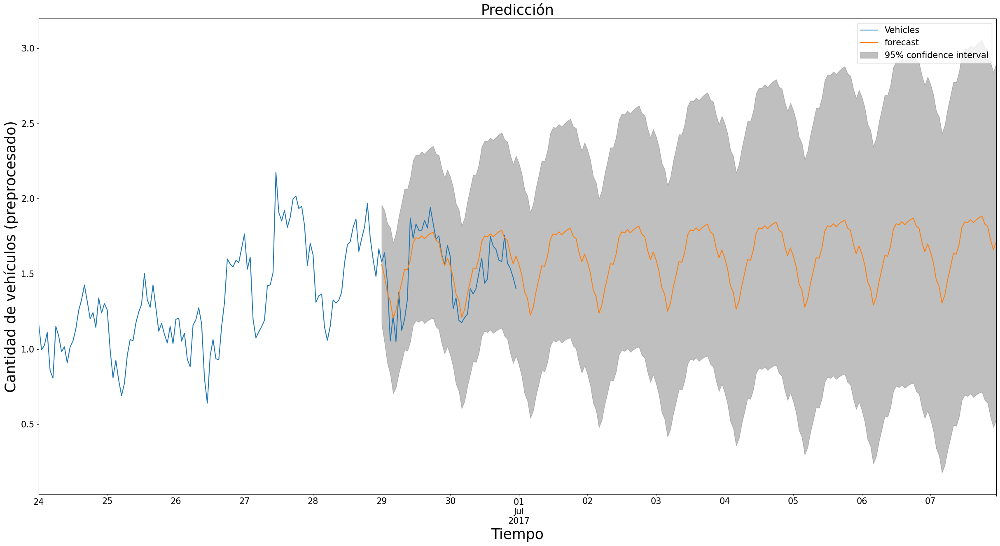

In [151]:
# Se realiza la predicción y se grafica.
fig, ax = plt.subplots()
ax = dataframe_real.loc['2017-06-24 00:00:00':].plot(ax=ax)
fig = plot_predict(arima_fit, '2017-06-29 00:00:00', '2017-07-07 23:00:00', dynamic=True, ax=ax, plot_insample=False)

plt.title("Predicción")
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos (preprocesado)")


plt.show()

#### Análisis de los resultados

El error va aumentando a medida que se predice a más pasos. Esto es lógico ya que se trata de un SARIMA.
La predicción sigue un comportamiento a 24 horas, tal como se esperaba.

### Con antitransformación

Se muestra el proceso para llevar la predicción sin antitransformar a una con antitransformación.

In [152]:
#Se predice a 7 días.
predictions = arima_fit.predict(start ='2017-07-01 00:00:00', end='2017-07-07 23:00:00')
predictions

2017-07-01 00:00:00    1.420124
2017-07-01 01:00:00    1.355985
2017-07-01 02:00:00    1.249042
2017-07-01 03:00:00    1.194118
2017-07-01 04:00:00    1.105576
                         ...   
2017-07-07 19:00:00    1.701410
2017-07-07 20:00:00    1.679491
2017-07-07 21:00:00    1.590396
2017-07-07 22:00:00    1.525700
2017-07-07 23:00:00    1.574872
Freq: H, Name: predicted_mean, Length: 168, dtype: float64

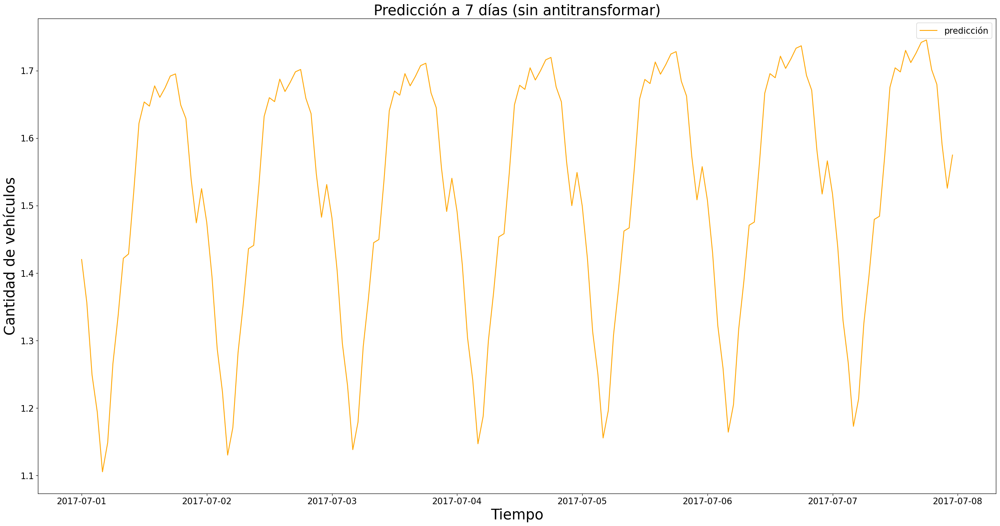

In [153]:
#Se grafica la predicción sin antitransformar a 7 días.
plt.plot(predictions,label='predicción',color='orange')
plt.title("Predicción a 7 días (sin antitransformar)")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

In [156]:
# Se antitrasforma la predicción.
# Se suma la tendencia determinística de 168 horas (semanal).
predictions_with_est_168=predictions+betas_168
# Se aplica la inversa de box_cox.
predictions_original=inv_boxcox(predictions_with_est_168, dataset_trasform_bc[1])
predictions_original

2017-07-01 00:00:00     72.361874
2017-07-01 01:00:00     61.998606
2017-07-01 02:00:00     51.378943
2017-07-01 03:00:00     43.467802
2017-07-01 04:00:00     36.729923
                          ...    
2017-07-07 19:00:00    103.152455
2017-07-07 20:00:00     99.596686
2017-07-07 21:00:00     91.717166
2017-07-07 22:00:00     85.505274
2017-07-07 23:00:00     82.907613
Freq: H, Name: predicted_mean, Length: 168, dtype: float64

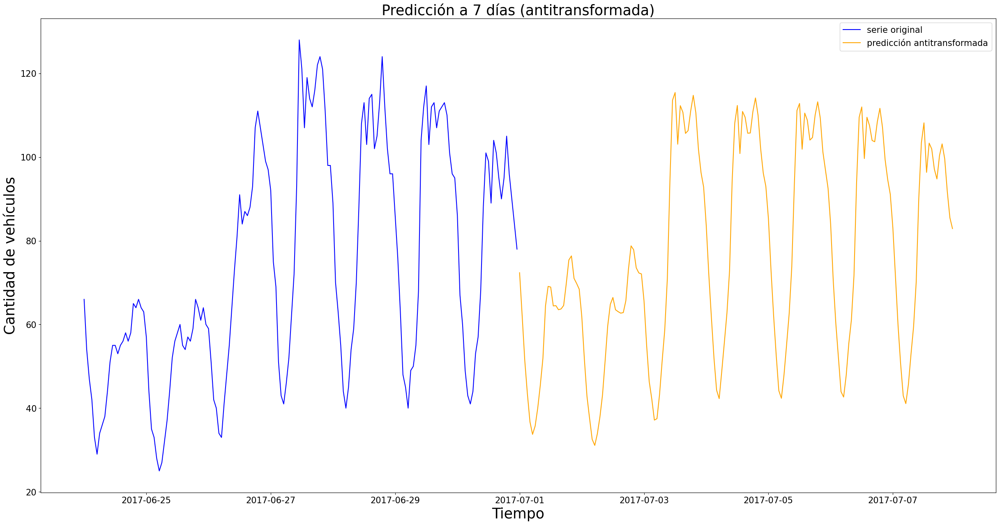

In [157]:
#Se grafica la predicción antitransformada 7 días en conjunto con la serie original.
cant_real=len(dataset_Junction1)-168
plt.plot(dataset_Junction1[cant_real:],label='serie original',color='blue')
plt.plot(predictions_original,label='predicción antitransformada',color='orange')
plt.title("Predicción a 7 días (antitransformada)")
plt.legend()
plt.xlabel("Tiempo")
plt.ylabel("Cantidad de vehículos")
plt.show()

#### Análisis de los resultados

La predicción sigue un comportamiento a 24 horas, tal como se esperaba. También se puede visualizar la tendencia semanal, en donde sábados y domingos tiene un tráfico menor. Incluso, se ve como va decayendo de lunes a viernes el tráfico, tal como mostraba la función de descomposición casi al inicio de este trabajo. Por último, enlaza perfectamente bien con los datos de la serie temporal original.